# 1. Obróbka danych (Data processing)

In [4]:
import pandas as pd
pd.options.mode.chained_assignment = None 
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
#styling figures
plt.rc('font',size=14)
sns.set(style='white')
sns.set(style='whitegrid',color_codes=True)

In [5]:
#najpierw usuwam niepotrzebne wiersze na początku i końcu pliku (w notatniku)
data_all=pd.read_csv('Loan_data.csv')

/opt/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3146: DtypeWarning: Columns (0,49) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [399]:
data_all.head()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,hardship_payoff_balance_amount,hardship_last_payment_amount,disbursement_method,debt_settlement_flag,debt_settlement_flag_date,settlement_status,settlement_date,settlement_amount,settlement_percentage,settlement_term
0,1077501,NaN,5000.0,5000.0,4975.0,36 months,10.65%,162.87,B,B2,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
1,1077430,NaN,2500.0,2500.0,2500.0,60 months,15.27%,59.83,C,C4,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
2,1077175,NaN,2400.0,2400.0,2400.0,36 months,15.96%,84.33,C,C5,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
3,1076863,NaN,10000.0,10000.0,10000.0,36 months,13.49%,339.31,C,C1,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
4,1075358,NaN,3000.0,3000.0,3000.0,60 months,12.69%,67.79,B,B5,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN


In [7]:
data_all.shape

(42536, 151)

In [8]:
data_all.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42536 entries, 0 to 42535
Columns: 151 entries, id to settlement_term
dtypes: float64(120), object(31)
memory usage: 49.0+ MB


In [9]:
data_all.isnull().sum().sum()

3867083

In [10]:
#usuwam kolumny, w których wszystkie wartości to NaN
data=data_all.dropna(axis=1, how='all') 

In [11]:
data.shape

(42536, 69)

In [12]:
#usuwam wiersze, w których wszystkie wartości to NaN
data=data.dropna(axis=0, how='all')

In [13]:
data.shape
#liczba wierszy nie zmieniła się, czyli brak całkowicie pustych wierszy

(42536, 69)

In [14]:
#zostawiam tylko te kolumny, dla których przynajmniej połowa wartości jest wypełniona
data=data.dropna(axis=1, how='all', thresh=42376/2)

In [15]:
data.shape

(42536, 60)

In [16]:
#usuwam te kolumny, które mają taką samą wartość dla każdej komórki - nie wnoszą informacji o zmienności
nunique = data.apply(pd.Series.nunique)
c_to_drop = nunique[nunique == 1].index
data=data.drop(c_to_drop, axis=1)

In [17]:
data.shape

(42536, 50)

In [18]:
#analizuję, jakie kolumny zostały i jakie mają typy danych
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 42536 entries, 0 to 42535
Data columns (total 50 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       42536 non-null  object 
 1   loan_amnt                42535 non-null  float64
 2   funded_amnt              42535 non-null  float64
 3   funded_amnt_inv          42535 non-null  float64
 4   term                     42535 non-null  object 
 5   int_rate                 42535 non-null  object 
 6   installment              42535 non-null  float64
 7   grade                    42535 non-null  object 
 8   sub_grade                42535 non-null  object 
 9   emp_title                39909 non-null  object 
 10  emp_length               41423 non-null  object 
 11  home_ownership           42535 non-null  object 
 12  annual_inc               42531 non-null  float64
 13  verification_status      42535 non-null  object 
 14  issue_d               

In [19]:
data.isna().sum()

id                             0
loan_amnt                      1
funded_amnt                    1
funded_amnt_inv                1
term                           1
int_rate                       1
installment                    1
grade                          1
sub_grade                      1
emp_title                   2627
emp_length                  1113
home_ownership                 1
annual_inc                     5
verification_status            1
issue_d                        1
loan_status                    1
url                            1
desc                       13294
purpose                        1
title                         14
zip_code                       1
addr_state                     1
dti                            1
delinq_2yrs                   30
earliest_cr_line              30
fico_range_low                 1
fico_range_high                1
inq_last_6mths                30
open_acc                      30
pub_rec                       30
revol_bal 

In [20]:
#widzę, że jest wiele kolumn, w których 1 wartość to NaN, podejrzewam, że chodzi o ten sam wiersz, dlatego sprawdzam,
#jak on wygląda
data[data.loan_amnt.isna()]

,id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,...,last_pymnt_d,last_pymnt_amnt,last_credit_pull_d,last_fico_range_high,last_fico_range_low,acc_now_delinq,delinq_amnt,pub_rec_bankruptcies,tax_liens,debt_settlement_flag
39786,Loans that do not meet the credit policy,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [21]:
#usuwam zatem wiersz 39786, w którym nie ma żadnych istotnych wartości
data=data.drop([39786])

In [22]:
data[data.earliest_cr_line.isna()]
#dochodzę do wniosku, że widoczne 29xNaN w earliest_cr_line oznacza również NaN w innych komórkach. A zatem zamiast 
#w każdej zastanawiać się, czym je najlepiej uzupełnić, to usuwam te 29 wierszy, bo przy liczbie rekordów ponad 42tys.,
#to nie będzie duża strata, a zaoszczędzi mi sporo pracy przy uzupełnianiu NaN w innych kolumnach 
#(które nie wiadomo na ile wiarygodnie bym uzupełniła)

,id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,...,last_pymnt_d,last_pymnt_amnt,last_credit_pull_d,last_fico_range_high,last_fico_range_low,acc_now_delinq,delinq_amnt,pub_rec_bankruptcies,tax_liens,debt_settlement_flag
42450,79967,5000.0,5000.0,3025.0,36 months,7.43%,155.38,A,A2,NaN,...,Aug-2010,157.31,May-2007,804.0,800.0,NaN,NaN,NaN,NaN,N
42451,79924,7000.0,7000.0,3450.0,36 months,7.75%,218.55,A,A3,NaN,...,Aug-2010,220.03,May-2007,804.0,800.0,NaN,NaN,NaN,NaN,N
42460,71823,4350.0,4350.0,825.0,36 months,8.07%,136.45,A,A4,NaN,...,Aug-2010,139.93,NaN,0.0,0.0,NaN,NaN,NaN,NaN,N
42473,72197,3900.0,3900.0,2025.0,36 months,9.33%,124.62,B,B3,NaN,...,Aug-2010,126.06,May-2007,709.0,705.0,NaN,NaN,NaN,NaN,N
42481,79893,6700.0,6700.0,6700.0,36 months,7.75%,209.18,A,A3,NaN,...,Jul-2010,209.89,May-2007,804.0,800.0,NaN,NaN,NaN,NaN,N
42484,73003,3200.0,3200.0,2000.0,36 months,9.96%,103.20,B,B5,NaN,...,Feb-2009,1733.32,Aug-2018,694.0,690.0,NaN,NaN,NaN,NaN,N
42495,72819,7200.0,5075.0,350.0,36 months,10.28%,164.42,C,C1,NaN,...,Jul-2010,168.44,May-2007,704.0,700.0,NaN,NaN,NaN,NaN,N
42510,91023,1900.0,1900.0,900.0,36 months,9.64%,61.00,B,B4,Scheduall,...,Feb-2008,0.00,May-2007,709.0,705.0,NaN,NaN,NaN,NaN,N
42515,85961,1200.0,1200.0,500.0,36 months,9.01%,38.17,B,B2,Classic Components,...,Jul-2010,39.05,Aug-2018,659.0,655.0,NaN,NaN,NaN,NaN,N
42516,85818,5000.0,5000.0,375.0,36 months,11.22%,164.23,C,C4,Compensation Solutions,...,Apr-2010,149.43,Jan-2017,614.0,610.0,NaN,NaN,NaN,NaN,N


In [23]:
data=data.dropna(subset=['earliest_cr_line'])

In [24]:
data.shape

(42506, 50)

In [25]:
data.isna().sum()
#faktycznie poprzez usunięcie wspomnianych wierszy zostały wyeliminowane wartości NaN w wielu kolumnach

id                             0
loan_amnt                      0
funded_amnt                    0
funded_amnt_inv                0
term                           0
int_rate                       0
installment                    0
grade                          0
sub_grade                      0
emp_title                   2614
emp_length                  1112
home_ownership                 0
annual_inc                     0
verification_status            0
issue_d                        0
loan_status                    0
url                            0
desc                       13292
purpose                        0
title                         13
zip_code                       0
addr_state                     0
dti                            0
delinq_2yrs                    0
earliest_cr_line               0
fico_range_low                 0
fico_range_high                0
inq_last_6mths                 0
open_acc                       0
pub_rec                        0
revol_bal 

In [26]:
#analizując po kolei pozostałe dane, czyli wartości i typy zmiennych w każdej kolumnie (głównie z użyciem 
#.value_counts() oraz .unique() ) dzielę sobie kolumny na kilka grup - zgodnie z moją intuicją : 

#-do usunięcia ze względu na nieistotne informacje w kontekście badanego problemu (np. id, url),

#-do usunięcia ze względu na wartości, z których ciężko będzie wyciągnąć istotne informacje lub zamienić na zmienne
#numeryczne (np.emp_title,zip_code) lub dublują informacje zawarte w innych komórkach (title- podobne dane do purpose)

#-Przy okazji analizy kolumn związanych z wynikiem FICO score zauważam także, że ten dataset zawiera kolumny,
#które są uzupełnianie również już po udzieleniu pożyczki oraz w trakcie jej spłacania. To ciekawe dane do 
#eksploracji, ale z punktu widzenia zadania, są nieużyteczne, bo tych danych nie będziemy mieć w momencie oceny 
#potencjalnego pożyczkobiorcy. Jeśli więc uczylibyśmy na nich model, to byłoby mylące, bo potem on nie miałby ich w 
#prawdziwym datasecie do oceny. A zatem typuję te kolumny do usunięcia: 
#funded_amnt, funded_amnt_inv, last_pymnt_d, last_credit_pull_d, out_prncp, out_prncp_inv, total_pymnt, total_pymnt_inv,
#total_rec_prncp, total_rec_int, total_rec_late_fee, recoveries, collection_recovery_fee, debt_settlement_flag

#-do zamiany typu z object na np. typ date lub int lub float

#-do zamiany ze zmiennych kategorycznych na numeryczne

to_drop = ['id','emp_title','url','title','zip_code', 'last_pymnt_d', 'last_credit_pull_d',
           'total_rec_prncp','total_rec_int', 'funded_amnt', 'funded_amnt_inv','total_pymnt', 'total_pymnt_inv',
           'total_rec_late_fee','recoveries', 'collection_recovery_fee','last_pymnt_amnt', 'debt_settlement_flag']
data = data.drop(to_drop, axis=1)

In [27]:
data.shape

(42506, 32)

In [28]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 42506 entries, 0 to 42514
Data columns (total 32 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   loan_amnt             42506 non-null  float64
 1   term                  42506 non-null  object 
 2   int_rate              42506 non-null  object 
 3   installment           42506 non-null  float64
 4   grade                 42506 non-null  object 
 5   sub_grade             42506 non-null  object 
 6   emp_length            41394 non-null  object 
 7   home_ownership        42506 non-null  object 
 8   annual_inc            42506 non-null  float64
 9   verification_status   42506 non-null  object 
 10  issue_d               42506 non-null  object 
 11  loan_status           42506 non-null  object 
 12  desc                  29214 non-null  object 
 13  purpose               42506 non-null  object 
 14  addr_state            42506 non-null  object 
 15  dti                

In [29]:
#teraz zajmuję się poszczególnymi kolumnami - zmianą typu i/lub uzupełnieniem NaN

In [30]:
data['term']=data['term'].replace('\ months', '', regex=True)

In [31]:
data['int_rate'] = data['int_rate'].replace('\%', '', regex=True).astype(float)

In [32]:
#w długości zatrudnienia usuwam 'month', 10+ zamieniam na 10, a <1 na 1, naan uzupełniam 0- uznaję za brak zatrudnienia
data['emp_length'].unique()
data['emp_length'].fillna(0, inplace=True)

In [33]:
map_length = {"10+ years": 10, "9 years": 9, "8 years": 8, "7 years": 7, "6 years": 6, "5 years": 5, "4 years": 4, 
              "3 years": 3, "2 years": 2, "1 year": 1, "< 1 year": 1}
data['emp_length'] = data['emp_length'].replace(map_length)
data[['emp_length']]

,emp_length
0,10
1,1
2,10
3,10
4,1
...,...
42509,1
42511,1
42512,7
42513,1


In [35]:
#annual_inc ma tylko 4 puste wartości, więc uzupełniam średnią z tej kolumny
data.annual_inc.fillna(data.annual_inc.mean(), inplace=True)
#sprawdzam, czy zostały uzupełnione prawidłowo
data.annual_inc.isna().sum()

0

In [36]:
data['issue_d'] = pd.to_datetime(data['issue_d'])

In [37]:
data['issue_d']

0       2011-12-01
1       2011-12-01
2       2011-12-01
3       2011-12-01
4       2011-12-01
           ...    
42509   2007-07-01
42511   2007-07-01
42512   2007-07-01
42513   2007-06-01
42514   2007-06-01
Name: issue_d, Length: 42506, dtype: datetime64[ns]

In [39]:
#badam zmienną 'loan_status', która jest w tym przypadku targetem
data['loan_status'].unique()

array(['Fully Paid', 'Charged Off',
       'Does not meet the credit policy. Status:Fully Paid',
       'Does not meet the credit policy. Status:Charged Off'],
      dtype=object)

In [40]:
data["loan_status"].value_counts()

Fully Paid                                             34116
Charged Off                                             5670
Does not meet the credit policy. Status:Fully Paid      1962
Does not meet the credit policy. Status:Charged Off      758
Name: loan_status, dtype: int64

In [41]:
#zamianiam target na 0 i 1
map_loan_status = {"loan_status":{ "Fully Paid": 1, "Does not meet the credit policy. Status:Fully Paid": 1, "Charged Off": 0, "Does not meet the credit policy. Status:Charged Off": 0}}
data = data.replace(map_loan_status)

In [42]:
#data6['desc'] - podzielimy opis na 3 kategorie - brak, długi i krótki - zobaczymy, czy jak ktoś długo opisuje,
#to bardziej mu zależy i częściej spłaca, a może to nie ma znaczenia ?
data['desc'].value_counts()

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                            225
Debt Consolidation                                                                                                                                                                      

In [43]:
data['desc']=data['desc'].str.len()

In [44]:
data['desc'].fillna(0, inplace=True)

<AxesSubplot:>

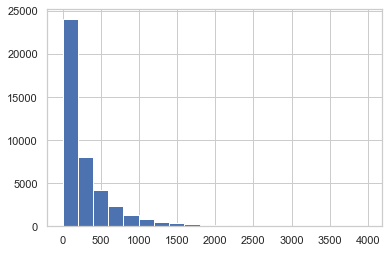

In [45]:
data['desc'].hist(bins=20)

In [46]:
#ustalam, że 20% najdłuższego opisu to będzie próg dla rozgraniczenia między opisem długim, a krótkim
treshold=data['desc'].max()/5
print(treshold)

797.6


In [47]:
conditions = [
    (data['desc'] == 0),
    (data['desc'] >0) & (data['desc'] <= 800),
    (data['desc'] >800)]

values = [0,1,2]

#uzupełniam nowymi wartościami
data['desc']= np.select(conditions, values)

In [48]:
data['desc'].value_counts()

1    25340
0    13292
2     3874
Name: desc, dtype: int64

In [49]:
#delinq_2yrs uzupełniam zerami, ponieważ znaczna większość to wartość 0.0 
data.delinq_2yrs.value_counts()
data.delinq_2yrs.fillna(0.0, inplace=True)
data.delinq_2yrs.isna().sum()

0

In [50]:
data['earliest_cr_line'] = pd.to_datetime(data['earliest_cr_line'])

In [51]:
data['revol_util'] = data['revol_util'].replace('\%', '', regex=True).astype(float)

<AxesSubplot:>

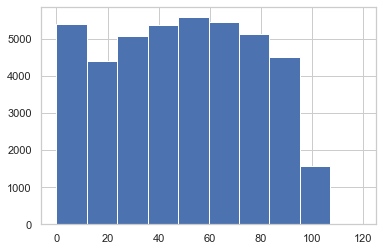

In [52]:
data['revol_util'].hist()

In [53]:
data['revol_util'].fillna(data['revol_util'].mean(), inplace=True)

<AxesSubplot:>

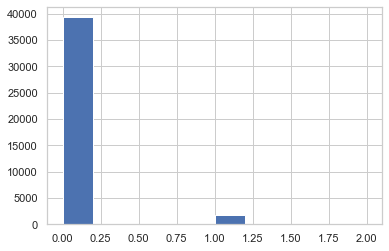

In [54]:
data.pub_rec_bankruptcies.hist()

In [55]:
data['pub_rec_bankruptcies'].fillna(0.0, inplace=True)

<AxesSubplot:>

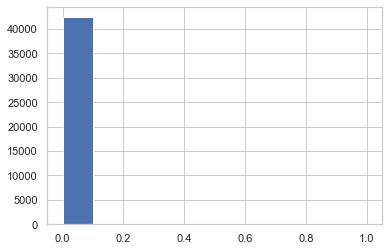

In [56]:
data.tax_liens.hist()

In [57]:
data['tax_liens'].fillna(0.0, inplace=True)

In [58]:
#usuwam last_fico_range- ponieważ wg opisu one są aktualizowane po udzieleniu pożyczki
data=data.drop(['last_fico_range_high','last_fico_range_low'], axis=1)

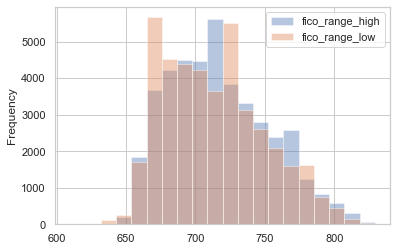

In [59]:
data[['fico_range_high','fico_range_low']].plot.hist(alpha=0.4,bins=20);

In [60]:
#rozważam przyjęcie jako zmiennej fico_range_low - bardziej ostrożnie, ale ponieważ to zakres- nie dokładna wartość, to postanawiam
#przyjąć średnią z podanego zakresu - żeby uwzględnić w jednej kolumnie informacje z obu dostępnych kolumn
data['fico_mean'] = (data['fico_range_low'] + data['fico_range_high'])/2

In [61]:
data[['fico_mean','fico_range_low','fico_range_high']]

,fico_mean,fico_range_low,fico_range_high
0,737.0,735.0,739.0
1,742.0,740.0,744.0
2,737.0,735.0,739.0
3,692.0,690.0,694.0
4,697.0,695.0,699.0
...,...,...,...
42509,662.0,660.0,664.0
42511,652.0,650.0,654.0
42512,802.0,800.0,804.0
42513,697.0,695.0,699.0


In [62]:
#usuwam kolumny, aby nie mnożyć bytów ponad potrzebę
data=data.drop(['fico_range_high','fico_range_low'], axis=1)

In [63]:
#Sprawdzam teraz, czy zostały jakieś puste wartości --> same zera, więc jesteśmy w domu
data.isna().sum()

loan_amnt               0
term                    0
int_rate                0
installment             0
grade                   0
sub_grade               0
emp_length              0
home_ownership          0
annual_inc              0
verification_status     0
issue_d                 0
loan_status             0
desc                    0
purpose                 0
addr_state              0
dti                     0
delinq_2yrs             0
earliest_cr_line        0
inq_last_6mths          0
open_acc                0
pub_rec                 0
revol_bal               0
revol_util              0
total_acc               0
acc_now_delinq          0
delinq_amnt             0
pub_rec_bankruptcies    0
tax_liens               0
fico_mean               0
dtype: int64

In [64]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 42506 entries, 0 to 42514
Data columns (total 29 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   loan_amnt             42506 non-null  float64       
 1   term                  42506 non-null  object        
 2   int_rate              42506 non-null  float64       
 3   installment           42506 non-null  float64       
 4   grade                 42506 non-null  object        
 5   sub_grade             42506 non-null  object        
 6   emp_length            42506 non-null  int64         
 7   home_ownership        42506 non-null  object        
 8   annual_inc            42506 non-null  float64       
 9   verification_status   42506 non-null  object        
 10  issue_d               42506 non-null  datetime64[ns]
 11  loan_status           42506 non-null  int64         
 12  desc                  42506 non-null  int64         
 13  purpose         

In [65]:
#W projekcie będę potrzebowała kolumny 'wiek kredytowy' - uznaję, że jest to "issue_d - earliest_cr_line" 
#i dodaję taką kolumnę
data['credit_time']=data['issue_d'].sub(data['earliest_cr_line'],axis=0).dt.days

<AxesSubplot:>

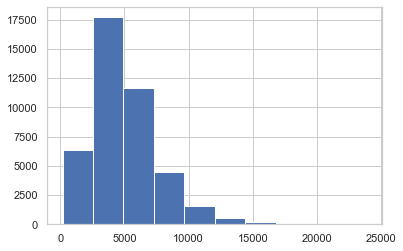

In [66]:
data['credit_time'].hist()

In [68]:
#wyodrębniam też sam rok oraz sam miesiąc wzięcia pożyczki, bo mogą być ciekawe do analizy
data['issue_year']=data['issue_d'].dt.year
data['issue_month']=data['issue_d'].dt.month

In [69]:
data.shape

(42506, 32)

In [70]:
#uznaję, że do eksploracji warto zostawić takie zmienne jak grade, sub_grade, purpose,home_ownership, verification_status, addr_state 
#- jako kategoryczne, żeby łatwiej zrobić wykresy. Zapisuję więc taką wersję danych do eksploracji - 32 kolumny,
#zanim zakoduję w/w zmienne i rozbiję na poszczególne kolumny
data.to_csv("Loan_data_for_EDA.csv",index=False)
data_eda=data

In [79]:
data_eda.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 42506 entries, 0 to 42514
Data columns (total 32 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   loan_amnt             42506 non-null  float64       
 1   term                  42506 non-null  object        
 2   int_rate              42506 non-null  float64       
 3   installment           42506 non-null  float64       
 4   grade                 42506 non-null  object        
 5   sub_grade             42506 non-null  object        
 6   emp_length            42506 non-null  int64         
 7   home_ownership        42506 non-null  object        
 8   annual_inc            42506 non-null  float64       
 9   verification_status   42506 non-null  object        
 10  issue_d               42506 non-null  datetime64[ns]
 11  loan_status           42506 non-null  int64         
 12  desc                  42506 non-null  int64         
 13  purpose         

In [71]:
#teraz koduję zmienne numeryczne
nominal_columns = ['home_ownership', 'verification_status', 'purpose', 'term','addr_state']
dummies = pd.get_dummies(data[nominal_columns])
data = pd.concat([data, dummies], axis=1)
data = data.drop(nominal_columns, axis=1)

In [83]:
from sklearn.preprocessing import LabelEncoder
labelencoder = LabelEncoder()
data['grade'] = labelencoder.fit_transform(data['grade'])
data['sub_grade'] = labelencoder.fit_transform(data['sub_grade'])

In [84]:
data[['sub_grade','grade']]

,sub_grade,grade
0,6,1
1,13,2
2,14,2
3,10,2
4,9,1
...,...,...
42509,19,3
42511,24,4
42512,0,0
42513,11,2


In [75]:
data.shape

(42506, 101)

In [76]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 42506 entries, 0 to 42514
Columns: 101 entries, loan_amnt to addr_state_WY
dtypes: datetime64[ns](2), float64(17), int64(8), uint8(74)
memory usage: 12.1 MB


In [77]:
#zapisuję teraz wersję danych z zakodowanymi zmiennymi kategorycznymi - 101 kolumn
data.to_csv("Loan_data_cleaned_processed.csv",index=False)

## Podsumowanie etapu czyszczenia i obróbki danych:

Wejściowy dataset zawierał 151 kolumn i 42536 wierszy. 120 kolumn miało typ float64, a 31 - typ object. Dane zajmowały 49 MB. Zawierały w sumie 3867083 pustych wartości. 

W wyniku czynności podjętych w ramach obróbki danych, opisanych wyżej w komentarzach, uzyskano dwa datasety bez żadnych pustych wartości: <br>
-pierwszy, data_eda, przeznaczony do eksploracyjnej analizy danych, zawierający 32 kolumny i 42506 wierszy, zajmujących 10.7 MB, w którym 17 kolumn miało typ float64, 6 - int64, 7 -object, a 2- datetime64. <br>
-drugi,data, powstały po zakodowaniu zmiennych kategorycznych (nominalnych i porządkowych), zawierający 101 kolumn i 42506 wierszy, zajmujących 12.1 MB, w którym 74 kolumny miały typ uint8, 17- float64, 8 - int64, a 2- datetime64. 

Zmienną objaśnianą w projekcie jest kolumna 'loan_status', która zgodnie ze swoim znaczeniem, została zakodowana jako binarna. 

# 2. Eksploracyjna analiza danych (EDA)

In [85]:
#zaczynam od określenia zmiennej objasnianej - targetu oraz zmiennych objaśniających
y = data['loan_status']

In [86]:
x = data.drop('loan_status', axis=1)

In [87]:
#wyodrębniam sobie też takie dwie grupy, co może się przydać do eksploracji
data_eda_paid = data_eda[data_eda['loan_status']==1]
data_eda_defaulted = data_eda[data_eda['loan_status']==0]

In [88]:
data_eda_paid.shape

(36078, 32)

In [89]:
data_eda_defaulted.shape

(6428, 32)

In [90]:
defaulted_percent=(data_eda_defaulted.shape[0]/data_eda.shape[0])*100
print (round(defaulted_percent,2))

15.12


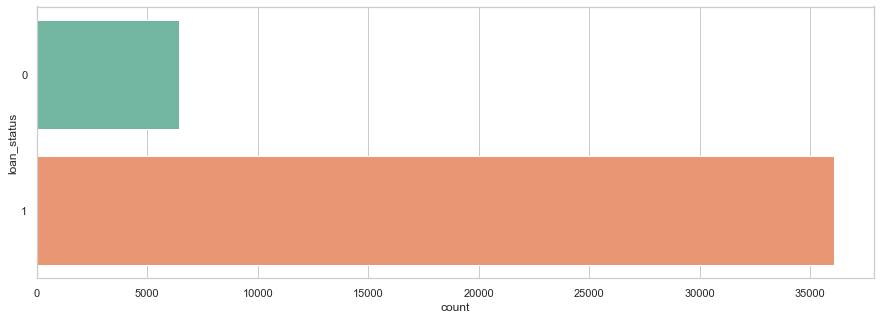

In [91]:
plt.figure(figsize=(15,5))
sns.countplot(y=y, data=x, palette=sns.color_palette('Set2'))
plt.show()

## Obserwacje odstające (Outliers detection)

<AxesSubplot:xlabel='credit_time'>

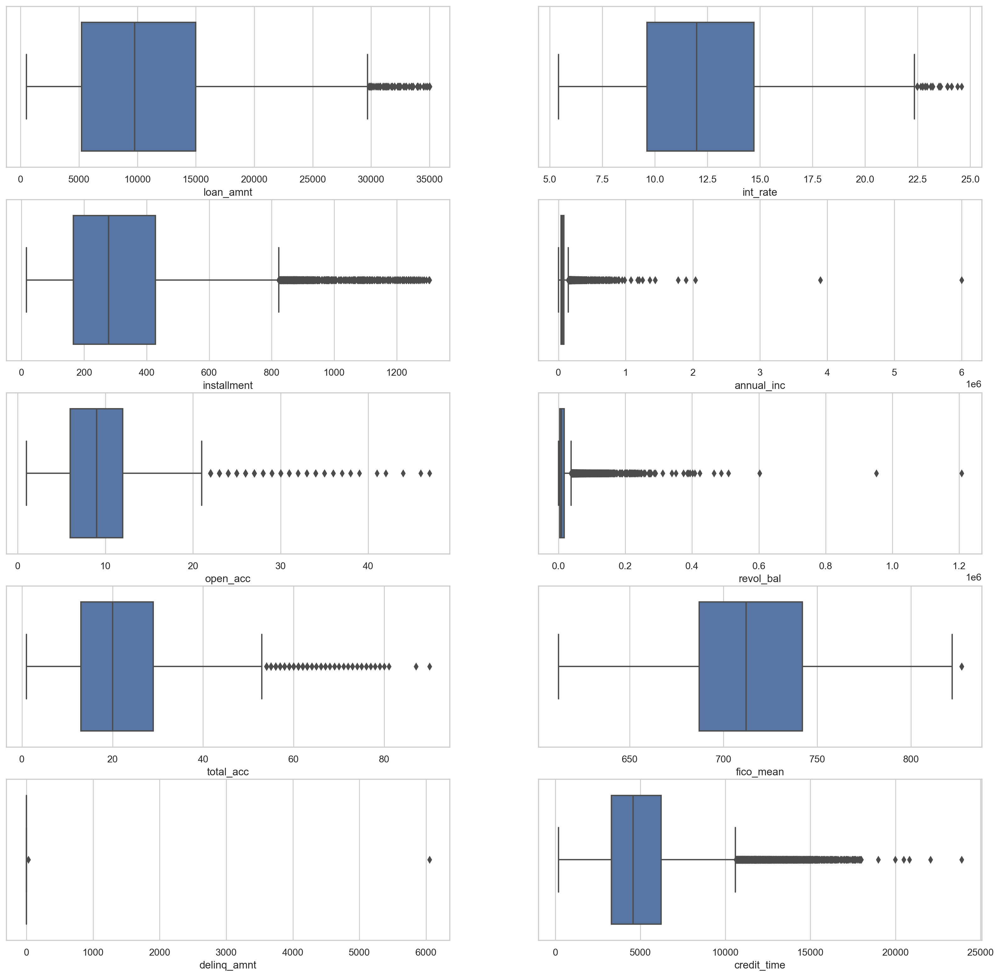

In [92]:
#rysuję boxploty dla (wybranych) zmiennych ciągłych, w celu detekcji outlierów 

plt.figure(figsize=(20,40), dpi=200)
plt.subplot(10,2,1)
sns.boxplot(x = 'loan_amnt', data = data_eda)

plt.subplot(10,2,2)
sns.boxplot(x = 'int_rate', data = data_eda)

plt.subplot(10,2,3)
sns.boxplot(x = 'installment', data = data_eda)

plt.subplot(10,2,4)
sns.boxplot(x = 'annual_inc', data = data_eda)

plt.subplot(10,2,5)
sns.boxplot(x = 'open_acc', data = data_eda)

plt.subplot(10,2,6)
sns.boxplot(x = 'revol_bal', data = data_eda)

plt.subplot(10,2,7)
sns.boxplot(x = 'total_acc', data = data_eda)

plt.subplot(10,2,8)
sns.boxplot(x = 'fico_mean', data = data_eda)

plt.subplot(10,2,9)
sns.boxplot(x = 'delinq_amnt', data = data_eda)

plt.subplot(10,2,10)
sns.boxplot(x = 'credit_time', data = data_eda)


In [93]:
#w celu usunięcia outlierów skorzystam z metody z-score
from scipy import stats
z = np.abs(stats.zscore(data_eda[['loan_amnt', 'int_rate', 'installment', 'annual_inc', 'open_acc',
       'revol_bal', 'total_acc', 'fico_mean', 'delinq_amnt', 'credit_time']]))
print(z)

print("\n")
print("*******************************************************************************")
print("\n")

# threshold = 3  # selecting 3 as the threshold to identify outliers
print('Ponizej sa punkty odstajace - nr indeksow i odpowiadające im indeksy kolumn w drugim wektorze')
print("\n")
print(np.where(z > 3))

[[0.82240351 0.40907308 0.76530925 ... 0.60680099 0.00487202 1.92232518]
 [1.15975135 0.83681722 1.25850825 ... 0.74499286 0.00487202 0.14556337]
 [1.17324526 1.02289175 1.14123946 ... 0.60680099 0.00487202 0.52114566]
 ...
 [1.22722092 1.36101957 1.24874382 ... 2.40329527 0.00487202 1.40247159]
 [0.68746437 0.42525347 0.6101794  ... 0.49873395 0.00487202 0.32759161]
 [0.90336699 0.68144304 0.86879296 ... 0.49873395 0.00487202 1.56125028]]


*******************************************************************************


Ponizej sa punkty odstajace - nr indeksow i odpowiadające im indeksy kolumn w drugim wektorze


(array([   31,    80,   128, ..., 42469, 42470, 42503]), array([2, 0, 0, ..., 4, 8, 5]))


In [94]:
data_eda_outliers_removed = data_eda[(z<3).all(axis=1)]

In [95]:
data_eda_outliers_removed.shape

(39601, 32)

<AxesSubplot:xlabel='credit_time'>

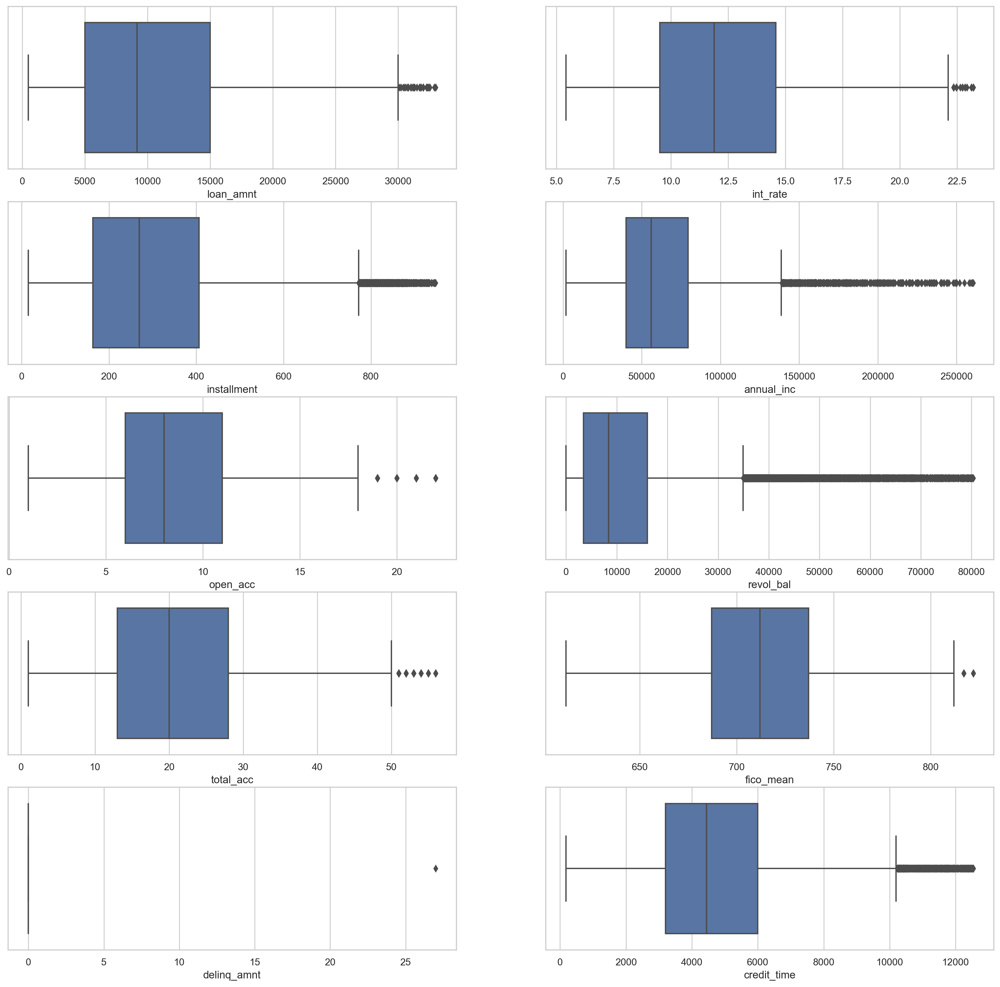

In [96]:
plt.figure(figsize=(20,40), dpi=200)
plt.subplot(10,2,1)
sns.boxplot(x = 'loan_amnt', data = data_eda_outliers_removed)

plt.subplot(10,2,2)
sns.boxplot(x = 'int_rate', data = data_eda_outliers_removed)

plt.subplot(10,2,3)
sns.boxplot(x = 'installment', data = data_eda_outliers_removed)

plt.subplot(10,2,4)
sns.boxplot(x = 'annual_inc', data = data_eda_outliers_removed)

plt.subplot(10,2,5)
sns.boxplot(x = 'open_acc', data = data_eda_outliers_removed)

plt.subplot(10,2,6)
sns.boxplot(x = 'revol_bal', data = data_eda_outliers_removed)

plt.subplot(10,2,7)
sns.boxplot(x = 'total_acc', data = data_eda_outliers_removed)

plt.subplot(10,2,8)
sns.boxplot(x = 'fico_mean', data = data_eda_outliers_removed)

plt.subplot(10,2,9)
sns.boxplot(x = 'delinq_amnt', data = data_eda_outliers_removed)

plt.subplot(10,2,10)
sns.boxplot(x = 'credit_time', data = data_eda_outliers_removed)


In [97]:
data_eda.columns

Index(['loan_amnt', 'term', 'int_rate', 'installment', 'grade', 'sub_grade',
       'emp_length', 'home_ownership', 'annual_inc', 'verification_status',
       'issue_d', 'loan_status', 'desc', 'purpose', 'addr_state', 'dti',
       'delinq_2yrs', 'earliest_cr_line', 'inq_last_6mths', 'open_acc',
       'pub_rec', 'revol_bal', 'revol_util', 'total_acc', 'acc_now_delinq',
       'delinq_amnt', 'pub_rec_bankruptcies', 'tax_liens', 'fico_mean',
       'credit_time', 'issue_year', 'issue_month'],
      dtype='object')

In [98]:
#jeszcze usunięcie w zbiorze z zakodowanymi zmiennymi
z1 = np.abs(stats.zscore(data[['loan_amnt', 'int_rate', 'installment', 'annual_inc', 'open_acc',
       'revol_bal', 'total_acc', 'fico_mean', 'delinq_amnt', 'credit_time']]))
data_outliers_removed = data[(z1<3).all(axis=1)]

In [99]:
data_outliers_removed.shape

(39601, 101)

In [100]:
target = data_eda_outliers_removed['loan_status']
x_eda = data_eda_outliers_removed.drop('loan_status',axis=1)  
x=data_outliers_removed.drop('loan_status',axis=1)  

In [101]:
data_eda_paid_outliers_removed = data_eda_outliers_removed[data_eda_outliers_removed['loan_status']==1]
data_eda_defaulted_outliers_removed = data_eda_outliers_removed[data_eda_outliers_removed['loan_status']==0]

In [102]:
defaulted_percent=(data_eda_defaulted_outliers_removed.shape[0]/data_eda_outliers_removed.shape[0])*100
print (round(defaulted_percent,2))

#po usunięciu outlierów zmienił się % osób niespłacających pożyczek z 15.12 na 14.94

14.96


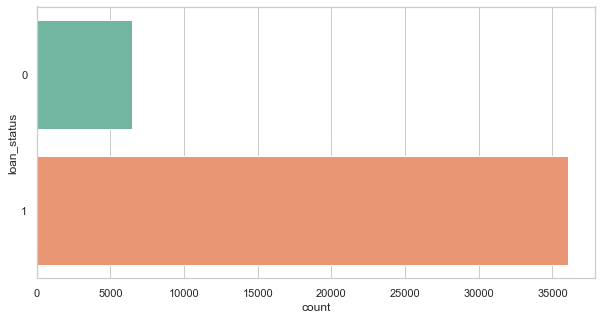

In [104]:
plt.figure(figsize=(10,5))
sns.countplot(y=y, data=x_eda, palette=sns.color_palette('Set2'))
plt.show()

## Analiza poszczególnych zmiennych (Charts for one variable)

In [91]:
#Wykresy - wybieram boxplot, distplot i violinplot dla zmiennych ciągłych, a barplot dla kategorycznych

In [106]:
# funkcja, która narysuje barplot i pokaże wskażnik niespłaconych pożyczek dla danej cechy
def print_barplot(f, figsize=(10,5),palette=sns.color_palette('Set2'),order=None):
    plt.figure(figsize=figsize)
    sns.barplot(x=f,y=1-target, data=data_eda_outliers_removed, palette=palette, order=order)
    plt.title("Loan Defaulters vs. "+str(f), fontsize=15)
    plt.xlabel(f, fontsize=15)
    plt.ylabel("defaulter ratio", fontsize=15)
    plt.show()

In [107]:
# funkcja, która narysuje 4 różne wykresy dla zmiennych ciągłych
def print_4plots(f, figsize=(25,20),palette=sns.color_palette('Set2')):
    fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(nrows=2, ncols=2, figsize=(15,10))
    #boxplot
    sns.boxplot(y=f, x ='loan_status', data=data_eda_outliers_removed , palette=palette, ax=ax1)
    ax1.set_xlabel(f, fontsize=15)
    ax1.set_title('Distribution of '+str(f) +'- boxplot', fontsize=15)
    ax1.tick_params(labelsize=15)
    
    #violinplot
    sns.violinplot(y=f, x ='loan_status', data=data_eda_outliers_removed , palette=palette,inner="quartile", ax=ax2)
    ax2.set_xlabel(f, fontsize=15)
    ax2.set_title('Distribution of '+str(f) +'- violinplot', fontsize=15)
    ax2.tick_params(labelsize=15)

    #distplot
    sns.distplot(data_eda_outliers_removed[f], color=palette[2], ax=ax3)
    ax3.set_xlabel(f, fontsize=15)
    ax3.set_ylabel(' ', fontsize=15)
    ax3.set_title('Distribution of '+str(f) +'- distplot', fontsize=15)
    ax3.tick_params(labelsize=15)

    #histogram
    sns.histplot(x=f, data=data_eda_outliers_removed ,hue='loan_status',element="step",kde=True, palette=palette[:2], ax=ax4)
    ax4.set_xlabel(f, fontsize=15)
    ax4.set_ylabel(' ', fontsize=15)
    ax4.set_title('Distribution of '+str(f) +'- histogram', fontsize=15)
    ax4.tick_params(labelsize=15)

    plt.subplots_adjust(wspace=0.75)
    plt.tight_layout()

In [108]:
#Na początek opiszemy zmienne ciągłe
data_eda_outliers_removed[['loan_amnt','int_rate','installment','annual_inc','dti','delinq_2yrs','revol_bal','revol_util','delinq_amnt','fico_mean','credit_time']].describe()

,loan_amnt,int_rate,installment,annual_inc,dti,delinq_2yrs,revol_bal,revol_util,delinq_amnt,fico_mean,credit_time
count,39601.000000,39601.000000,39601.000000,39601.000000,39601.000000,39601.000000,39601.000000,39601.000000,39601.000000,39601.000000,39601.000000
mean,10485.128532,12.055737,306.435273,63664.314406,13.319777,0.150577,11947.959951,49.147829,0.000682,714.542865,4783.597763
std,6619.561044,3.634978,188.463746,34598.130449,6.714523,0.506949,12383.592251,28.308579,0.135678,35.972557,2264.730458
min,500.000000,5.420000,15.670000,1896.000000,0.000000,0.000000,0.000000,0.000000,0.000000,612.000000,184.000000
25%,5000.000000,9.510000,162.870000,40000.000000,8.140000,0.000000,3444.000000,25.900000,0.000000,687.000000,3195.000000
50%,9175.000000,11.890000,269.480000,56000.000000,13.410000,0.000000,8359.000000,49.700000,0.000000,712.000000,4444.000000
75%,15000.000000,14.590000,406.450000,79500.000000,18.620000,0.000000,16044.000000,72.600000,0.000000,737.000000,5997.000000
max,33000.000000,23.220000,948.470000,260735.000000,29.990000,11.000000,80374.000000,119.000000,27.000000,822.000000,12541.000000


/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


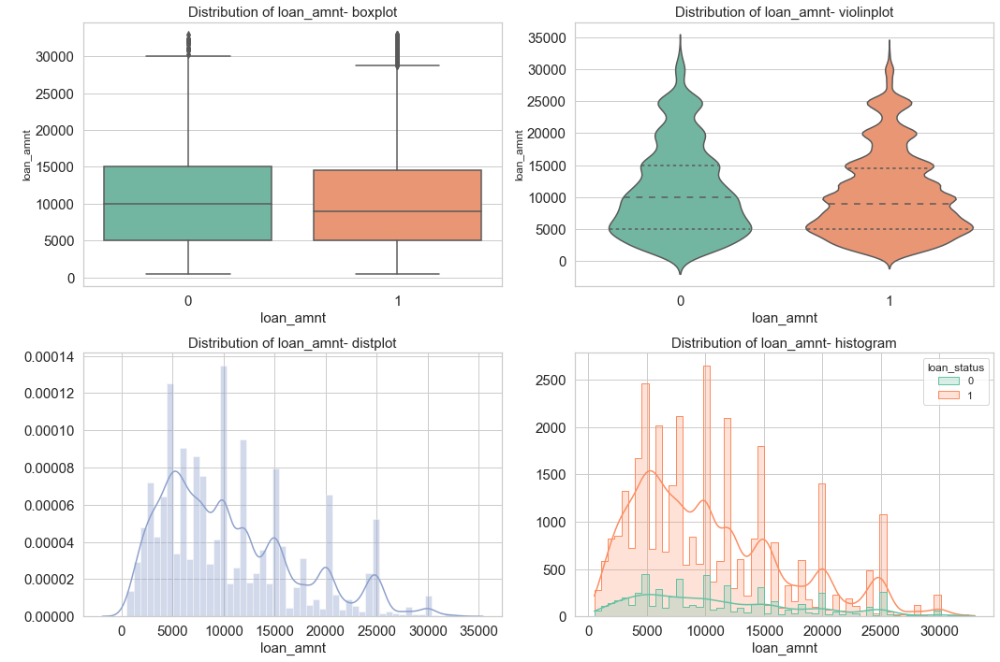

In [111]:
print_4plots('loan_amnt')

Obserwacje: średnia wielkość pożyczki jest wyższa wśród osób niespłacających pożyczki. Dominują kwoty między 5 a 10 tys., przy czym rozdkład dla osób niespłacających pożyczek ma ładogniejszy przebieg (brak wyraźnego "piku"). 

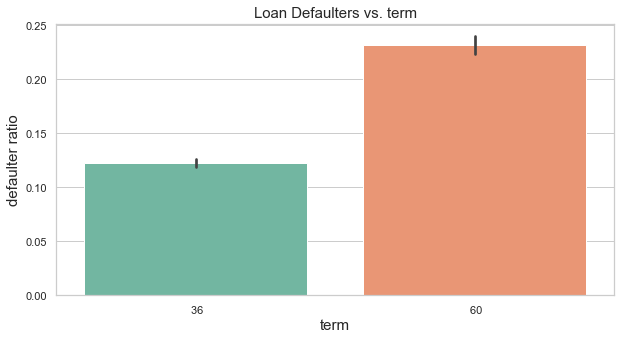

In [112]:
print_barplot("term")

Obserwacje: Odestek osób niespłacających pożyczki jest dużo mniejszy (ok 10%) dla pożyczkowbiorców biorących pożyczki na 3 lata w stosunku do osób biorących pożyczki na 5 lat. 

/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


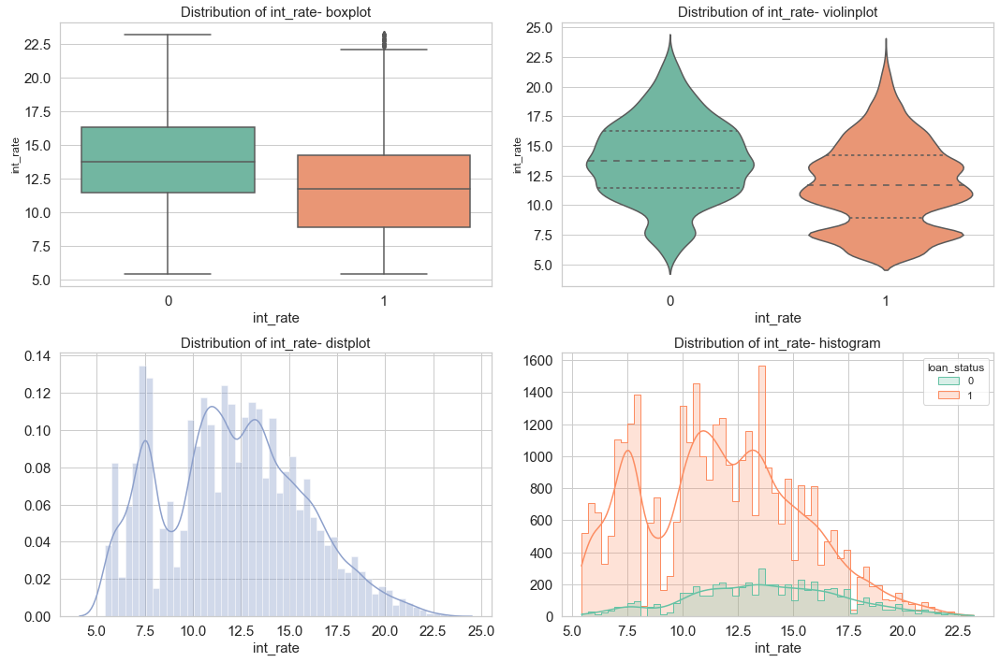

In [97]:
print_4plots('int_rate')

Obserwacje: Średni wskaźnik interest_rate jest wyraźnie wyższy dla osób niespłacających pożyczki. Można przypuszczać, że wskaźnik te jest tak liczony, by wytypować osoby podejrzewane o potencjalne niespłacenie pożyczek.

/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


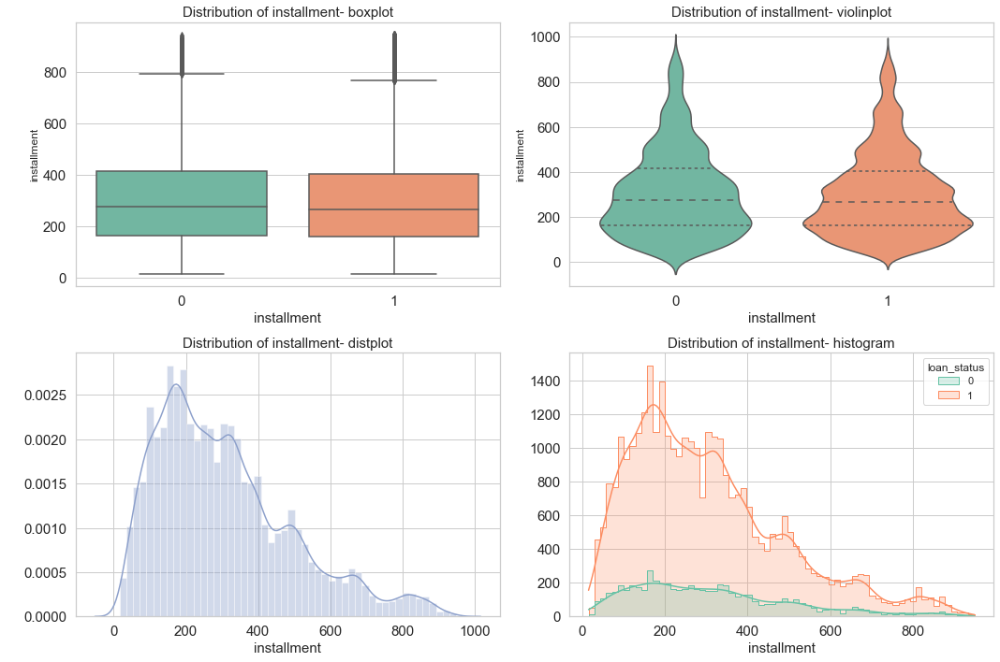

In [98]:
print_4plots('installment')

Obserwacje: Średnia miesięczna rata za pożyczkę nie różni się zbytnio dla osób spłacajacych i niespłacajacych pożyczki.

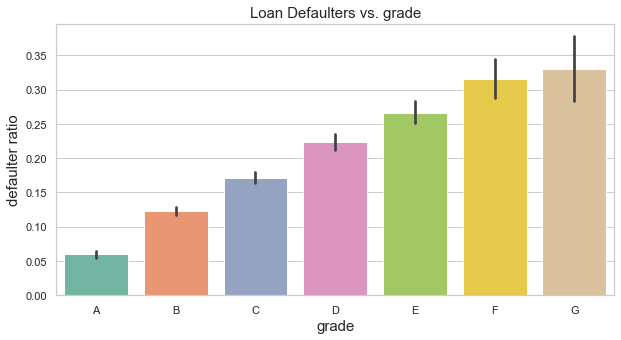

In [99]:
print_barplot('grade', order=["A", "B", 'C', 'D', 'E', 'F', 'G'])

Obserwacje: Widać wyraźną zależność miedzy oceną a odsetkiem osób niespłacających pożyczki - A wygląda na ocenę "najlepszą" , a G - na "najgorszą", tzn. A wiąże się z najmniejszym ryzykiem niespłacenia pożyczki, a G - z najmniejszym. Największe różnice w tym ryzyku widać między oceną A i B, a najmniejsze - między F i G. 

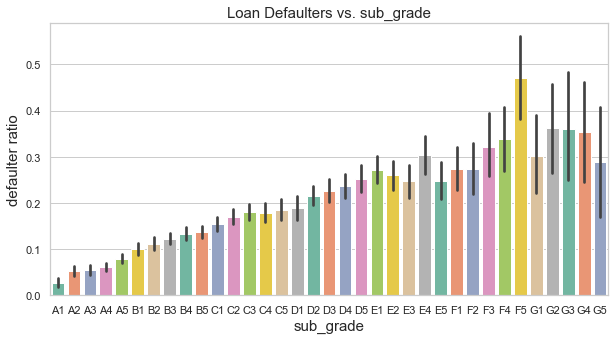

In [114]:
print_barplot('sub_grade', order=['A1','A2','A3','A4','A5','B1','B2','B3','B4','B5', 'C1','C2','C3','C4','C5', 'D1','D2','D3','D4','D5','E1','E2','E3','E4','E5', 'F1','F2','F3','F4','F5', 'G1','G2','G3','G4','G5'])


Obserwacje: Widać liniową zależność między oceną 'Subgrade', a odsetkiem osób niespłacających pożyczki, przy czym zalezność ta jest w przybliżeniu liniowa tylko do oceny D włącznie. Przy E, F i G widać odstępstwa od tej tendencji, co jest zbieżne z obserwacjami dotyczącymi oceny 'grade'.

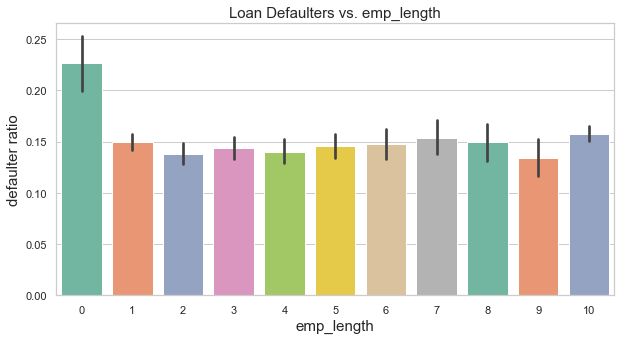

In [101]:
print_barplot('emp_length')

Obserwacje: Widać wyraźną różnicę między ryzykiem niespłacenia pożyczki dla osób bez zatrudnienia (emp_length =0) a dla osób posiadającyh jakiś staż pracy (emp_length >0), a jeśli chodzi o długość pracy w latach, to nie ma tu widocznej wyrażnej zależności - różnice między grupami nie wyglądają na istotne. 

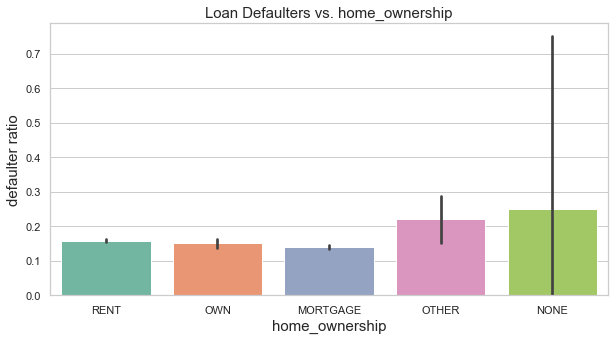

In [102]:
print_barplot('home_ownership')

Obserwacje: Nie ma wyraźnych różnic między wynajmującymi mieszkanie/dom, posiadajacymi na własność lub pod hiopteką - przy czym osoby posiadające hipotekę charakteryzują się najmniejszym ryzykiem niespąłcenia pożyczki - ale nie jest to wyrażna różnica względem innych grup. Wyraźnie wyższe ryzyko istnieje dla grup sklasyfikowanych jako "Other" lub "None", ale trudno tu zganąć jaki dokładnie status kryje się pod takimi ogólnymi określeniami. 

/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


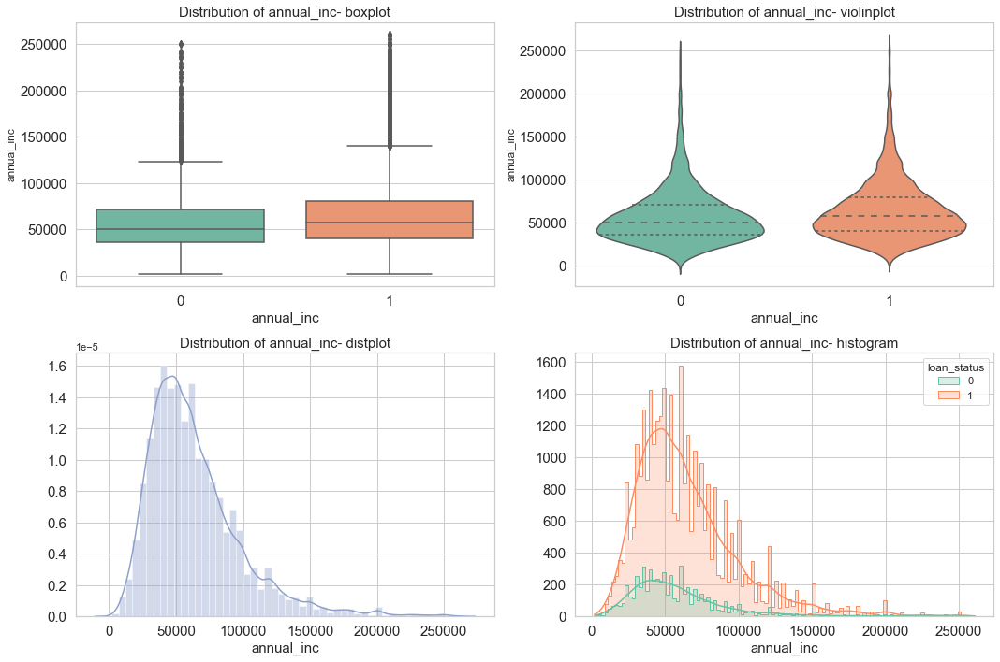

In [103]:
print_4plots('annual_inc')

Obserwacje: Średni roczny przychód u osób spłacających pożyczki jest wyższy, niż wśród osób niespłacających, rozkałdy w obu grupach są podobne. 

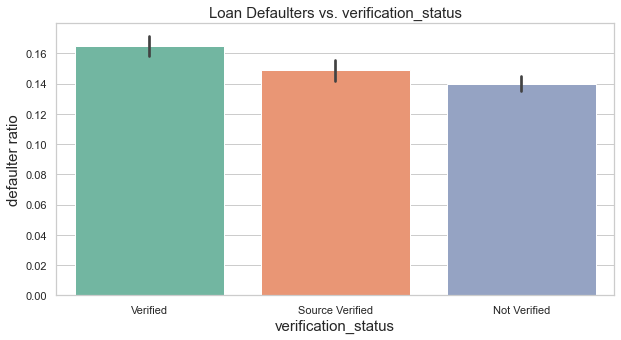

In [115]:
print_barplot('verification_status')

Obserwacje: Osoby ze zweryfikowanym przychodem lub zweryfikowanym źródłem przychodu posiadają większe ryzyko niespłacenia pożyczki, niż osoby z niezweryfikowanym przychodem, przy czym różnice są niewielkie. Jest to trochę sprzeczne z intuicją. Być może jest tak, że osoby, które nie były weryfikowane, to takie, które były na tyle "wiarygodne", że informacje prze nich podane nie musiały być poddawane weryfikaji - w takim przydaku wyjaśniałoby to zaobserwowaną tendencję.

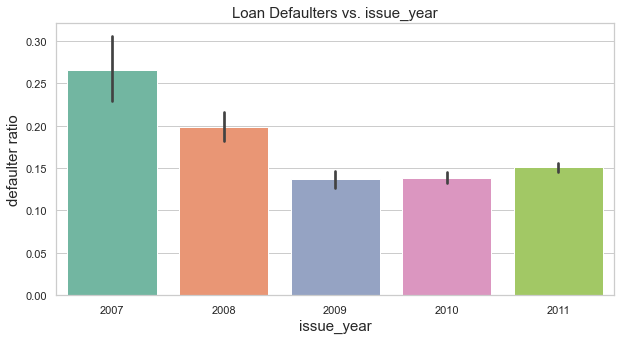

In [116]:
print_barplot('issue_year')

Obserwacje: Widać wyraźne różnice między ryzykiem niespłacenia pożyczki w różnych latach (im wcześniej był skąłdany wnioske, tym większe ryzyko), ale zależność nie jest liniowa - wygląda raczej na wykładniczą. Różnice między latami 2009-2010-2011 są pomijalnie małe. 

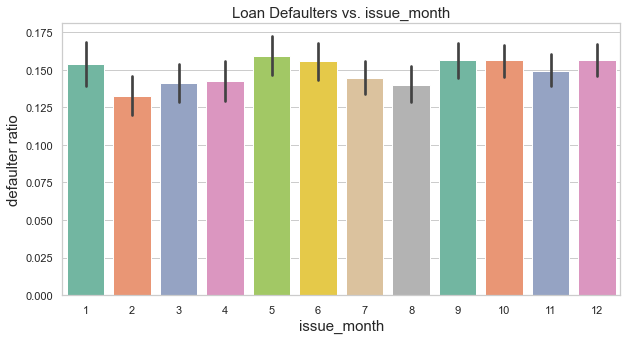

In [117]:
print_barplot('issue_month')

Obserwacje: Widać niewielką "sezonowość" jeśli chodzi o ryzyko niespłacenia pożyczki. Może to wynikać z różnych celów na jakie brane są pożyczki w różnych miesiącach , a od celu też w pewnym stopniu zależy ryzyko niespałcenia. Ale być może przyczyna jest zupełnie inna.Różnice nie są aż tak duże, by można było na tej podstawie być pewnym jakiejś zależności.  

<AxesSubplot:xlabel='issue_d', ylabel='loan_status'>

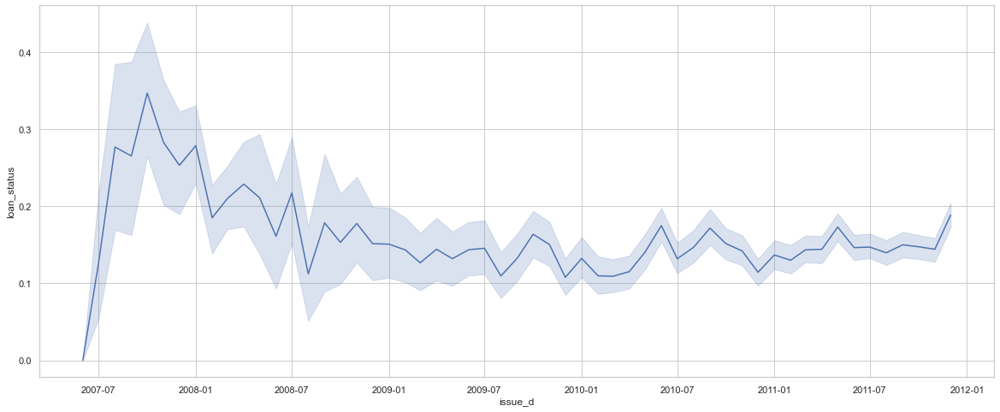

In [107]:
plt.figure(figsize=(20,8))
sns.lineplot(data=data_eda_outliers_removed, x=data_eda_outliers_removed['issue_d'], y=1-target)

Obserwacje: Widać, że na przestrzeni lat zmalało ogólnie ryzyko niespłącenia pożyczki, co pozostaje w zgodzie w obserwacjami dla poszczególnych lat widocznymi na wykresie wyżej. 

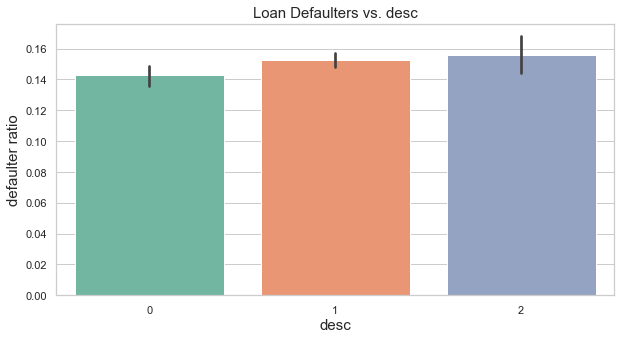

In [108]:
print_barplot('desc')

Obserwacje: Widać niewielką różnicę w ryzyku niespłacenia pożyczki dla osób opisujacych cel pożyczki (ryzyko większe), i nieumieszczających żadnego opisu (ryzyko mniejsze). Największe wyzyko jest dla osób umiejszczajacych długi opis, ale różnica między krótkim i długim opisem jest bardzo mała, wręcz pomijalna.

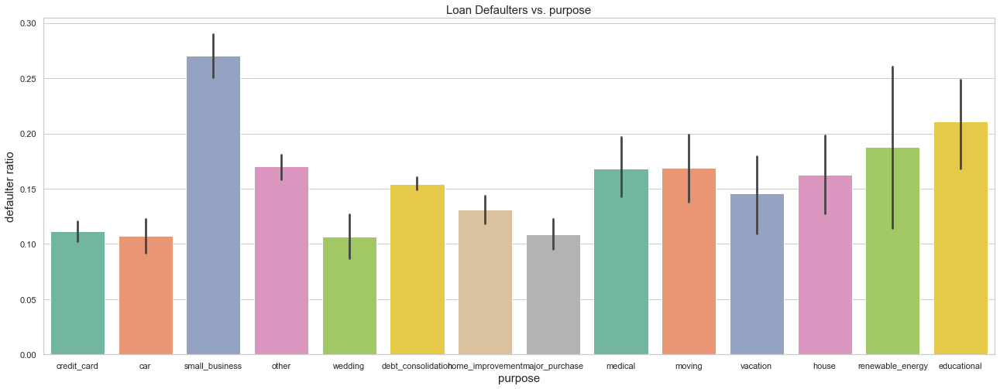

In [109]:
print_barplot('purpose',figsize=(22,8))

Obserwacje: Widać wyraźne różnice w ryzyku niespłacenia pożyczki dla różnych celów, jakie wskazują klienci we wniosku kredytowym.Najczęściej niespłacane są pożyczki brane na cel określony jako "mały biznes", co jest dość intuicyjne - taki cel wiąże się z dużym ryzykiem nipowodzenia przedwsięwzięcia biznesowego. Dużym ryzykiem w stosunku do innych grup obarczony jest też cel edukacyjny, odnawialna enrgia, cele medyczne i przeprowadzka oraz dom. Najmniejsze ryzyko odnotowano dla pożyczek branych na cel spłącenia karty kredytowej, zakupu samochodu, wesela i dużych zakupów. 

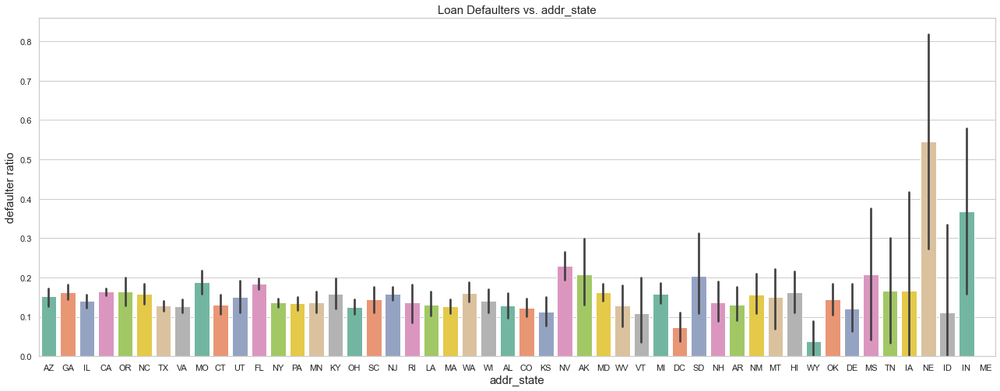

In [110]:
print_barplot('addr_state', figsize=(22,8))

Obserwacje: Widać różnice w ryzyku niespłacenia pożyczki ze względu na stan, w jakim się mieszka - przy czym jest kilka stanów, które "wybijają się" pod względem tego ryzyka (NE, IN, potem MS, SD, NV, AK) oraz kilka stanów, dla których ryzyko jest najmniejsze - DC, WY. W reszcie to ryzyko jest podobne,choć są niewlekie różnice. Należy też wziąć pod uwagę parametr, którego tu nie widać, czyli zbalansowanie danych - jeśli dla jakiegoś stanu było mało rekordów, to ryzyko dla niego określone będzie mniej wiarygodne, niż dla stanu, z którego było zgromadzonych wiele danych. Widać to bardziej w tabeli z prawdopodobieństwem wyliczonym w dalszej części projektu. 

/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


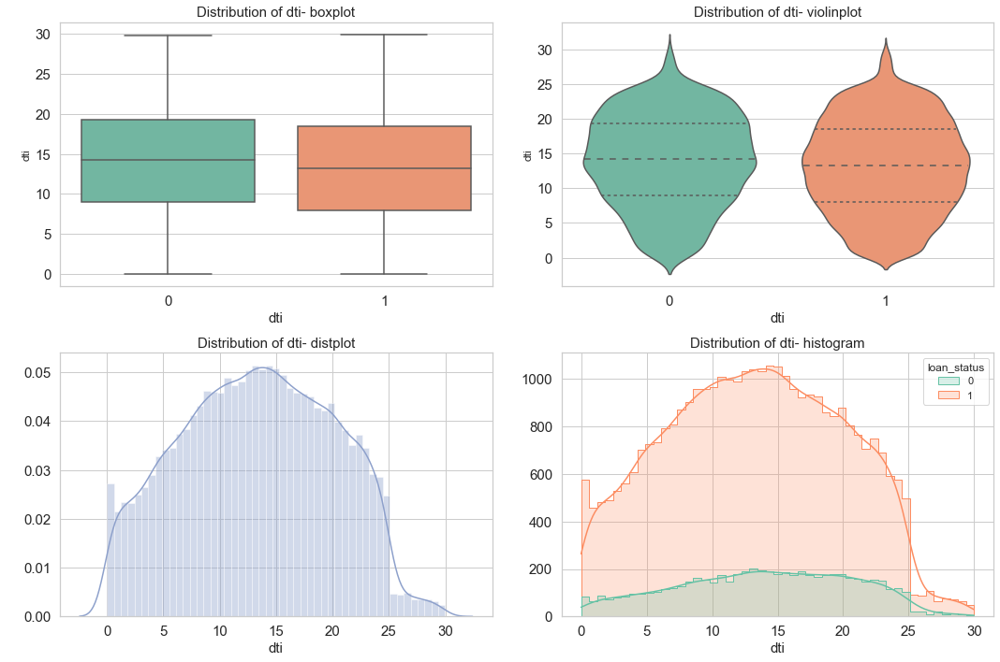

In [111]:
print_4plots('dti')

Obserwacje: Parametr dti jest wyliczony przy wzięciu pod uwagę miesięcznych rat oraz miesięcznego przychodu. Jego opis wskazuje, że "im mniejszy, tym lepiej". Pokrywa się to z obserwacjami z wykresów, bo średnie dti jest mniejsze dla osób spłacajacych pożyczki, niż dla niespłacających.

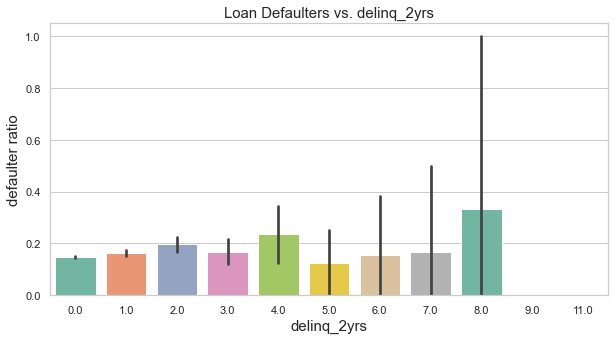

In [112]:
print_barplot('delinq_2yrs')

Obserwacje: Widać różnice między grupami, jednak nie ma tu wyraźniej zależności. Widać, że 8 przypadków ponad 30dniowego opóźnienia opłat w ciągu ostatnich 2 lat odnotowanych w historii kredytowej oznacza największe ryzyko niespłacenia pożyczki. Co ciekawe, najmniejsze ryzyko niespałcenia nie było odnotowane dla 0 takich przyapdków, a dla 5, ale też odchylenia standardowe w grupach są na tyle duże, że ciężko tu wyrokować na tej podstawie. 

<AxesSubplot:xlabel='earliest_cr_line', ylabel='loan_status'>

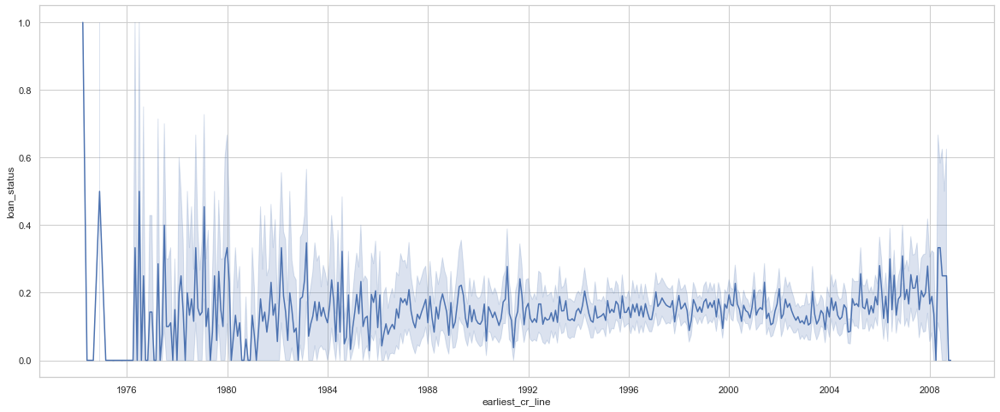

In [113]:
plt.figure(figsize=(20,8))
sns.lineplot(data=data_eda_outliers_removed, x=data_eda_outliers_removed['earliest_cr_line'], y=1-target,)

Obserwacje: można stwierdzić,że wraz z późniejszą datą rozpoczęcia historii kredytowej niewiele wzrasta ryzyko niespłącenia pożyczki. Ale wahania są duże na przestrzeni lat i nie jest to jakaś wyraźna tendencja. Ten parametr będzie też rozpatrywany później w sposób bardziej informatywny przy badaniu dodatkowo utworzonej zmiennej 'credit time', która odniesie rok rozpoczęcia historii kredytowej, do roku wystąpienia o daną pożyczkę. 

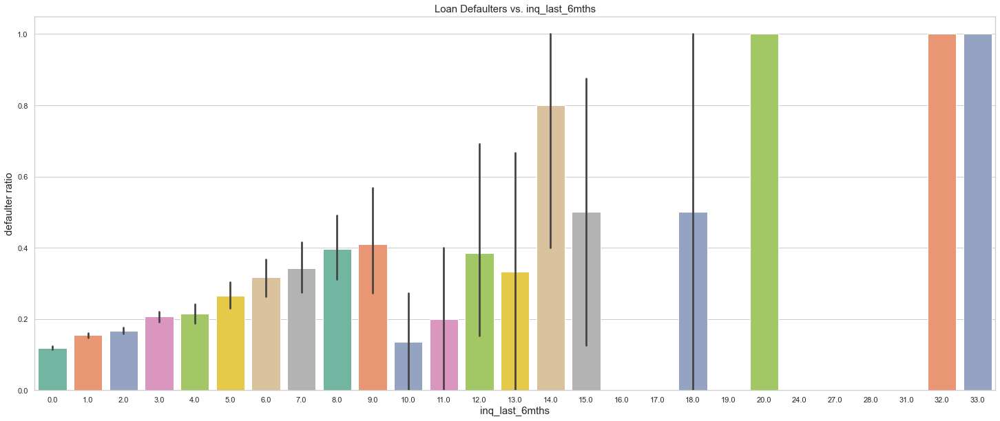

In [114]:
print_barplot('inq_last_6mths', figsize=(25,10))

Obserwacje: widać liniową zalezność między liczbą zapytań w ciągu ostatnich 6 miesięcy do liczby 9 zapytań - potem tendencja się załamuje i różnie to wygląda. Co ciekawe, to pierwsza cecha, w które istnieją grupy ze 100% ryzykiem niespłacenia pożyczki - np. przy 20, 32 i 33 zpaytaniach. Ale napewno ma też na to wpływ zbalanoswanie tych poszczególnych grup i takich przyapdków skrajnych jest mniej,albo w ogóle są pojedyncze - widać to też po odcyleniach standardowych. W ogóelności można odczytać z tego wykresu, że lepiej jak klient ma mniej zapytań, niż więcej. 

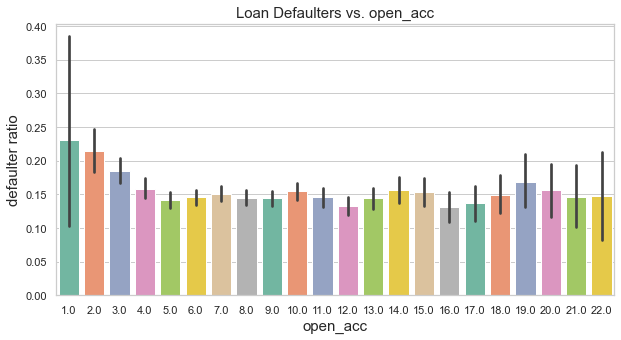

In [115]:
print_barplot('open_acc')

Obserwacje: Największym ryzykiem niespłacenia pożyczki obarczone są osoby z jedną otwartą linią kredytową i ryzyko to zmniejsza się liniowo aż do 5, po czym tendencja spadkowa normuje się i widoczne są niewielkie różnice między kolejnymi grupami.

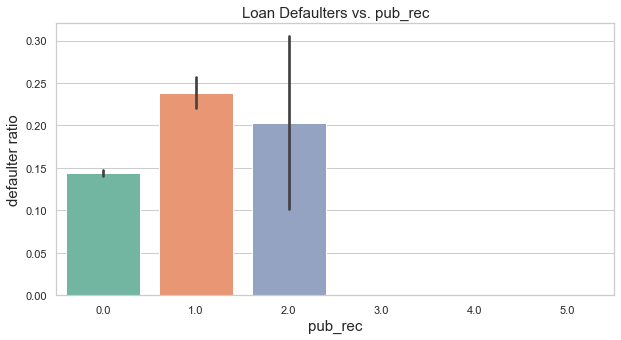

In [116]:
print_barplot('pub_rec')

Obserwacje: nie ma tu wyraźnej tendencji - np. 1 szkodliwy wpis (informacja np. o braku spłącenia jakiegoś zobowiązania) wiąże się z większym ryzykiem niespłacenia pożyczki niż 2 takie wpisy, a 3,4,5 - wygląda na to, że prawdopodobieństwo jest zerowe (to pewnie kwestia liczności takich obserwacji).

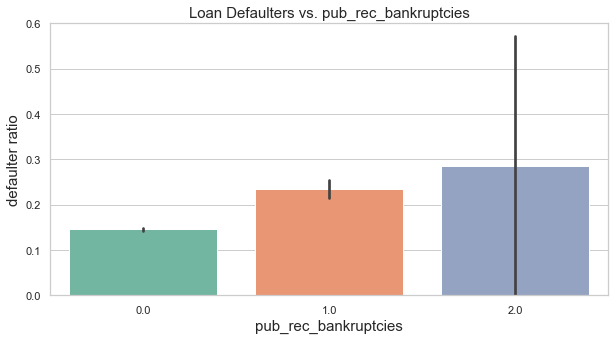

In [117]:
print_barplot('pub_rec_bankruptcies')

Obserwacje: Widać tendencję do wzrostu ryzyka niespłacenia pożyczki wraz z liczbą bankructw w rejestrze. 

/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



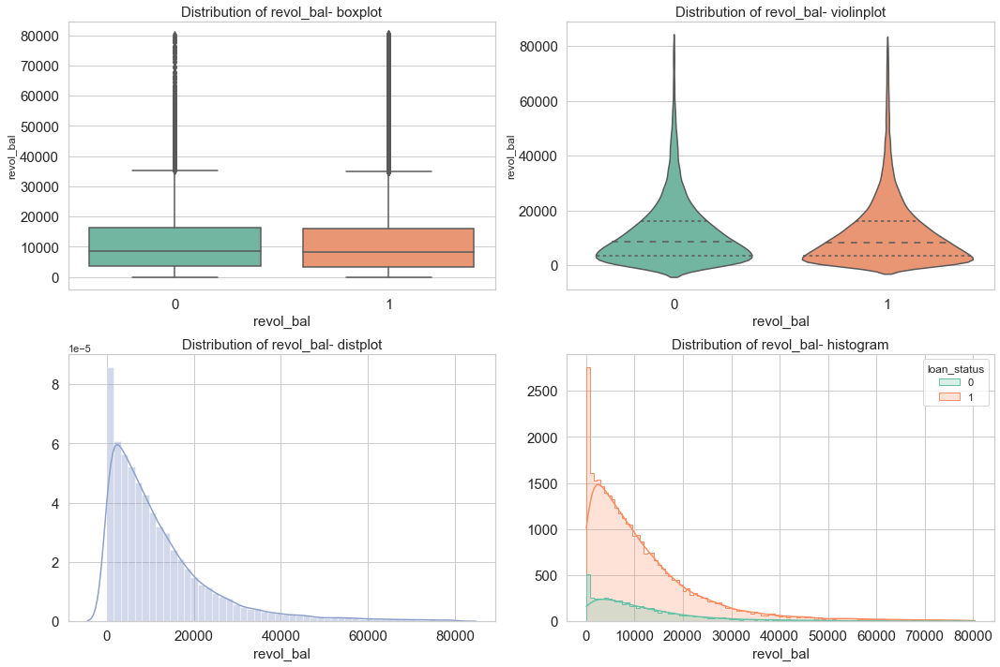

In [347]:
print_4plots('revol_bal')

Obserwacje: Średnie saldo pozostałe do spłaty jest niwiele wyższe dla grupy niespłacających pożyczki.

/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


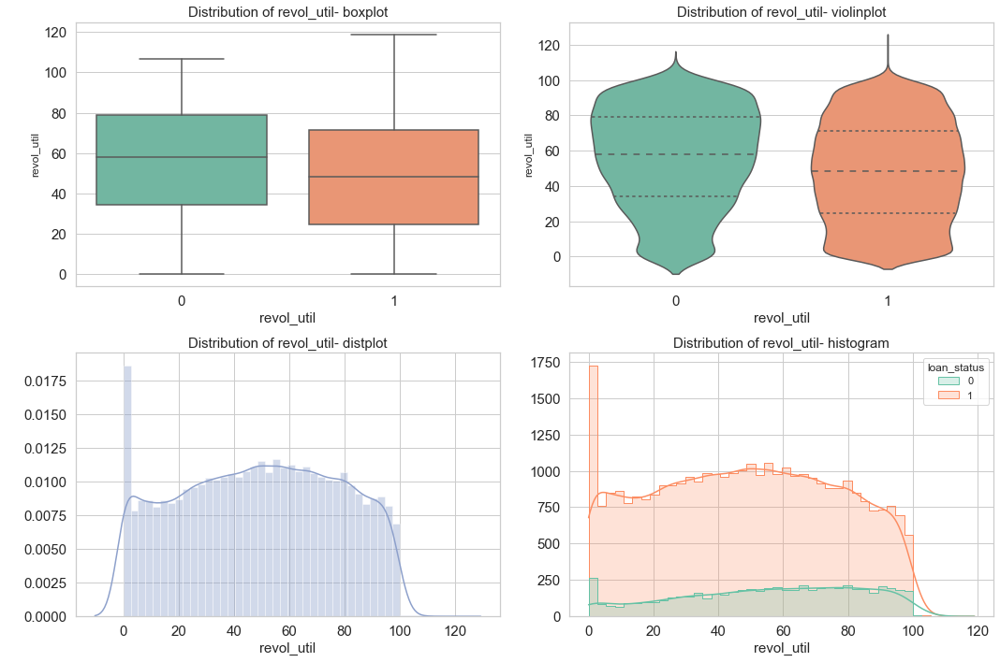

In [119]:
print_4plots('revol_util')

Obserwacje: Średni % wykorzystania kredytu jest wyższy dla osób niespłacających pożyczki, w stosunku do osób spłacających.

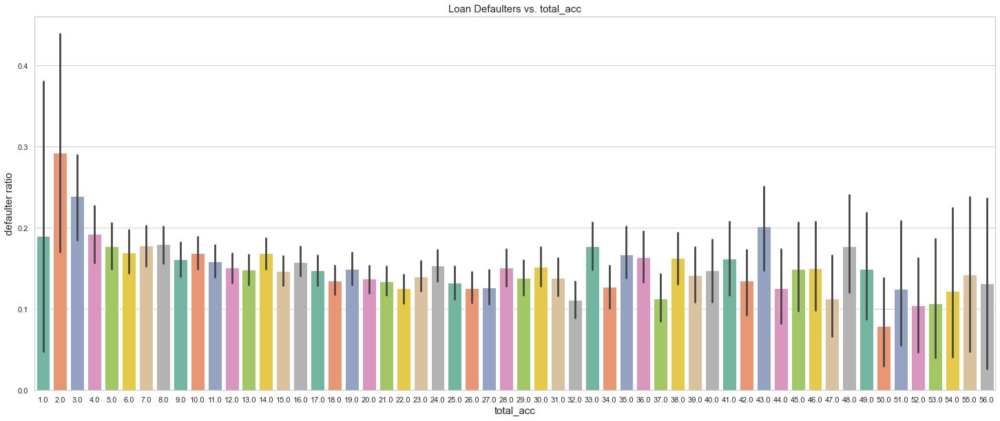

In [120]:
print_barplot('total_acc',figsize=(25,10))

Obserwacje: Największym ryzykiem niespłącenia pożyczki obarczone są osoby z 2 lub 3 otwartymi liniami kredytowymi, pomiędzy resztą grup widać też różnice, jednak nie układają się one w żadną ogólną tendencję.

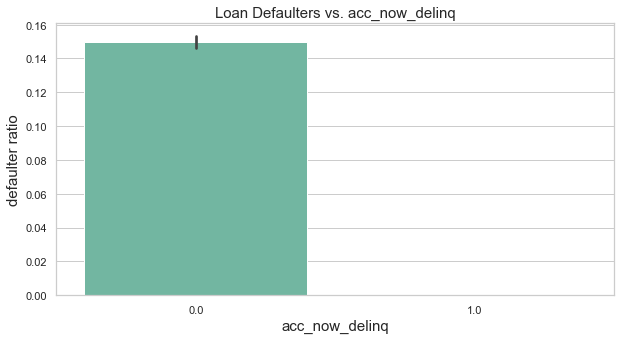

In [121]:
print_barplot('acc_now_delinq')

Obserwacje: Posiadanie otwartego konta jest minimalizuje ryzyko niespłacenia pozyczki - do 0, podczas gdy brak posiadania żadnego otwartego konta to 15% ryzyko niespłacenia. 

/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:305: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


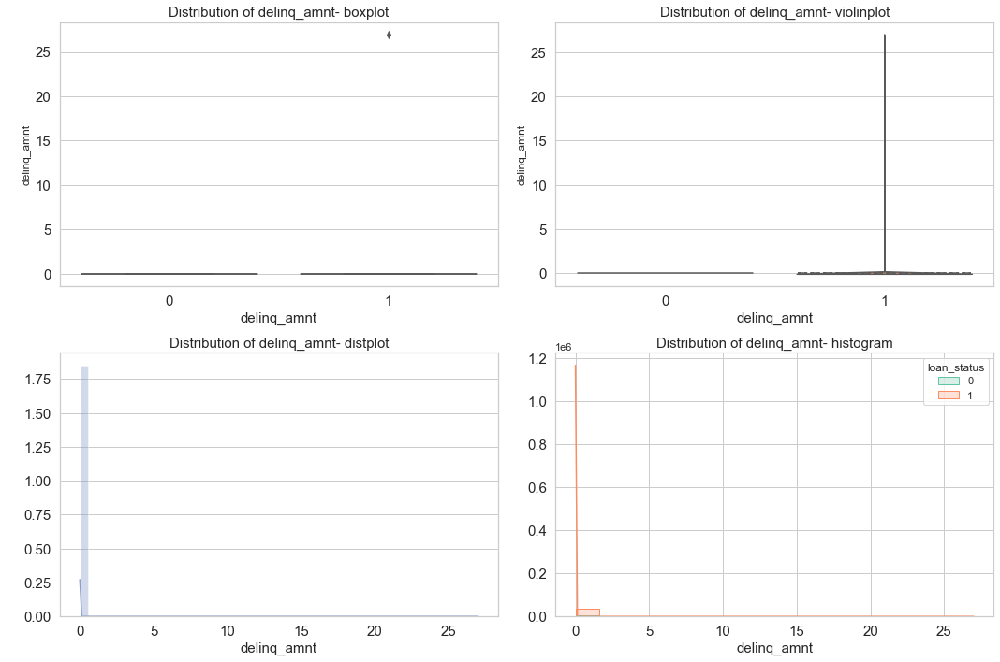

In [122]:
print_4plots('delinq_amnt')


Obserwacje: Widzę, że jeśli chodzi o tę wartość to należałoby usunąć więcej outlierów niż wynikało z z-score, ale w zasadzie wtedy sobie usunę całą informację, bo poza tą jedną odstającą informacją to są same 0 , także ta kolumna jest prawie taka sama dla wszystkich rekordów, a zatem nie jest specjanie informatywna - do pominięcia.

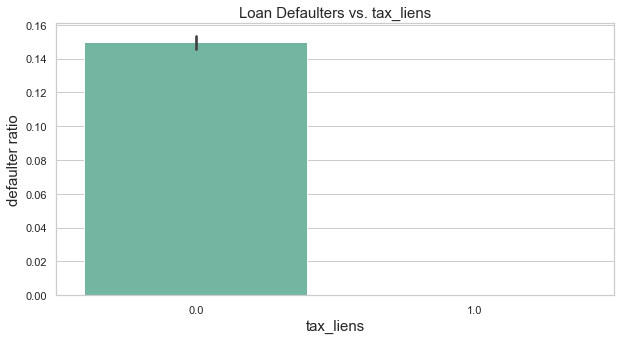

In [123]:
print_barplot('tax_liens')

Obserwacje: Posiadanie zastawu podatkowego minimalizuje ryzyko niespłacenia pozyczki - do 0, podczas gdy jego brak  oznacza 15% ryzyko niespłacenia. Trochę sprzeczne z intuicją, ale tak to wygląda na tych danych.

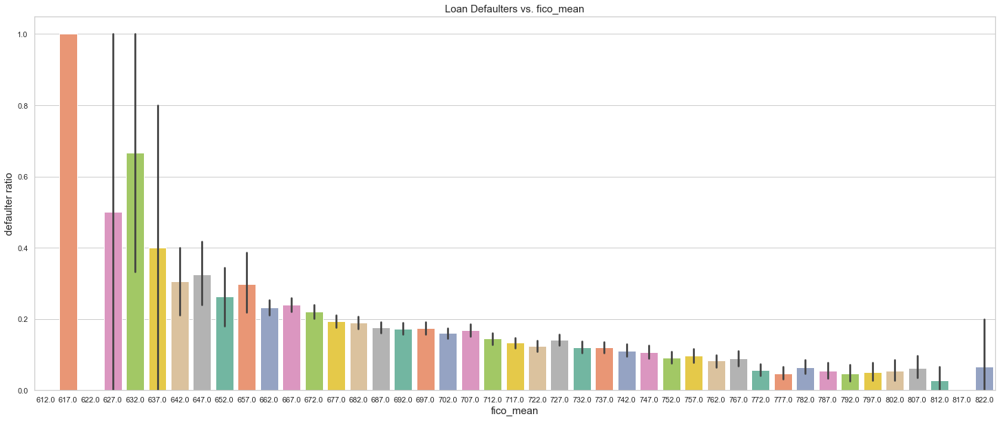

In [124]:
print_barplot('fico_mean', figsize=(25,10))

Obserwacje: Im wyższy wynik Fico, tym mniejsze ryzyko niespłacenia pożyczki.

/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


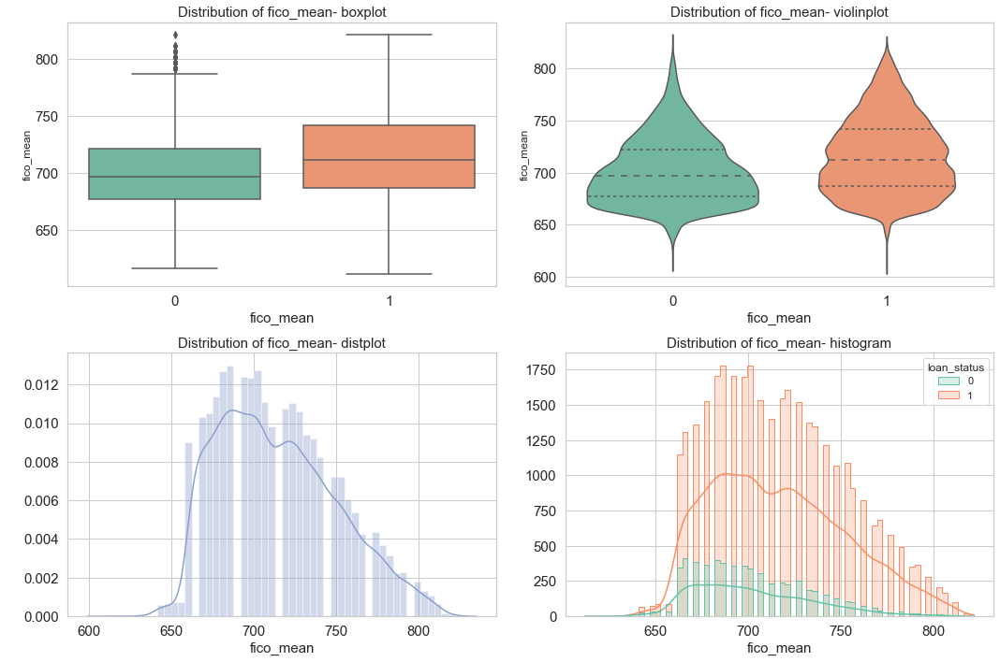

In [125]:
print_4plots('fico_mean')
#tu postanawiam potraktować raz jak zmienną kategoryczną, a raz jak ciągłą

Obserwacje: Do powyższego wykresu, dodaję rozkłady, poniważ jest to bardzo ważna zmienna. Średni wynik fico_mean jest wyższy w grupie spłacających pożyczki. 

/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


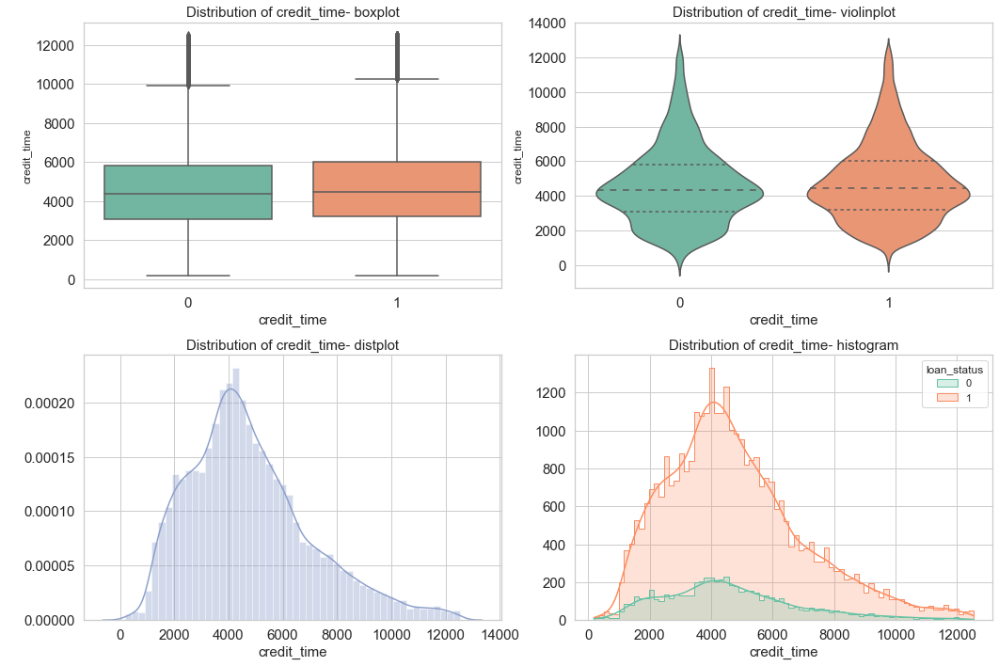

In [126]:
print_4plots('credit_time')

Obserwacje: Średni wiek kredytowy jest nieco wyższy dla osób spłacających pożyczki. Rozkłady się podobne dla obu grup. 

## Charts for two or more variables

In [348]:
def print_barplotof2(f1,f2,figsize=(15,10),palette=sns.color_palette('Set2'),order=None,hue=None):
    plt.figure(figsize=figsize)
    sns.barplot(x=f1,y=f2, data=data_eda_outliers_removed, palette=palette, order=order, hue=hue)
    plt.title(str(f1)+" vs. "+str(f2), fontsize=15)
    plt.xlabel(f1, fontsize=15)
    plt.ylabel(f2, fontsize=15)
    plt.show()

In [349]:
def print_barplotof2_ratio(f1,f2,figsize=(15,10),palette=sns.color_palette('Set2'),order=None,hue=None):
    plt.figure(figsize=figsize)
    sns.barplot(x=f1,y=1-target, data=data_eda_outliers_removed, palette=palette, order=order, hue=f2)
    plt.title("Loan Defaulters vs. "+str(f1), fontsize=15)
    plt.xlabel(f1, fontsize=15)
    plt.ylabel("defaulter ratio", fontsize=15)
    plt.show()

In [350]:
def print_scatterplotof2(f1,f2, figsize=(15,10), palette=sns.color_palette('Set2'),hue=None):
    plt.figure(figsize=figsize)
    sns.scatterplot(x=f1, y=f2, hue=hue, data=data_eda_outliers_removed)
    plt.title("Scatter plot between "+f1+" and "+f2)
    plt.xlabel(f1, fontsize=15)
    plt.ylabel(f2, fontsize=15)
    plt.show()

In [351]:
def print_boxplotof2(f1,f2, figsize=(15,10), palette=sns.color_palette('Set2'),order=None,hue=None):
    plt.figure(figsize=figsize)
    sns.boxplot(x=f1, y=f2, hue=hue, data=data_eda_outliers_removed,palette=palette,order=order)
    plt.title("Distribution on boxplot of "+f1+" and "+f2)
    plt.xlabel(f1, fontsize=15)
    plt.ylabel(f2, fontsize=15)
    plt.show()

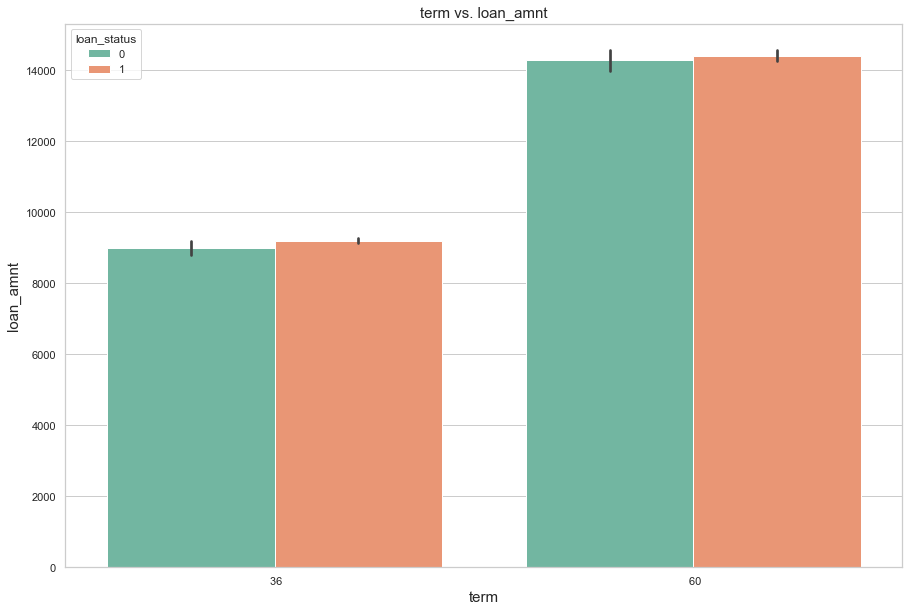

In [131]:
print_barplotof2('term', 'loan_amnt', hue=target)

Obserwacje: W obu grupach - spłącających i niespłacających pożyczki dłuższy czas słaty pożyczki wiąże się z wyższą jej kwotą.

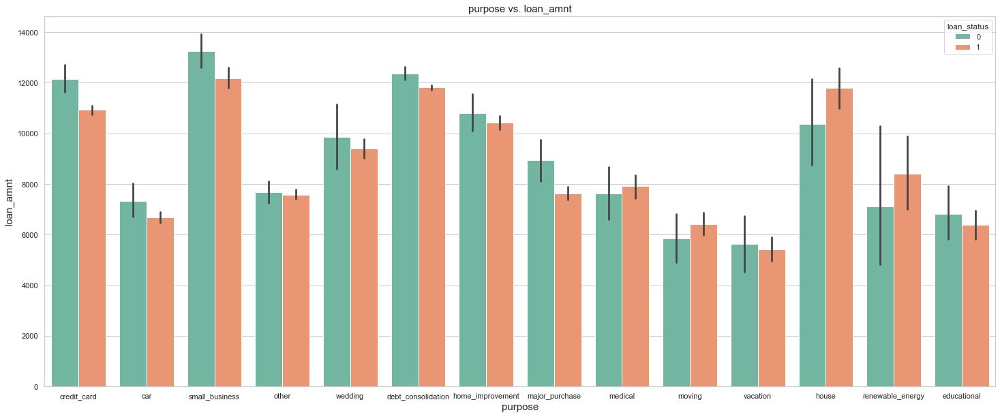

In [132]:
print_barplotof2('purpose', 'loan_amnt', figsize = (25,10), hue='loan_status')

Obserwacje: W przypadku większości deklarowanych celów pożyczek, osoby niespłacające cześciej brały wyższą pożyczkę, niż osoby spłacajace deklarujące ten sam cel. Tendencja odwrotna jest widoczna dla celów: medycznych, przeprowadzki, zakupu domu i energii odnawialnej. 

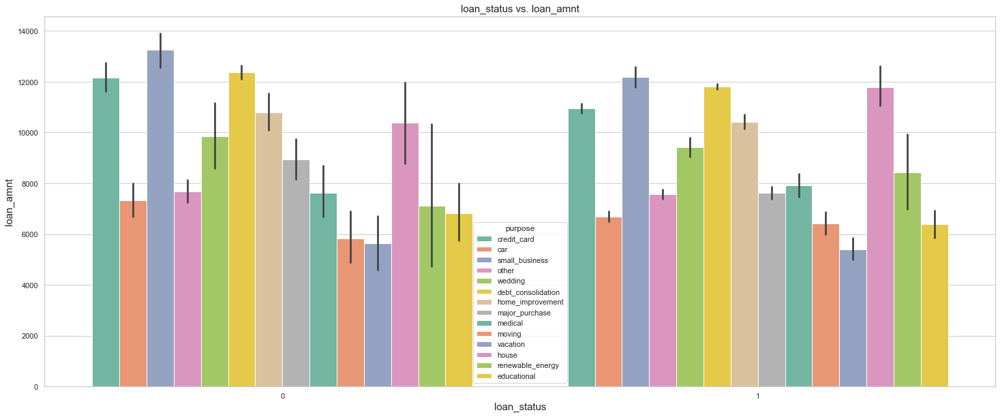

In [133]:
print_barplotof2('loan_status', 'loan_amnt', figsize = (25,10), hue='purpose')

Obserwacje: Stosunek wielkości pożyczek między poszczególnymi grupami (celami) jest podobny w grupie osób spłacających i niespłacających pożyczki.

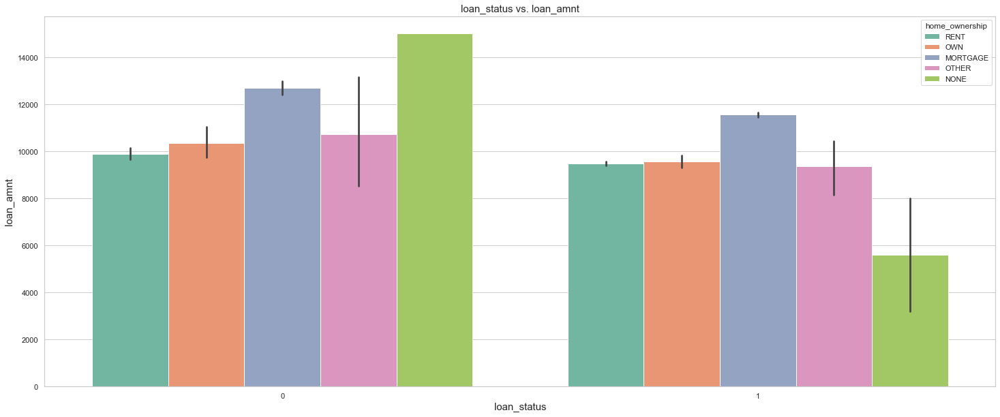

In [134]:
print_barplotof2('loan_status', 'loan_amnt', figsize = (25,10), hue='home_ownership')

Obserwacje: Relacje między wielkością pożyczki a statusem posiadania domu są podobne w obu grupach (0 i 1) dla wynajmu, własności ihipoteki, natomiast różnią się dla statusu None i Other. 

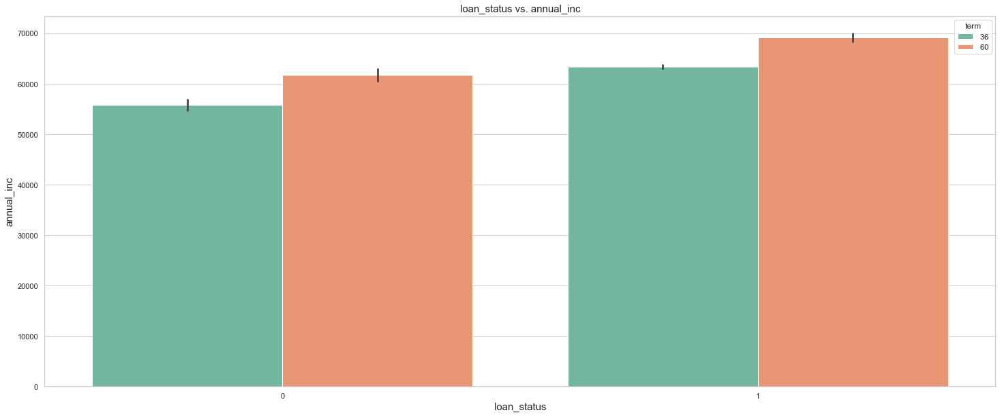

In [135]:
print_barplotof2('loan_status', 'annual_inc', figsize = (25,10), hue='term')

Obserwacje: Osoby biorące pożyczki na dłużej miały większy średni przychód zarówno w grupie spłącających, jak i niespłacacjących. 

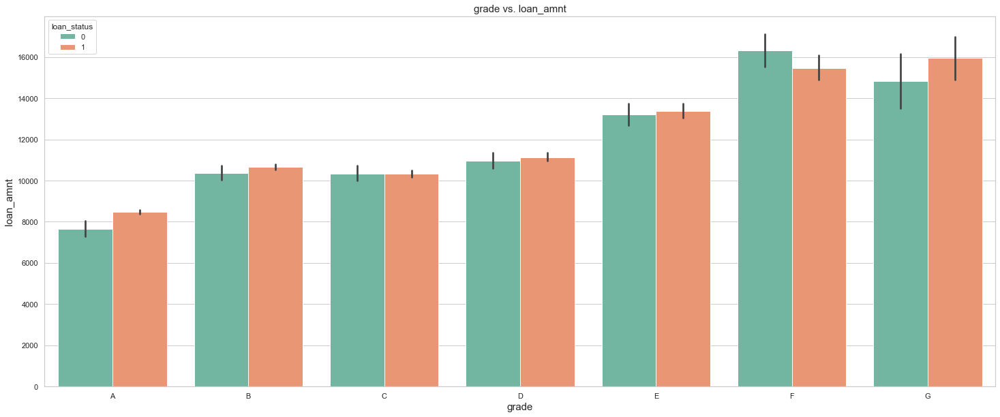

In [136]:
print_barplotof2('grade', 'loan_amnt', figsize = (25,10), hue='loan_status', order=["A", "B", 'C', 'D', 'E', 'F', 'G'])

Obserwacje: Osoby uzyskujące wysoką ocenę (A) brały niższe pożyczki (w obu grupach) niż osoby uzyskujące niższe oceny. 

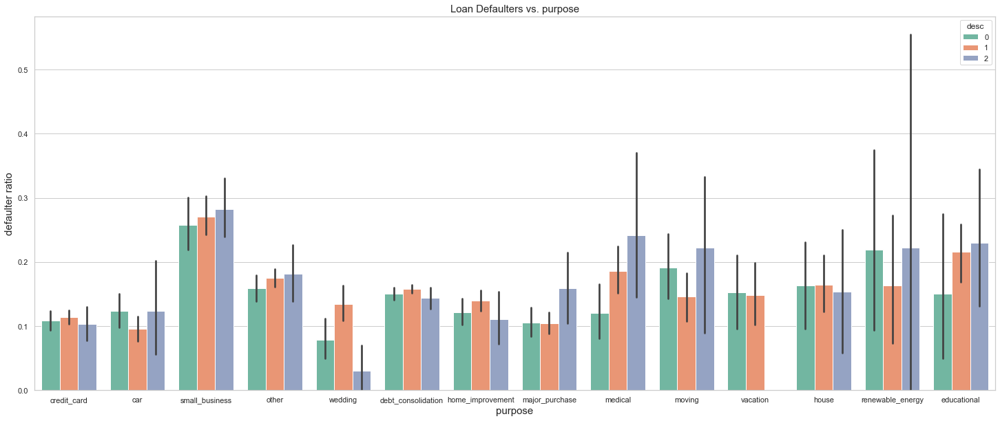

In [137]:
print_barplotof2_ratio('purpose', 'desc', figsize = (25,10))

Obserwacje: Fakt, czy najdłuższy opis, średnio-długi opis czy brak opisu wiąże się z największym ryzykiem niespłacenia pożyczki zależy od celu - tendencje są różne dla różnych grup. 

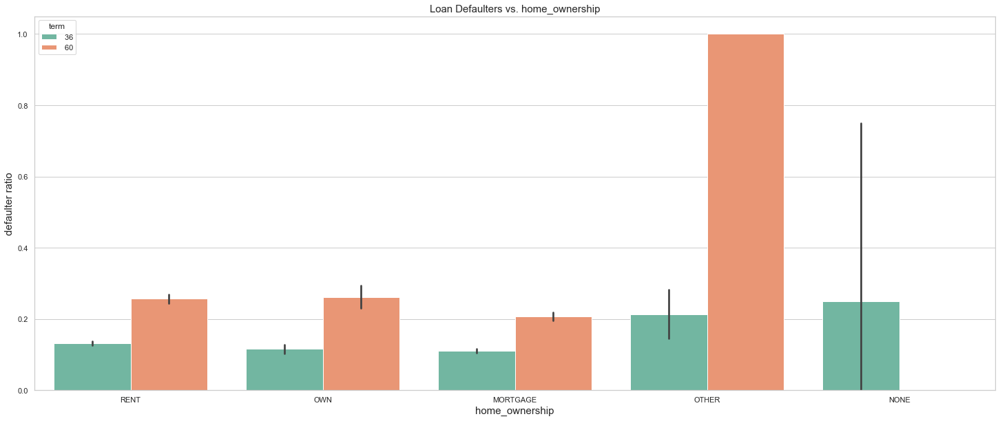

In [138]:
print_barplotof2_ratio('home_ownership','term', figsize = (25,10))

Obserwacje: Dłuższa pożyczka wiąże się z większym ryzykiem niespłacenia pożyczki w każdej z grup oznaczających status domu, oprócz grupy None - czyli braku posiadania domu. 

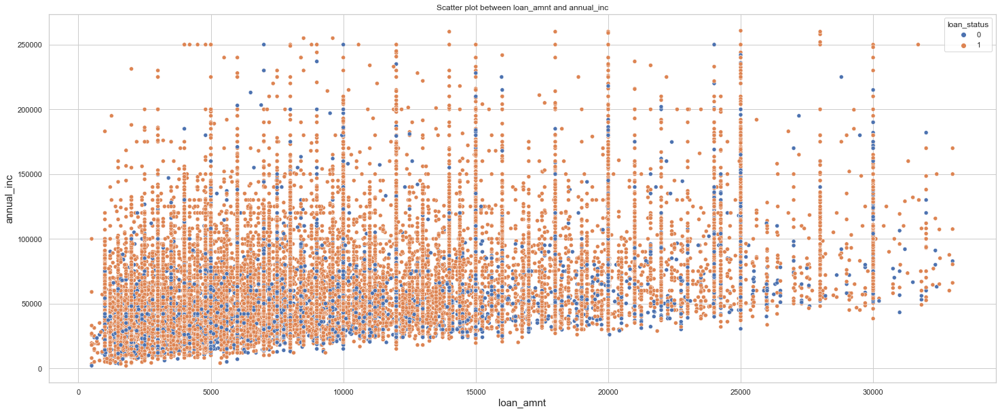

In [139]:
print_scatterplotof2('loan_amnt','annual_inc', figsize = (25,10), hue='loan_status')

Obserwacje: W obu grupach (0 i 1) o większą kwotę pożyczki wnioskują osoby z większym rocznym dochodem.

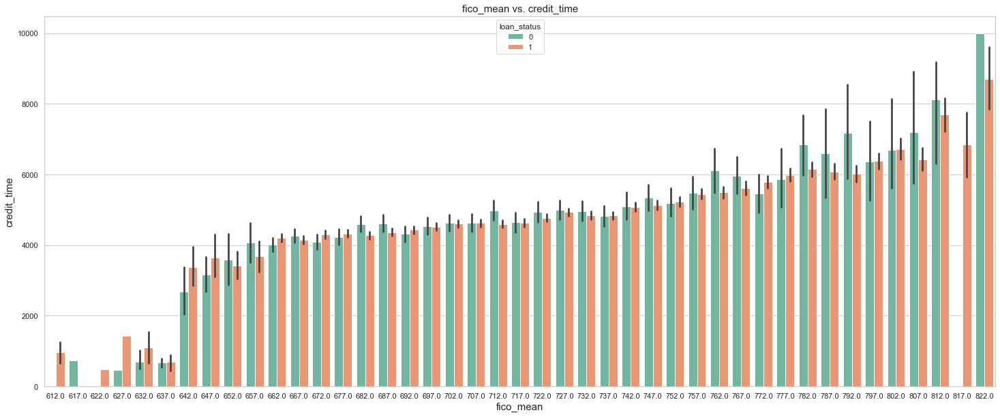

In [142]:
print_barplotof2('fico_mean', 'credit_time', figsize = (25,10), hue=target)

Obserwacje: Im większy wiek kredytowy, tym wyższy wynik fico. Liniowa tendencja załamuje się przywynikach fico_mean mniejszych niż 637.

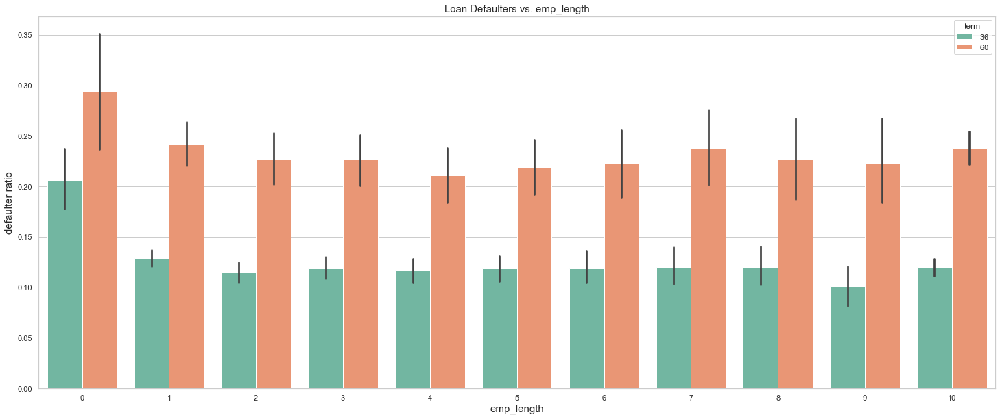

In [143]:
print_barplotof2_ratio('emp_length','term', figsize = (25,10))

Obserwacje: Dłuższy okres pożyczki wiąże się z wyraźnie większym ryzykiem niespłacenia dla osób o każdej długości stażu pracy.

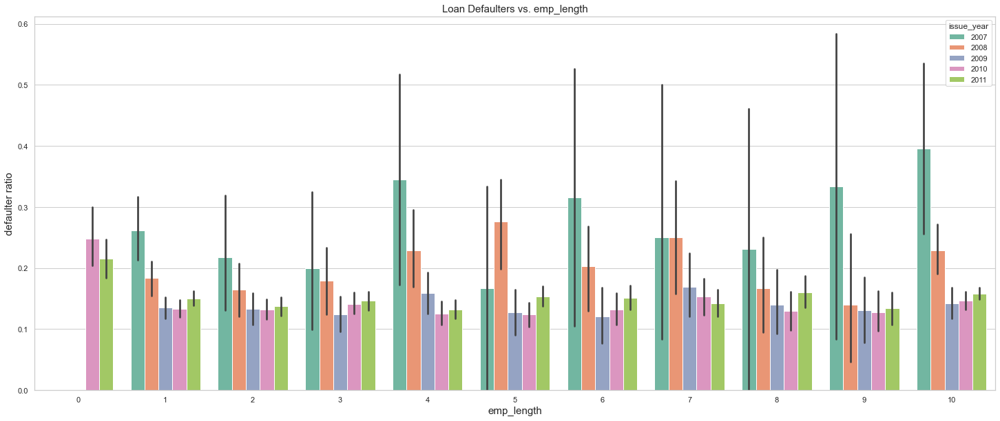

In [144]:
print_barplotof2_ratio('emp_length','issue_year', figsize = (25,10))

Obserwacje: Ryzyko niespłacenia pożyczki jest różne dla różnych lat występowania o pożyczkę i różnice między latami zalezą też od stażu pracy, nie ma jednej tendencji.

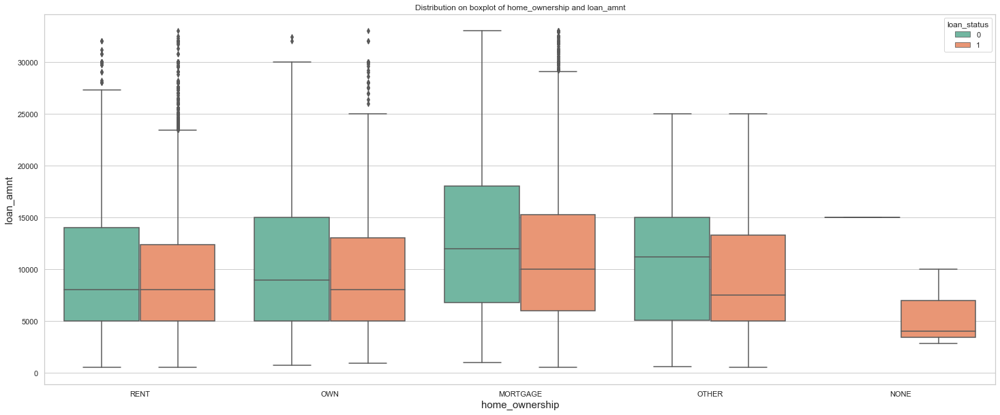

In [145]:
print_boxplotof2('home_ownership','loan_amnt', figsize = (25,10), hue='loan_status')

Obserwacje: Największe pożyczki średnio biorą osoby posiadające hipotekę; średnia wielkość pożyczki jest podobna dla grup spłacających i niespłacających tylko wśród osób wynajmujących mieszkanie/dom, a dla wszystkich pozostałych grup średnia wielkość pożyczki jest większa wśród osób niespłącajacych pożyczki.

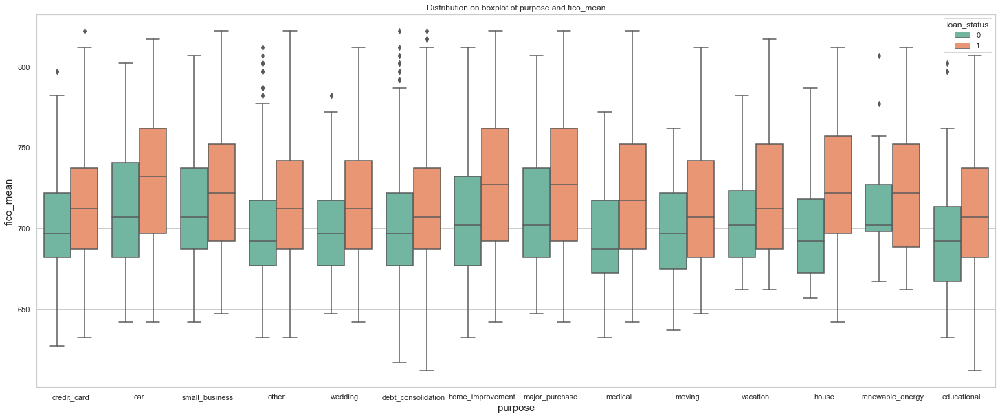

In [148]:
print_boxplotof2('purpose','fico_mean', figsize = (25,10), hue='loan_status')

Obserwacje: Osoby w wysokim wynikiem fico częściej spłacały pożyczki, niezależnie od celu na jaki brały pożyczkę. 

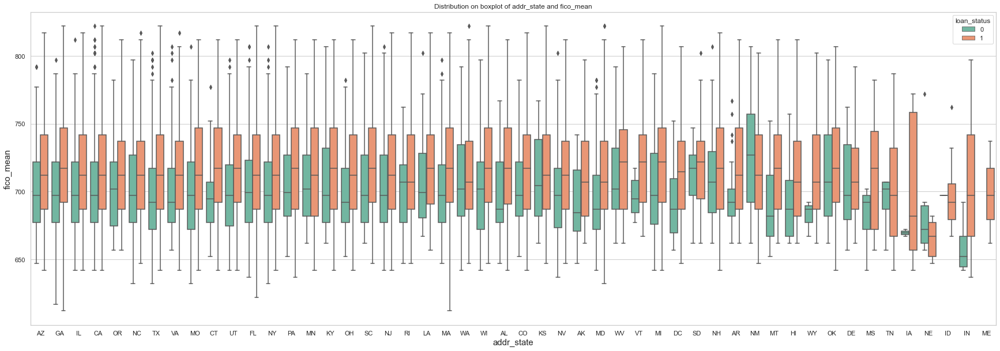

In [149]:
print_boxplotof2('addr_state','fico_mean', figsize = (30,10), hue='loan_status')

Obserwacje: Prawie w każdym stanie osoby uzyskujące średni wyższy wynik fico częściej spłacały pożyczki, wyjątek stanowią stany TN i NE, gdzie średni wynik fico był wyższy wśród osób niespłacających pożyczek.

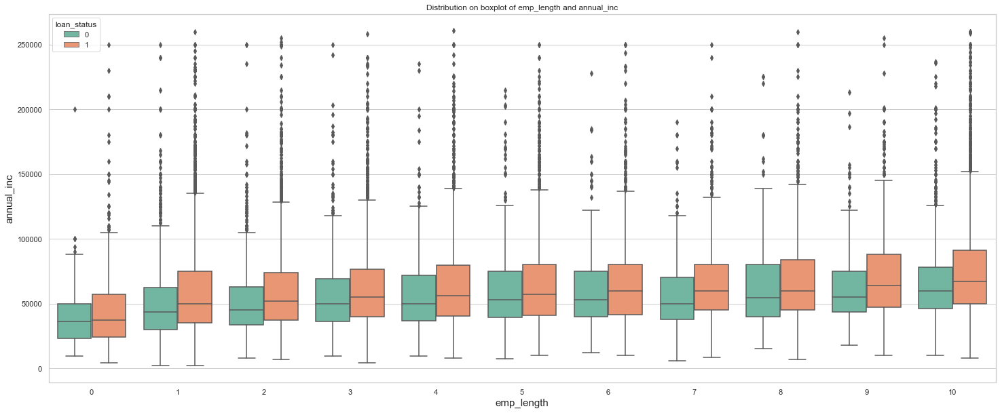

In [150]:
print_boxplotof2('emp_length','annual_inc', figsize = (25,10), hue='loan_status')

Obserwacje: Roczny przychód jest większy wśród osób spłącających pożyczkę z każdym stażem pracy, ale najmniejsze różnice miedzy grupami widać przy braku zatrudnienia. 

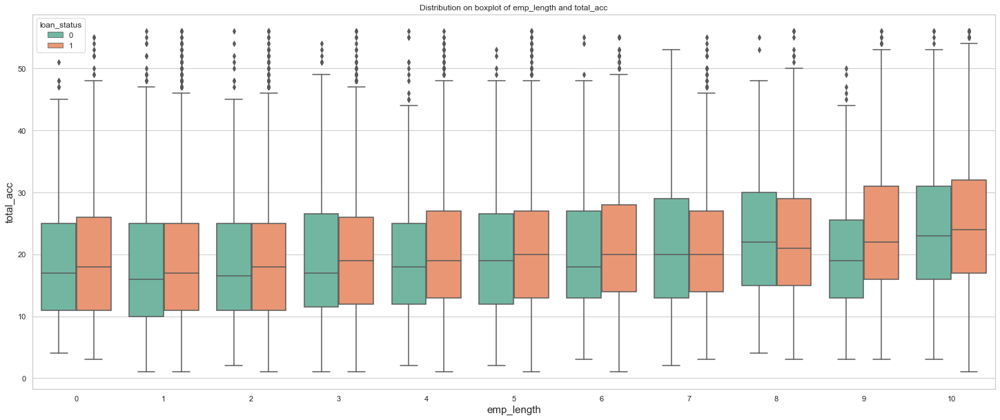

In [151]:
print_boxplotof2('emp_length', 'total_acc', figsize = (25,10), hue='loan_status')

 Obserwacje: Zazwyczaj osoby z większą liczbą otwartych linii kredytowych częściej spłacały pożyczki, wyjątek stanowią grupy z 7 i 8 letnim stażem, gdzie nie było różnicy (7lat) lub tendencja była odwrotna (8 lat stażu).

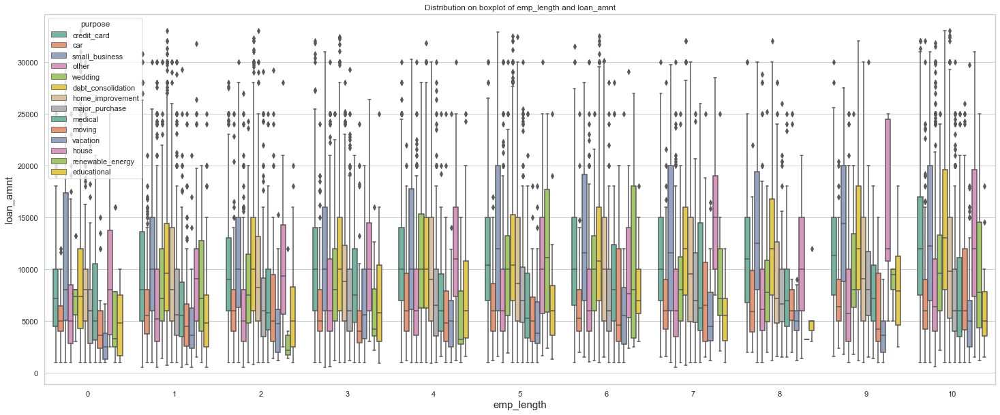

In [153]:
print_boxplotof2('emp_length','loan_amnt', figsize = (25,10), hue='purpose')

Obserwacje: Prawie na kazdym etapie zatrudnienia największe pożyczki brano na biznes, a najmniejsze na przeprowadzkę czy wakacje.

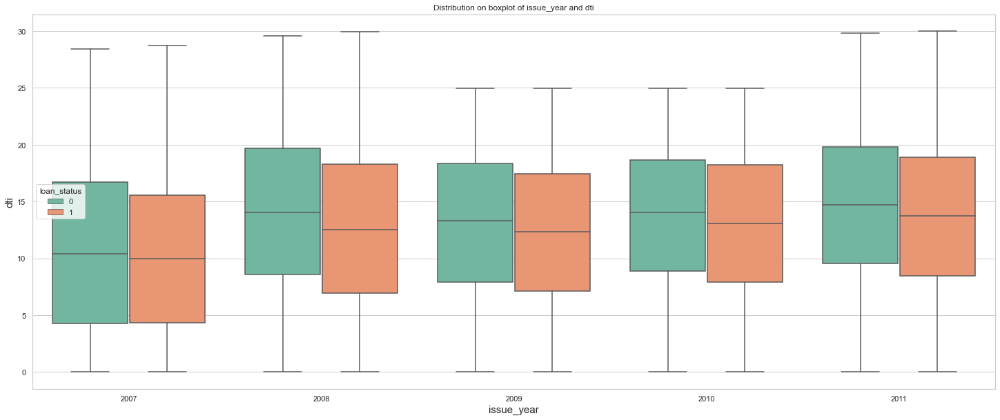

In [155]:
print_boxplotof2('issue_year','dti', figsize = (25,10), hue='loan_status')

Obserwacje: Osoby biorące pożyczkę w 2008 miały najwyższe wskaźniki dti, we wszystkich latach osoby z wyższym wskaźnikiem dti częściej niespłacały pożyczek. 

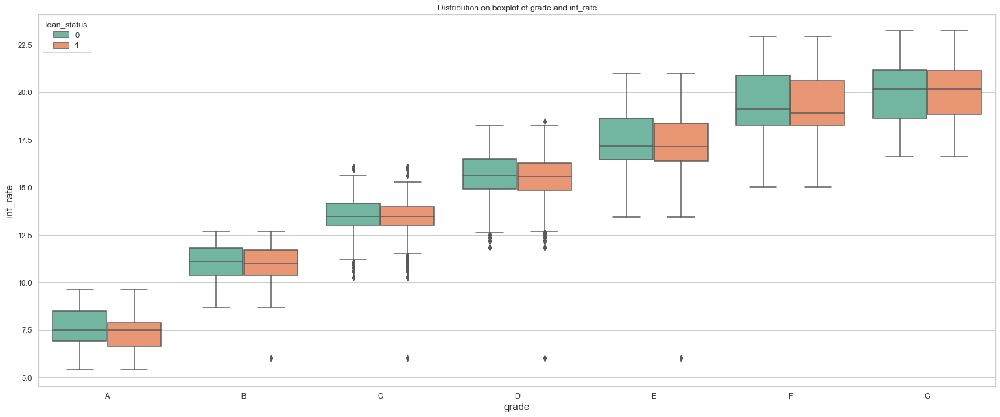

In [156]:
print_boxplotof2('grade','int_rate', figsize = (25,10), hue='loan_status', order=["A", "B", 'C', 'D', 'E', 'F', 'G'])

Obserwacje: Im gorsza ocena, tym wyższy int_rate. 

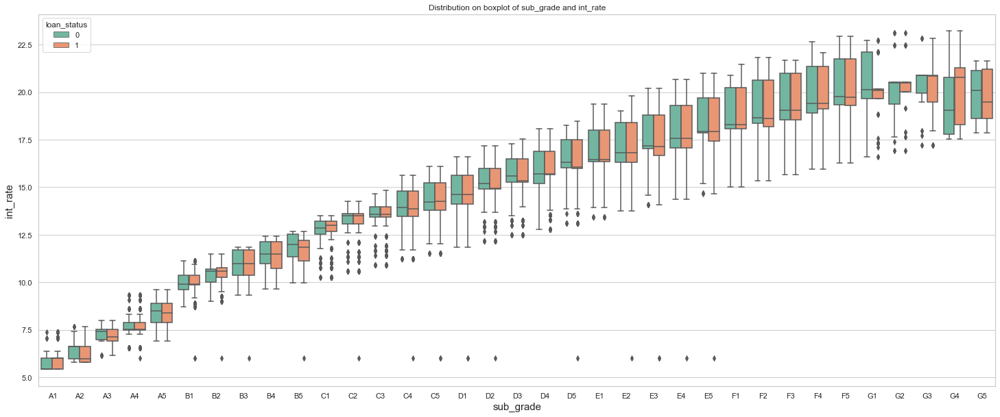

In [363]:
print_boxplotof2('sub_grade','int_rate', figsize = (25,10), hue='loan_status', order=['A1','A2','A3','A4','A5','B1','B2','B3','B4','B5', 'C1','C2','C3','C4','C5', 'D1','D2','D3','D4','D5','E1','E2','E3','E4','E5', 'F1','F2','F3','F4','F5', 'G1','G2','G3','G4','G5'])

Obserwacje: Im gorsza ocena, tym wyższy int_rate. Tendencja załamuje się przy ocenach G1-G5. 

In [118]:
#na potrzeby eksploracji i tego żeby łatwiej policzyć prawdopodobieństwo postanawiam ustalić zakresy:
#fico_mean- mniej więcej zgodnie z opisem w dokumencie projektu, 
#credit_time, annual_inc, loan_amnt, int_rate, installment, dti

# loan_amnt ranges
bins = [0, 5000, 10000, 15000, 20000, 25000, 36000]
label = ['0-5000', '5000-10000', '10000-15000', '15000-20000', '20000-25000','25000+']
data_eda_outliers_removed['loan_amnt_range'] = pd.cut(data_eda_outliers_removed['loan_amnt'], bins, labels=label)
# int_rate ranges
bins = [0, 7.5, 10, 12.5, 15, 100]
label = ['0-7.5', '7.5-10', '10-12.5', '12.5-15', '15+']
data_eda_outliers_removed['int_rate_range'] = pd.cut(data_eda_outliers_removed['int_rate'], bins, labels=label)
# annual_inc ranges
bins = [0, 25000, 50000, 75000, 100000, 1000000]
label = ['0-25000', '25000-50000', '50000-75000', '75000-100000', '100000+']
data_eda_outliers_removed['annual_inc_range'] = pd.cut(data_eda_outliers_removed['annual_inc'], bins, labels=label)

#credit_time ranges - tu dodatkowo dzielę przez 365, żeby określić ten wiek w latach 
data_eda_outliers_removed['credit_time_years']=(data_eda_outliers_removed['credit_time']/365).round(2)
bins = [0, 5, 10, 15, 20, 25, 30, 35]
label = ['0-5', '5-10', '10-15', '15-20', '20-25', '25-30', '30+']
data_eda_outliers_removed['credit_time_years_range'] = pd.cut(data_eda_outliers_removed['credit_time_years'], bins, labels=label)

#dti_ranges 
bins = [0, 5, 10, 15, 20, 25, 32]
label = ['0-5', '5-10', '10-15', '15-20', '20-25', '25+']
data_eda_outliers_removed['dti_range'] = pd.cut(data_eda_outliers_removed['dti'], bins, labels=label)

# fico_mean ranges
def fico_rating(n):
    if n <= 580:
        return 'Poor'
    elif n > 580 and n <=669:
        return 'Fair'
    elif n > 670 and n <=739:
        return 'Good'
    elif n > 740 and n <=799:
        return 'Very Good'
    else:
        return 'Exeptional'

data_eda_outliers_removed['fico_rating'] = data_eda_outliers_removed['fico_mean'].apply(lambda x: fico_rating(x))

#installment ranges
def installment(n):
    if n <= 200:
        return 'low'
    elif n > 200 and n <=500:
        return 'medium'
    elif n > 500 and n <=800:
        return 'high'
    else:
        return 'very high'

data_eda_outliers_removed['installment_category'] = data_eda_outliers_removed['installment'].apply(lambda x: installment(x))



In [119]:
data_eda_outliers_removed

,loan_amnt,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,annual_inc,verification_status,...,issue_year,issue_month,loan_amnt_range,int_rate_range,annual_inc_range,credit_time_years,credit_time_years_range,dti_range,fico_rating,installment_category
0,5000.0,36,10.65,162.87,B,B2,10,RENT,24000.0,Verified,...,2011,12,0-5000,10-12.5,0-25000,26.93,25-30,25+,Good,low
1,2500.0,60,15.27,59.83,C,C4,1,RENT,30000.0,Source Verified,...,2011,12,0-5000,15+,25000-50000,12.68,10-15,0-5,Very Good,low
2,2400.0,36,15.96,84.33,C,C5,10,RENT,12252.0,Not Verified,...,2011,12,0-5000,15+,0-25000,10.09,10-15,5-10,Good,low
3,10000.0,36,13.49,339.31,C,C1,10,RENT,49200.0,Source Verified,...,2011,12,5000-10000,12.5-15,25000-50000,15.84,15-20,15-20,Good,medium
4,3000.0,60,12.69,67.79,B,B5,1,RENT,80000.0,Source Verified,...,2011,12,0-5000,12.5-15,75000-100000,15.93,15-20,15-20,Good,low
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42508,6000.0,36,13.12,202.51,D,D5,2,RENT,12000.0,Not Verified,...,2007,7,5000-10000,12.5-15,0-25000,2.58,0-5,0-5,Fair,medium
42509,5350.0,36,13.12,180.57,D,D5,1,OWN,4000.0,Not Verified,...,2007,7,5000-10000,12.5-15,0-25000,0.58,0-5,10-15,Fair,low
42511,10000.0,36,14.70,345.18,E,E5,1,RENT,50000.0,Not Verified,...,2007,7,5000-10000,12.5-15,25000-50000,7.84,5-10,5-10,Fair,medium
42513,6000.0,36,10.59,195.28,C,C2,1,RENT,20000.0,Not Verified,...,2007,6,5000-10000,10-12.5,0-25000,11.42,10-15,10-15,Good,low


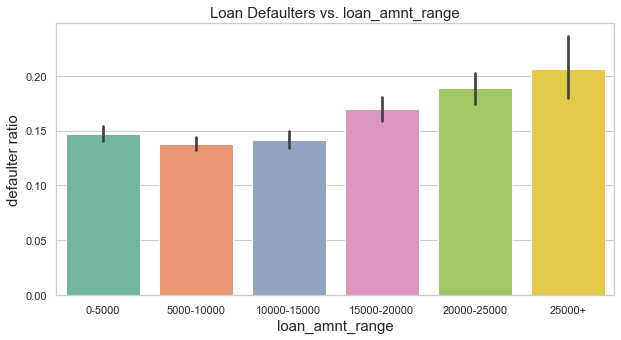

In [160]:
print_barplot('loan_amnt_range')

Obserwacje: Od kwoty pożyczki 15000 wzwyż rośnie ryzyko niespłącenia pożyczki.

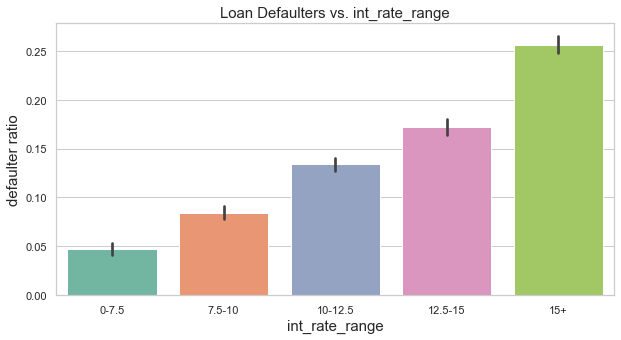

In [161]:
print_barplot('int_rate_range')

Obserwacje: Im wyższy int_rate, tym wyższe ryzyko niespłacenia pożyczki, zalezność wyglada na liniową.

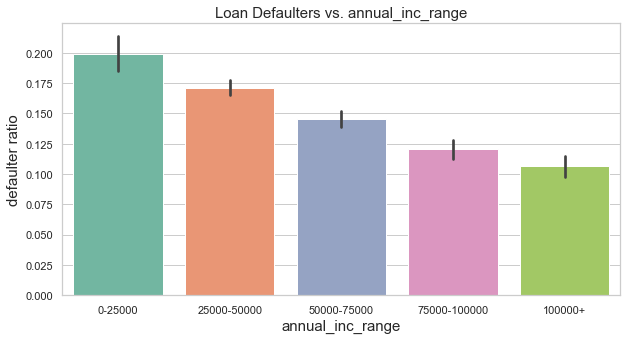

In [162]:
print_barplot('annual_inc_range')

Obserwacje: Im wyższy przychód roczny, tym niższe ryzyko niespłacenia pożyczki.

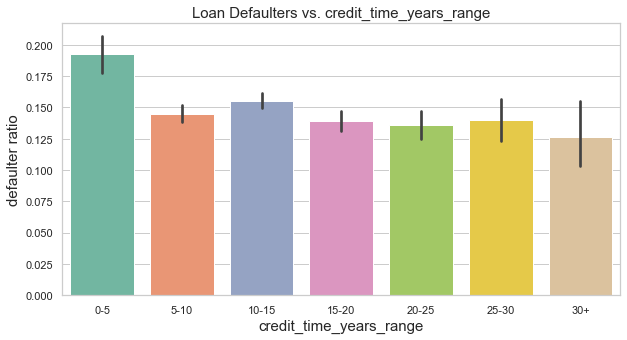

In [163]:
print_barplot('credit_time_years_range')

Obserwacje: Wraz z dłuższym wiekiem kredytowym spada ryzyko niespłacenia pożyczki, ale nie jest to zależność liniowa. Największe ryzyko istnieje do 5 lat wieku kredytowego.

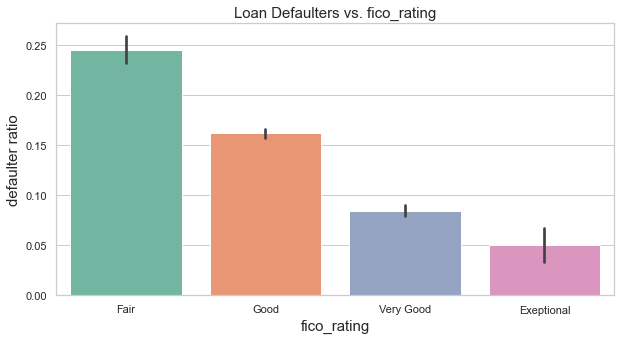

In [164]:
print_barplot('fico_rating', order=['Fair', 'Good', 'Very Good', 'Exeptional'])

Obserwacje: Im lepszy rating fico, tym niższe ryzyko niespłacenia pożyczki. 

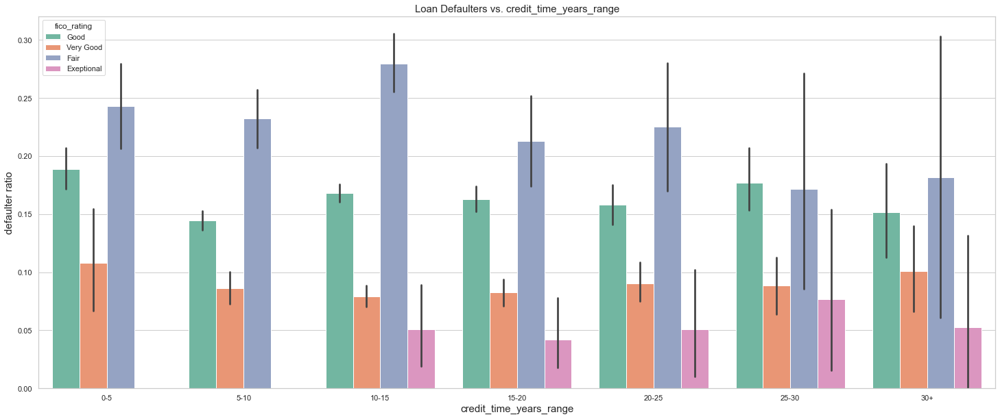

In [165]:
print_barplotof2_ratio('credit_time_years_range','fico_rating', figsize = (25,10))

Obserwacje: Tendencje zaobserwowane na powyższym wykresie są aktualne dla wszystkich zakresów wieku kredytowego, prócz 25-30 lat, gdzie ryzyko niespłacenia było podobne dla grup z ratingiem Good i Fair.

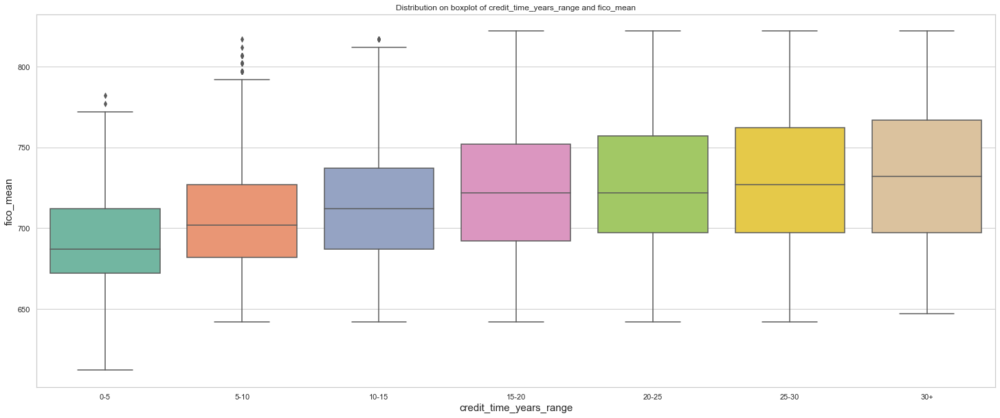

In [167]:
print_boxplotof2('credit_time_years_range','fico_mean', figsize = (25,10))

Obserwacje: Ocena fico rośnie wraz z wiekiem kredytowym.

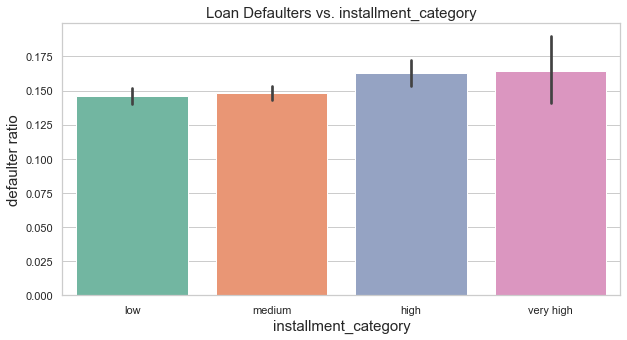

In [168]:
print_barplot('installment_category')

Obserwacje: Ryzyko niespłacenia pożyczki jest podobne dla niskich i śrenich opłąt miesięcznych oraz dla wysokich i bardzo wysokich (dla tych grup to ryzyko jest wyższe).

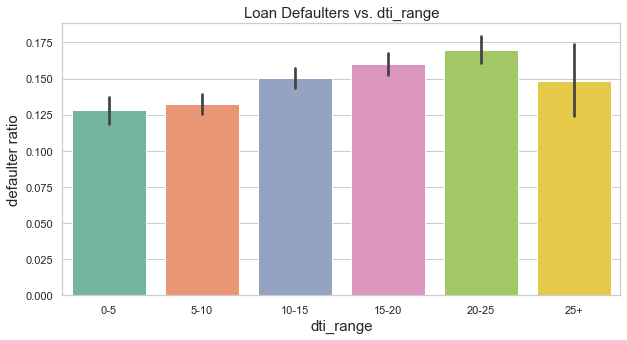

In [169]:
print_barplot('dti_range')

Obserwacje: Wraz ze wskaźnikiem dti rośnie ryzyko niespłacenia pożyczki, z wyjątkiem jego wielkosci powyżej 25, gdzie ryzyko jest podobne, co dla wartości 10-15.

## Prawdopodobieństwo

In [129]:
def probability(feature, data=data_eda_outliers_removed):
    
    crosstab = pd.crosstab(data[feature], data['loan_status'],margins=True)
    crosstab['Probability_loan_default[%]'] = round((crosstab[0]/crosstab['All']),3)*100
    crosstab['Probability_loan_paid[%]'] = round((crosstab[1]/crosstab['All']),3)*100
    crosstab = crosstab[0:-1]
    return crosstab


In [171]:
probability('loan_amnt_range')

loan_status,0,1,All,Probability_loan_default[%],Probability_loan_paid[%]
loan_amnt_range,,,,,
0-5000,1497,8671,10168,14.7,85.3
5000-10000,1842,11497,13339,13.8,86.2
10000-15000,1134,6877,8011,14.2,85.8
15000-20000,765,3748,4513,17.0,83.0
20000-25000,541,2321,2862,18.9,81.1
25000+,146,562,708,20.6,79.4


In [172]:
probability('fico_rating')

loan_status,0,1,All,Probability_loan_default[%],Probability_loan_paid[%]
fico_rating,,,,,
Exeptional,27,513,540,5.0,95.0
Fair,900,2779,3679,24.5,75.5
Good,4215,21884,26099,16.2,83.8
Very Good,783,8500,9283,8.4,91.6


In [173]:
probability('credit_time_years_range')

loan_status,0,1,All,Probability_loan_default[%],Probability_loan_paid[%]
credit_time_years_range,,,,,
0-5,532,2224,2756,19.3,80.7
5-10,1480,8735,10215,14.5,85.5
10-15,2156,11722,13878,15.5,84.5
15-20,1009,6243,7252,13.9,86.1
20-25,462,2935,3397,13.6,86.4
25-30,205,1259,1464,14.0,86.0
30+,81,558,639,12.7,87.3


In [174]:
probability('home_ownership')

loan_status,0,1,All,Probability_loan_default[%],Probability_loan_paid[%]
home_ownership,,,,,
MORTGAGE,2359,14578,16937,13.9,86.1
NONE,1,3,4,25.0,75.0
OTHER,29,103,132,22.0,78.0
OWN,452,2556,3008,15.0,85.0
RENT,3084,16436,19520,15.8,84.2


In [175]:
probability('annual_inc_range')

loan_status,0,1,All,Probability_loan_default[%],Probability_loan_paid[%]
annual_inc_range,,,,,
0-25000,564,2268,2832,19.9,80.1
25000-50000,2356,11434,13790,17.1,82.9
50000-75000,1773,10436,12209,14.5,85.5
75000-100000,733,5339,6072,12.1,87.9
100000+,499,4199,4698,10.6,89.4


In [176]:
probability('emp_length')

loan_status,0,1,All,Probability_loan_default[%],Probability_loan_paid[%]
emp_length,,,,,
0,215,734,949,22.7,77.3
1,1229,6992,8221,14.9,85.1
2,622,3883,4505,13.8,86.2
3,599,3559,4158,14.4,85.6
4,484,2984,3468,14.0,86.0
5,475,2790,3265,14.5,85.5
6,331,1909,2240,14.8,85.2
7,269,1482,1751,15.4,84.6
8,218,1239,1457,15.0,85.0


In [177]:
probability('installment_category')

loan_status,0,1,All,Probability_loan_default[%],Probability_loan_paid[%]
installment_category,,,,,
high,848,4362,5210,16.3,83.7
low,2038,11910,13948,14.6,85.4
medium,2885,16620,19505,14.8,85.2
very high,154,784,938,16.4,83.6


In [178]:
probability('dti_range')

loan_status,0,1,All,Probability_loan_default[%],Probability_loan_paid[%]
dti_range,,,,,
0-5,642,4373,5015,12.8,87.2
5-10,1059,6933,7992,13.3,86.7
10-15,1478,8370,9848,15.0,85.0
15-20,1446,7579,9025,16.0,84.0
20-25,1153,5625,6778,17.0,83.0
25+,110,633,743,14.8,85.2


In [179]:
probability('grade')

loan_status,0,1,All,Probability_loan_default[%],Probability_loan_paid[%]
grade,,,,,
A,577,9093,9670,6.0,94.0
B,1435,10259,11694,12.3,87.7
C,1406,6806,8212,17.1,82.9
D,1240,4318,5558,22.3,77.7
E,796,2196,2992,26.6,73.4
F,344,747,1091,31.5,68.5
G,127,257,384,33.1,66.9


In [180]:
probability('purpose')

loan_status,0,1,All,Probability_loan_default[%],Probability_loan_paid[%]
purpose,,,,,
car,166,1382,1548,10.7,89.3
credit_card,568,4528,5096,11.1,88.9
debt_consolidation,2841,15564,18405,15.4,84.6
educational,84,314,398,21.1,78.9
home_improvement,377,2496,2873,13.1,86.9
house,64,329,393,16.3,83.7
major_purchase,239,1956,2195,10.9,89.1
medical,119,588,707,16.8,83.2
moving,103,506,609,16.9,83.1


In [181]:
probability('term')

loan_status,0,1,All,Probability_loan_default[%],Probability_loan_paid[%]
term,,,,,
36,3627,26045,29672,12.2,87.8
60,2298,7631,9929,23.1,76.9


In [182]:
probability('pub_rec_bankruptcies')

loan_status,0,1,All,Probability_loan_default[%],Probability_loan_paid[%]
pub_rec_bankruptcies,,,,,
0.0,5510,32317,37827,14.6,85.4
1.0,413,1354,1767,23.4,76.6
2.0,2,5,7,28.6,71.4


In [183]:
probability('pub_rec')

loan_status,0,1,All,Probability_loan_default[%],Probability_loan_paid[%]
pub_rec,,,,,
0.0,5388,31939,37327,14.4,85.6
1.0,525,1677,2202,23.8,76.2
2.0,12,47,59,20.3,79.7
3.0,0,10,10,0.0,100.0
4.0,0,2,2,0.0,100.0
5.0,0,1,1,0.0,100.0


In [130]:
states=probability('addr_state')
probability('addr_state')

loan_status,0,1,All,Probability_loan_default[%],Probability_loan_paid[%]
addr_state,,,,,
AK,16,61,77,20.8,79.2
AL,57,384,441,12.9,87.1
AR,33,218,251,13.1,86.9
AZ,133,745,878,15.1,84.9
CA,1133,5790,6923,16.4,83.6
CO,98,701,799,12.3,87.7
CT,96,637,733,13.1,86.9
DC,15,192,207,7.2,92.8
DE,15,110,125,12.0,88.0


In [131]:
states.index

Index(['AK', 'AL', 'AR', 'AZ', 'CA', 'CO', 'CT', 'DC', 'DE', 'FL', 'GA', 'HI',
       'IA', 'ID', 'IL', 'IN', 'KS', 'KY', 'LA', 'MA', 'MD', 'ME', 'MI', 'MN',
       'MO', 'MS', 'MT', 'NC', 'NE', 'NH', 'NJ', 'NM', 'NV', 'NY', 'OH', 'OK',
       'OR', 'PA', 'RI', 'SC', 'SD', 'TN', 'TX', 'UT', 'VA', 'VT', 'WA', 'WI',
       'WV', 'WY'],
      dtype='object', name='addr_state')

In [132]:
import chart_studio.plotly as py
import plotly.graph_objs as go
from plotly import tools
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)

In [133]:
data = [ dict(
        type='choropleth',
        #colorscale = scl,
        autocolorscale = True,
        locations = states.index,
        z = states['Probability_loan_default[%]'], 
        locationmode = 'USA-states',
        #text = states['Probability_loan_default[%]'],
        marker = dict(
            line = dict (
                color = 'rgb(255,255,255)',
                width = 2
            ) ),
        colorbar = dict(
            title = 'Probability_loan_default[%]')
        ) ]

layout = dict(
        title = 'The probability of loan default by state',
        geo = dict(
            scope='usa',
            projection=dict( type='albers usa' ),
            showlakes = True,
            lakecolor = 'rgb(255, 255, 255)'),
             )
    
fig = dict( data=data, layout=layout )
iplot( fig, filename='d3-cloropleth-map' )

## Testy statystyczne

In [187]:
#Statistical tests     
paid = data_eda_outliers_removed[data_eda_outliers_removed['loan_status']==1]
defaulted = data_eda_outliers_removed[data_eda_outliers_removed['loan_status']==0]

### zmienne ciągłe - sprawdzam, czy różnice są istotne statystycznie dla grup pożyczkobiorców (loan_status = 0/1) na poziomie istotności = 0,05 - test T-Studenta

In [188]:
#fico_mean vs.Loan_status
#H0: średni wynik fico_mean dla osób spłacających i niespłacających pożyczki jest taki sam
#H1: średni wynik fico_mean dla osób spłacających i niespłacających pożyczki nie jest taki sam

from scipy.stats import ttest_ind
stat, p = ttest_ind(paid['fico_mean'], defaulted['fico_mean'])
print('stat=%.3f, p=%.200f' % (stat, p))
if p > 0.05:
    print('Probably the same mean of fico_mean score for paid and deafulted loans')
else:
    print('Probably different mean of fico_mean score for paid and deafulted loans')

stat=28.843, p=0.00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000047232604180846158775
Probably different mean of fico_mean score for paid and deafulted loans


In [189]:
#loan_amnt vs.Loan_status
#H0: średnia wielkość pożyczki dla osób spłacających i niespłacających pożyczki jest taka sama
#H1: średnia wielkość pożyczki dla osób spłacających i niespłacających pożyczki nie jest taka sama

from scipy.stats import ttest_ind
stat, p = ttest_ind(paid['loan_amnt'], defaulted['loan_amnt'])
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
    print('Probably the same mean of loan_amnt for paid and deafulted loans')
else:
    print('Probably different mean of loan_amnt for paid and deafulted loans')

stat=-7.055, p=0.000
Probably different mean of loan_amnt for paid and deafulted loans


In [190]:
#credit_time vs.Loan_status
#H0: średni wiek kredytowy dla osób spłacających i niespłacających pożyczki jest taki sam
#H1: średni wiek kredytowy dla osób spłacających i niespłacających pożyczki nie jest taki sam

from scipy.stats import ttest_ind
stat, p = ttest_ind(paid['credit_time'], defaulted['credit_time'])
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
    print('Probably the same mean of credit time for paid and deafulted loans')
else:
    print('Probably different mean of credit time for paid and deafulted loans')

stat=5.107, p=0.000
Probably different mean of credit time for paid and deafulted loans


In [191]:
#annual_inc vs.Loan_status
#H0: średni roczny dochód dla osób spłacających i niespłacających pożyczki jest taki sam
#H1: średni roczny dochód dla osób spłacających i niespłacających pożyczki nie jest taki sam

from scipy.stats import ttest_ind
stat, p = ttest_ind(paid['annual_inc'], defaulted['annual_inc'])
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
    print('Probably the same mean of annual_inc for paid and deafulted loans')
else:
    print('Probably different mean of annual_inc for paid and deafulted loans')

stat=13.553, p=0.000
Probably different mean of annual_inc for paid and deafulted loans


In [192]:
#int_rate vs.Loan_status
#H0: interest rate dla osób spłacających i niespłacających pożyczki jest taki sam
#H1: interest rate dochód dla osób spłacających i niespłacających pożyczki nie jest taki sam

from scipy.stats import ttest_ind
stat, p = ttest_ind(paid['int_rate'], defaulted['int_rate'])
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
    print('Probably the same mean of int_rate for paid and deafulted loans')
else:
    print('Probably different mean of int_rate for paid and deafulted loans')

stat=-40.754, p=0.000
Probably different mean of int_rate for paid and deafulted loans


In [193]:
#installment vs.Loan_status
#H0: średnia wielkość miesięcznej raty pożyczki dla osób spłacających i niespłacających pożyczki jest taka sam
#H1: średnia wielkość miesięcznej raty pożyczki dla osób spłacających i niespłacających pożyczki nie jest taka sama

from scipy.stats import ttest_ind
stat, p = ttest_ind(paid['installment'], defaulted['installment'])
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
    print('Probably the same mean of installment for paid and deafulted loans')
else:
    print('Probably different mean of installment for paid and deafulted loans')

stat=-2.680, p=0.007
Probably different mean of installment for paid and deafulted loans


In [194]:
#emp_length vs.Loan_status
#H0: średnia długość zatrudnienia dla osób spłacających i niespłacających pożyczki jest taka sama
#H1: średnia długość zatrudnienia dla osób spłacających i niespłacających pożyczki nie jest taka sama

from scipy.stats import ttest_ind
stat, p = ttest_ind(paid['emp_length'], defaulted['emp_length'])
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
    print('Probably the same mean of emp_length for paid and deafulted loans')
else:
    print('Probably different mean of emp_length for paid and deafulted loans')

stat=-0.612, p=0.540
Probably the same mean of emp_length for paid and deafulted loans


In [195]:
#dti vs.Loan_status
#H0: średnia wielkość współczynnika dti dla osób spłacających i niespłacających pożyczki jest taka sama
#H1: średnia wielkość współczynnika dti dla osób spłacających i niespłacających pożyczki nie jest taka sama

from scipy.stats import ttest_ind
stat, p = ttest_ind(paid['dti'], defaulted['dti'])
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
    print('Probably the same mean of dti for paid and deafulted loans')
else:
    print('Probably different mean of dti for paid and deafulted loans')

stat=-7.934, p=0.000
Probably different mean of dti for paid and deafulted loans


In [196]:
#delinq_2yrs vs.Loan_status
#H0: średnia liczba przypadków opóźnienia o ponad 30 dni w ciągu ostatnich 2 lat dla osób spłacających i niespłacających pożyczki jest taka sama
#H1: średnia liczba przypadków opóźnienia o ponad 30 dni w ciągu ostatnich 2 lat dla osób spłacających i niespłacających pożyczki nie jest taka sama

from scipy.stats import ttest_ind
stat, p = ttest_ind(paid['delinq_2yrs'], defaulted['delinq_2yrs'])
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
    print('Probably the same mean of delinq_2yrs for paid and deafulted loans')
else:
    print('Probably different mean of delinq_2yrs for paid and deafulted loans')

stat=-4.081, p=0.000
Probably different mean of delinq_2yrs for paid and deafulted loans


In [197]:
#inq_last_6mths vs.Loan_status
#H0: średnia liczba zapytań w ciągu ostatnich 6 miesięcy dla osób spłacających i niespłacających pożyczki jest taka sama
#H1: średnia liczba zapytań w ciągu ostatnich 6 miesięcy dla osób spłacających i niespłacających pożyczki nie jest taka sama

from scipy.stats import ttest_ind
stat, p = ttest_ind(paid['inq_last_6mths'], defaulted['inq_last_6mths'])
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
    print('Probably the same mean of inq_last_6mths for paid and deafulted loans')
else:
    print('Probably different mean of inq_last_6mths for paid and deafulted loans')

stat=-21.973, p=0.000
Probably different mean of inq_last_6mths for paid and deafulted loans


In [198]:
#open_acc vs.Loan_status
#H0: średnia liczba przypadków opóźnienia o ponad 30 dni w ciągu ostatnich 2 lat dla osób spłacających i niespłacających pożyczki jest taka sama
#H1: średnia liczba przypadków opóźnienia o ponad 30 dni w ciągu ostatnich 2 lat dla osób spłacających i niespłacających pożyczki nie jest taka sama

from scipy.stats import ttest_ind
stat, p = ttest_ind(paid['open_acc'], defaulted['open_acc'])
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
    print('Probably the same mean of open_acc for paid and deafulted loans')
else:
    print('Probably different mean of open_acc for paid and deafulted loans')

stat=2.854, p=0.004
Probably different mean of open_acc for paid and deafulted loans


In [199]:
#pub_rec vs.Loan_status
#H0: średnia liczba negatywnych wpisów w rejestrze dla osób spłacających i niespłacających pożyczki jest taka sama
#H1: średnia liczba negatywnych wpisów w rejestrze dla osób spłacających i niespłacających pożyczki nie jest taka sama

from scipy.stats import ttest_ind
stat, p = ttest_ind(paid['pub_rec'], defaulted['pub_rec'])
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
    print('Probably the same mean of pub_rec for paid and deafulted loans')
else:
    print('Probably different mean of pub_rec for paid and deafulted loans')

stat=-11.101, p=0.000
Probably different mean of pub_rec for paid and deafulted loans


In [200]:
#total_acc vs.Loan_status
#H0: średnia liczba otwartych linii kredytowych dla osób spłacających i niespłacających pożyczki jest taka sama
#H1: średnia liczba otwartych linii kredytowych dla osób spłacających i niespłacających pożyczki nie jest taka sama

from scipy.stats import ttest_ind
stat, p = ttest_ind(paid['total_acc'], defaulted['total_acc'])
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
    print('Probably the same mean of total_acc for paid and deafulted loans')
else:
    print('Probably different mean of total_acc for paid and deafulted loans')

stat=5.396, p=0.000
Probably different mean of total_acc for paid and deafulted loans


In [201]:
#revol_bal vs.Loan_status
#H0: średnie saldo odnawialne kredytu dla osób spłacających i niespłacających pożyczki jest takie same
#H1: średnie saldo odnawialne kredytu dla osób spłacających i niespłacających pożyczki nie jest takie same

from scipy.stats import ttest_ind
stat, p = ttest_ind(paid['revol_bal'], defaulted['revol_bal'])
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
    print('Probably the same mean of revol_bal for paid and deafulted loans')
else:
    print('Probably different mean of revol_bal for paid and deafulted loans')

stat=-0.303, p=0.762
Probably the same mean of revol_bal for paid and deafulted loans


In [202]:
#revol_util vs.Loan_status
#H0: średni stosunek wykorzystania kredytu do jego całości dla osób spłacających i niespłacających pożyczki jest taki sam
#H1: średni stosunek wykorzystania kredytu do jego całości dla osób spłacających i niespłacających pożyczki nie jest taki sam

from scipy.stats import ttest_ind
stat, p = ttest_ind(paid['revol_util'], defaulted['revol_util'])
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
    print('Probably the same mean of revol_util for paid and deafulted loans')
else:
    print('Probably different mean of revol_util for paid and deafulted loans')

stat=-18.835, p=0.000
Probably different mean of revol_util for paid and deafulted loans


### zmienne kategoryczne - sprawdzam, czy dwie zmienne kategoryczne są zeleżne czy niezależne od poszczególnych zmiennych kategorycznych na poziomie istotności = 0,05 - test chi2

In [203]:
# Chi-squared test with similar proportions
from scipy.stats import chi2_contingency
from scipy.stats import chi2
contingency_table=pd.crosstab(data_eda_outliers_removed['term'],data_eda_outliers_removed['loan_status'])

stat, p, dof, expected = chi2_contingency(contingency_table)
print('stat=%.3f, p=%.3f' % (stat, p))
if p <= 0.05:
    print('Dependent (reject H0)')
else:
    print('Independent (fail to reject H0)')

stat=696.489, p=0.000
Dependent (reject H0)


In [204]:
from scipy.stats import chi2_contingency
from scipy.stats import chi2
contingency_table=pd.crosstab(data_eda_outliers_removed['grade'],data_eda_outliers_removed['loan_status'])

stat, p, dof, expected = chi2_contingency(contingency_table)
print('stat=%.3f, p=%.3f' % (stat, p))
if p <= 0.05:
    print('Dependent (reject H0)')
else:
    print('Independent (fail to reject H0)')

stat=1600.603, p=0.000
Dependent (reject H0)


In [205]:
from scipy.stats import chi2_contingency
from scipy.stats import chi2
contingency_table=pd.crosstab(data_eda_outliers_removed['sub_grade'],data_eda_outliers_removed['loan_status'])

stat, p, dof, expected = chi2_contingency(contingency_table)
print('stat=%.3f, p=%.3f' % (stat, p))
if p <= 0.05:
    print('Dependent (reject H0)')
else:
    print('Independent (fail to reject H0)')

stat=1703.834, p=0.000
Dependent (reject H0)


In [206]:
from scipy.stats import chi2_contingency
from scipy.stats import chi2
contingency_table=pd.crosstab(data_eda_outliers_removed['home_ownership'],data_eda_outliers_removed['loan_status'])

stat, p, dof, expected = chi2_contingency(contingency_table)
print('stat=%.3f, p=%.3f' % (stat, p))
if p <= 0.05:
    print('Dependent (reject H0)')
else:
    print('Independent (fail to reject H0)')

stat=30.404, p=0.000
Dependent (reject H0)


In [207]:
from scipy.stats import chi2_contingency
from scipy.stats import chi2
contingency_table=pd.crosstab(data_eda_outliers_removed['verification_status'],data_eda_outliers_removed['loan_status'])

stat, p, dof, expected = chi2_contingency(contingency_table)
print('stat=%.3f, p=%.3f' % (stat, p))
if p <= 0.05:
    print('Dependent (reject H0)')
else:
    print('Independent (fail to reject H0)')

stat=34.137, p=0.000
Dependent (reject H0)


In [208]:
from scipy.stats import chi2_contingency
from scipy.stats import chi2
contingency_table=pd.crosstab(data_eda_outliers_removed['purpose'],data_eda_outliers_removed['loan_status'])

stat, p, dof, expected = chi2_contingency(contingency_table)
print('stat=%.3f, p=%.3f' % (stat, p))
if p <= 0.05:
    print('Dependent (reject H0)')
else:
    print('Independent (fail to reject H0)')

stat=367.885, p=0.000
Dependent (reject H0)


In [209]:
from scipy.stats import chi2_contingency
from scipy.stats import chi2
contingency_table=pd.crosstab(data_eda_outliers_removed['desc'],data_eda_outliers_removed['loan_status'])

stat, p, dof, expected = chi2_contingency(contingency_table)
print('stat=%.3f, p=%.3f' % (stat, p))
if p <= 0.05:
    print('Dependent (reject H0)')
else:
    print('Independent (fail to reject H0)')

stat=7.315, p=0.026
Dependent (reject H0)


In [210]:
from scipy.stats import chi2_contingency
from scipy.stats import chi2
contingency_table=pd.crosstab(data_eda_outliers_removed['addr_state'],data_eda_outliers_removed['loan_status'])

stat, p, dof, expected = chi2_contingency(contingency_table)
print('stat=%.3f, p=%.3f' % (stat, p))
if p <= 0.05:
    print('Dependent (reject H0)')
else:
    print('Independent (fail to reject H0)')

stat=172.827, p=0.000
Dependent (reject H0)


In [211]:
from scipy.stats import chi2_contingency
from scipy.stats import chi2
contingency_table=pd.crosstab(data_eda_outliers_removed['acc_now_delinq'],data_eda_outliers_removed['loan_status'])

stat, p, dof, expected = chi2_contingency(contingency_table)
print('stat=%.3f, p=%.3f' % (stat, p))
if p <= 0.05:
    print('Dependent (reject H0)')
else:
    print('Independent (fail to reject H0)')

stat=0.007, p=0.934
Independent (fail to reject H0)


In [212]:
from scipy.stats import chi2_contingency
from scipy.stats import chi2
contingency_table=pd.crosstab(data_eda_outliers_removed['pub_rec_bankruptcies'],data_eda_outliers_removed['loan_status'])

stat, p, dof, expected = chi2_contingency(contingency_table)
print('stat=%.3f, p=%.3f' % (stat, p))
if p <= 0.05:
    print('Dependent (reject H0)')
else:
    print('Independent (fail to reject H0)')

stat=103.923, p=0.000
Dependent (reject H0)


In [213]:
from scipy.stats import chi2_contingency
from scipy.stats import chi2
contingency_table=pd.crosstab(data_eda_outliers_removed['tax_liens'],data_eda_outliers_removed['loan_status'])

stat, p, dof, expected = chi2_contingency(contingency_table)
print('stat=%.3f, p=%.3f' % (stat, p))
if p <= 0.05:
    print('Dependent (reject H0)')
else:
    print('Independent (fail to reject H0)')

stat=0.965, p=0.326
Independent (fail to reject H0)


In [214]:
from scipy.stats import chi2_contingency
from scipy.stats import chi2
contingency_table=pd.crosstab(data_eda_outliers_removed['issue_year'],data_eda_outliers_removed['loan_status'])

stat, p, dof, expected = chi2_contingency(contingency_table)
print('stat=%.3f, p=%.3f' % (stat, p))
if p <= 0.05:
    print('Dependent (reject H0)')
else:
    print('Independent (fail to reject H0)')

stat=115.872, p=0.000
Dependent (reject H0)


In [215]:
from scipy.stats import chi2_contingency
from scipy.stats import chi2
contingency_table=pd.crosstab(data_eda_outliers_removed['issue_month'],data_eda_outliers_removed['loan_status'])

stat, p, dof, expected = chi2_contingency(contingency_table)
print('stat=%.3f, p=%.3f' % (stat, p))
if p <= 0.05:
    print('Dependent (reject H0)')
else:
    print('Independent (fail to reject H0)')

stat=19.355, p=0.055
Independent (fail to reject H0)


In [216]:
from scipy.stats import chi2_contingency
from scipy.stats import chi2
contingency_table=pd.crosstab(data_eda_outliers_removed['fico_mean'],data_eda_outliers_removed['credit_time'])

stat, p, dof, expected = chi2_contingency(contingency_table)
print('stat=%.3f, p=%.3f' % (stat, p))
if p <= 0.05:
    print('Dependent (reject H0)')
else:
    print('Independent (fail to reject H0)')

stat=126597.174, p=0.000
Dependent (reject H0)


In [217]:
from scipy.stats import chi2_contingency
from scipy.stats import chi2
contingency_table=pd.crosstab(data_outliers_removed['home_ownership_MORTGAGE'],data_outliers_removed['loan_status'])

stat, p, dof, expected = chi2_contingency(contingency_table)
print('stat=%.3f, p=%.3f' % (stat, p))
if p <= 0.05:
    print('Dependent (reject H0)')
else:
    print('Independent (fail to reject H0)')

stat=24.710, p=0.000
Dependent (reject H0)


In [218]:
from scipy.stats import chi2_contingency
from scipy.stats import chi2
contingency_table=pd.crosstab(data_outliers_removed['emp_length'],data_outliers_removed['loan_status'])

stat, p, dof, expected = chi2_contingency(contingency_table)
print('stat=%.3f, p=%.3f' % (stat, p))
if p <= 0.05:
    print('Dependent (reject H0)')
else:
    print('Independent (fail to reject H0)')

stat=60.267, p=0.000
Dependent (reject H0)


## Analiza wielu zmiennych

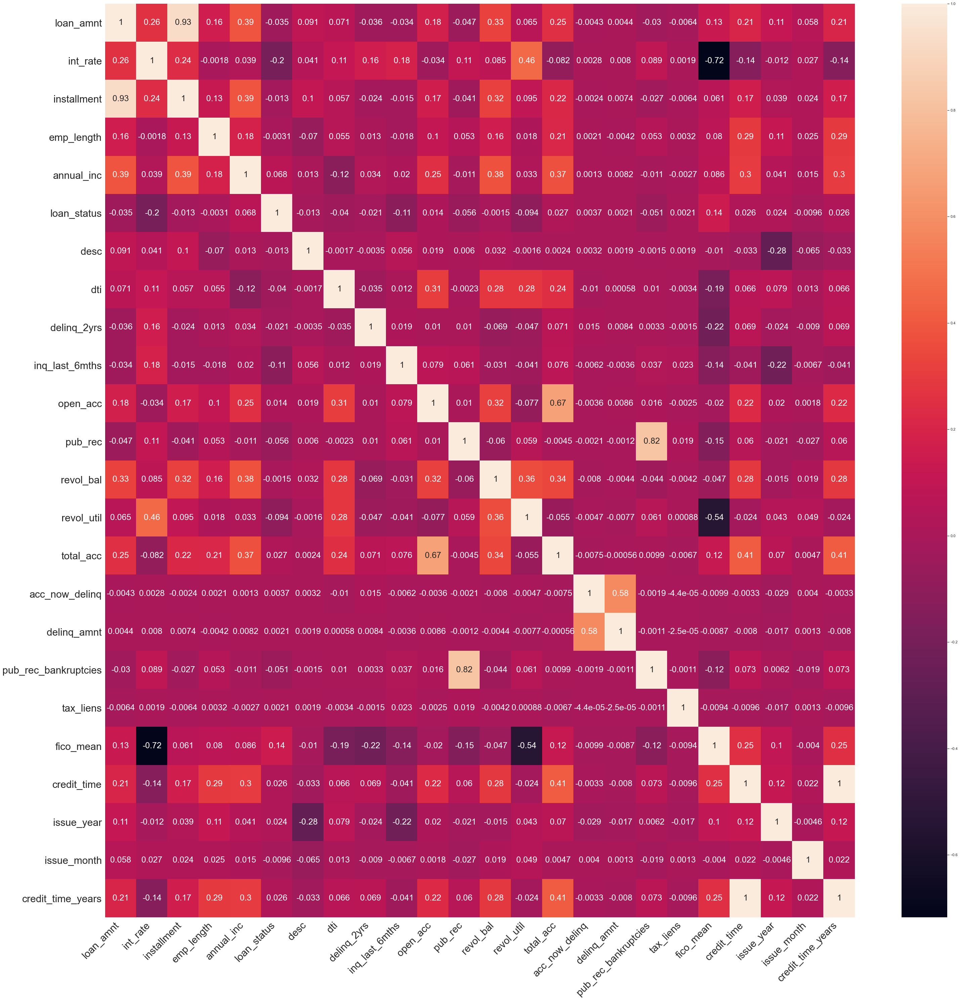

In [219]:
#Correlation matrix
plt.figure(figsize = (50,50))       
plt.rcParams["font.size"] = "25"
ax=sns.heatmap(data_eda_outliers_removed.corr(),annot = True)
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right',
    fontsize = 30);
ax.set_yticklabels(
    ax.get_yticklabels(),
    rotation=0,
    fontsize = 30);

#z takiej ogólnej korelacji widać, że loan_status jest wprost skorelowany z FICO_mean ze wsp 0.14, oraz odwrotnie z
#term (-0.13), int_rate (-0.2) oraz inq_last_6mths (-0.11)
#widać, że kilka parametrów silnie ze sobą koreluje, widać, że to są naturalne zależności, jak kwota pożyczki 
#z miesięczną kwotą do zapłaty, czy ocena z int_rate - takie zależności pozwolą wybrać np. tylko jedną z silnie skorelowanych zmiennych
#do modelu


In [220]:
#robiłam też pairplot, ale bardzo długo się ładuje, a obserwacje potwierdzają liczby z macierzy korelacji, zatem 
#nie ma konieczności go tu umieszczać

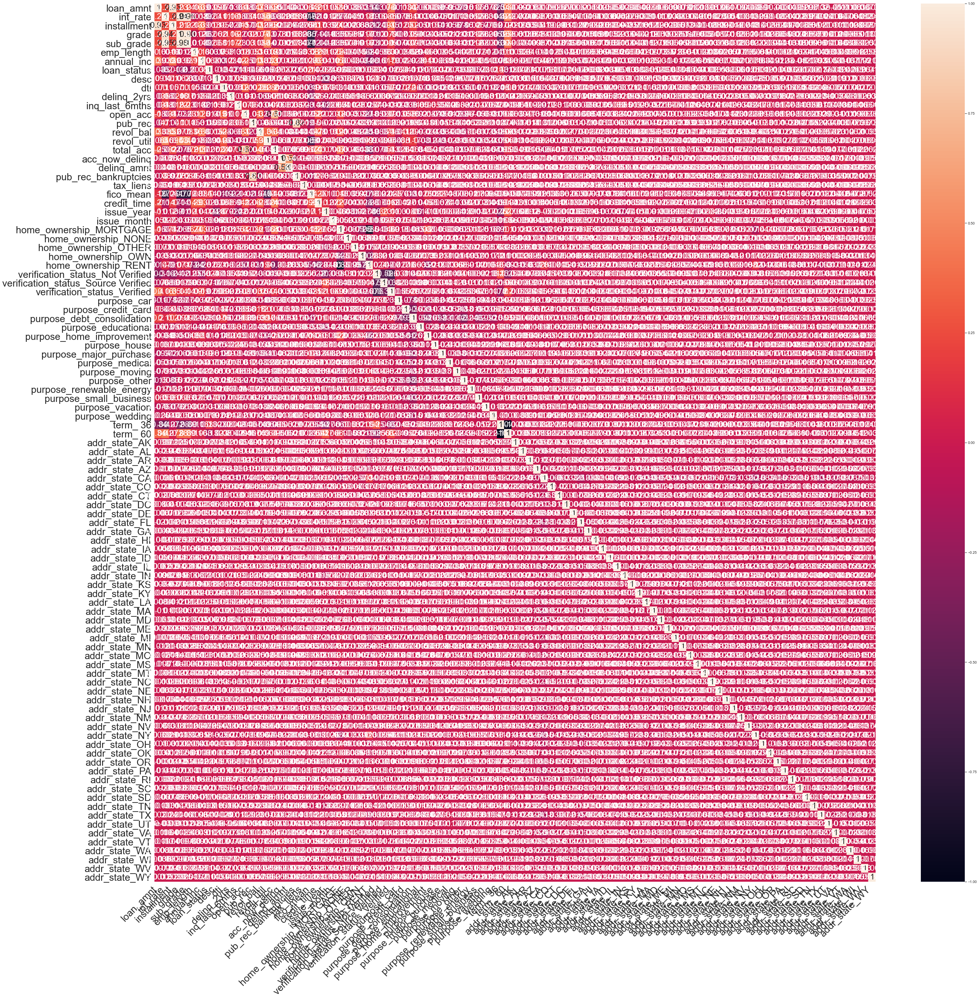

In [221]:
#Correlation - all_features
plt.figure(figsize = (50,50))       
plt.rcParams["font.size"] = "25"
ax=sns.heatmap(data_outliers_removed.corr(),annot = True)
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right',
    fontsize = 30);
ax.set_yticklabels(
    ax.get_yticklabels(),
    fontsize = 30);


#zobaczyłam jeszcze jak to wygląda na danych, gdzie wszystkie zmienne są numeryczne, i może widać jeszcze jakieś korelacje,
#ale prawie nic nie widać na takiej mapie, bo jest ponad 100 zmiennych, trzeba to sprawdzić liczbowo

In [222]:
#jakie zmienne są najbardziej ze sobą skorelowane?
correlation_mat = data_outliers_removed.corr()
corr_pairs = correlation_mat.unstack()
#print(corr_pairs)
sorted_pairs = corr_pairs.sort_values(kind="quicksort")
#print(sorted_pairs)
negative_pairs = sorted_pairs[sorted_pairs < 0]
#print(negative_pairs)
strong_pairs = sorted_pairs[(abs(sorted_pairs) > 0.5) & (abs(sorted_pairs) <1)]
print(strong_pairs)

home_ownership_RENT                  home_ownership_MORTGAGE               -0.852309
home_ownership_MORTGAGE              home_ownership_RENT                   -0.852309
fico_mean                            sub_grade                             -0.718968
sub_grade                            fico_mean                             -0.718968
fico_mean                            int_rate                              -0.717597
int_rate                             fico_mean                             -0.717597
grade                                fico_mean                             -0.701710
fico_mean                            grade                                 -0.701710
verification_status_Not Verified     verification_status_Verified          -0.597204
verification_status_Verified         verification_status_Not Verified      -0.597204
fico_mean                            revol_util                            -0.541344
revol_util                           fico_mean                   

In [223]:
#jakie zmienne są najbardziej skorelowane z targetem?
sorted_pairs['loan_status']

sub_grade             -0.203610
int_rate              -0.200636
grade                 -0.200218
term_ 60              -0.132700
inq_last_6mths        -0.109751
                         ...   
purpose_credit_card    0.041111
annual_inc             0.067949
term_ 36               0.132700
fico_mean              0.143442
loan_status            1.000000
Length: 99, dtype: float64

## Wnioski z EDA

Na podstawie EDA - wykresów i testów statystycznych istotne kolumny to: 
'loan_amnt', 'term', 'int_rate', 'installment', 'grade', 'sub_grade', 'home_ownership', 'annual_inc', 'verification_status', 'loan_status', 'desc', 'purpose', 'addr_state', 'dti','delinq_2yrs', 'earliest_cr_line', 'inq_last_6mths', 'open_acc','pub_rec', 'revol_util', 'total_acc', 'pub_rec_bankruptcies', 'fico_mean','credit_time', 'issue_year',    
       
Na podstawie wykresów i testów statystycznych nieistotne kolumny to: 'issue_month', 'tax_liens', 'acc_now_delinq', 'delinq_amnt', 'revol_bal', 'emp_length','issue_month'

Do usunięcia są również kolumny earliest_cr_lin, issue_d - informacje, które ona dają zostały wykorzystane przy tworzeniu zmiennej credit_time

Wśród istotych wysoko skorelowane ze sobą są wprost: loan_amnt z installment (0.93), pub_rec z pub_rec_bankruptcies(0.82),total_acc z open_acc (0.67), a także odwrotnie: fico_mean z int_rate (-0.72), fico_mean z revol_util (-0.54), sub_grade z grade (0.98), stąd można pominąć niektóre z nich, by nie dublować informacji.

Przeznaczam więc do usunięcia: installment, pub_rec_bankruptcies, grade. W przypadku korelacji korelacji mniejszej niż 0.8 nie usuwam zmiennych.

### Pytania zawarte w treści projektu

a.W jaki sposób wynik FICO wiąże się z prawdopodobieństwem spłacenia pożyczki przez pożyczkobiorcę?

W ogólności: im wyższy wynik Fico, tym większe prawdopodobieństwo spłacenia pożyczki.

Fico rating 'Exeptional' wiąże się z 95-procentowym prawdopodobieństwem spłacenia pożyczki i 5-procentowym prawdopodobieństwem niespłacenia.
Fico rating 'Very Good' wiąże się z 91,6-procentowym  prawdopodobieństwem spłacenia pożyczki i 8.4-procentowym prawdopodobieństwem niespłacenia.
Fico rating 'Good' wiąże się z 83.8-procentowym  prawdopodobieństwem spłacenia pożyczki i 16.2-procentowym prawdopodobieństwem niespłacenia.
Fico rating 'Fair' wiąże się z 75.5%-procentowym  prawdopodobieństwem spłacenia pożyczki i 24.5-procentowym prawdopodobieństwem niespłacenia.

Współczynnik korelacji Fico_mean z targetem wynosi 0.14. 

b.W jaki sposób wiek kredytowy wiąże się z prawdopodobieństwem niewykonania zobowiązania i czy ryzyko to jest niezależne lub związane z wynikiem FICO?

W ogólności: im większy wiek kredytowy, tym mniejsze prawdopodobieństwo niewykonania zobowiązania (większe prawdopodobieństwo spłacenia pożyczki), natomiast największe różnice w tym prawdopodobieństwie występują między okresem do 5 lat, a resztą.

Wiek kredytowy miedzy 0-5 lat wiąże się z 80.6-procentowym prawdopodobieństwem spłacenia pożyczki i 19.4-procentowym prawdopodobieństwem niespłacenia.
Wiek kredytowy miedzy 5-10 lat wiąże się z 85.5-procentowym prawdopodobieństwem spłacenia pożyczki i 14.5-procentowym prawdopodobieństwem niespłacenia.
Wiek kredytowy miedzy 10-15 lat wiąże się z 84.5-procentowym prawdopodobieństwem spłacenia pożyczki i 15.5-procentowym prawdopodobieństwem niespłacenia.
Wiek kredytowy miedzy 15-20 lat wiąże się z 86.1-procentowym prawdopodobieństwem spłacenia pożyczki i 13.9-procentowym prawdopodobieństwem niespłacenia.
Wiek kredytowy miedzy 20-25 lat wiąże się z 86.4-procentowym prawdopodobieństwem spłacenia pożyczki i 13.6-procentowym prawdopodobieństwem niespłacenia.
Wiek kredytowy miedzy 25-30 lat wiąże się z 86.2-procentowym prawdopodobieństwem spłacenia pożyczki i 13.8-procentowym prawdopodobieństwem niespłacenia.
Wiek kredytowy większy niż 30 lat wiąże się z 87.3-procentowym prawdopodobieństwem spłacenia pożyczki i 12.7-procentowym prawdopodobieństwem niespłacenia.

To ryzyko jest powiązane z wynikiem Fico (co potwierdza test chi2), a współczynnik korelacji między fico-mean a credit_time wynosi 0.25. Średnio im wyższy wiek kredytowy, tym wyższy wynik fico_mean, zarówno w grupie spłacających, jak i niespłacających pożyczki. 


c.W jaki sposób status kredytu hipotecznego na dom wiąże się z prawdopodobieństwem niewypłacalności?

Posiadanie kredytu hipotecznego na dom (home_ownership == MORTGAGE) wiąże się z 13.9-procentowym prawdopodobieństwem niewypłacalności (i 86.1-procentowym prawdopodobieństwem spłacenia pożyczki). Jest to druga najczęściej spotykana sytuacja wśród badanej grupy (najczęsciej spotykany status to wynajem), a równocześnie pożyczkobiorcy posiadający hipotekę najczęściej spłacają swoje pożyczki, w porównaniu do innych grup w tej kategorii. 

d.W jaki sposób roczny dochód wiąże się z prawdopodobieństwem niewykonania zobowiązania?

W ogólności: im większy roczny dochód, tym mniejsze prawdopodobieństwo niewykonania zobowiązania (większe prawdopodobieństwo spłacenia pożyczki), prawdopodobieństwo to maleje mniej więcej równomiernie wraz z rosnącym dochodem. 

Roczny dochód między 0-25000 wiąże się z 80.1-procentowym prawdopodobieństwem spłacenia pożyczki i 19.9-procentowym prawdopodobieństwem niespłacenia.
Roczny dochód między 25000-50000 wiąże się z 82.9-procentowym prawdopodobieństwem spłacenia pożyczki i 17.1-procentowym prawdopodobieństwem niespłacenia.
Roczny dochód między 50000-75000 wiąże się z 85.5-procentowym prawdopodobieństwem spłacenia pożyczki i 14.5-procentowym prawdopodobieństwem niespłacenia.
Roczny dochód między 75000-100000 wiąże się z 87.9-procentowym prawdopodobieństwem spłacenia pożyczki i 12.1-procentowym prawdopodobieństwem niespłacenia.
Roczny dochód powyżej 100000 wiąże się z 89.4-procentowym prawdopodobieństwem spłacenia pożyczki i 10.6-procentowym prawdopodobieństwem niespłacenia.

Rozkłady rocznego dochodu w grupach spłacających i niespłacających pożyczki są podobne, natomiast średnie dla tcyh dwóch grup są statystycznie różne (przy alfa = 0,05). 

e.W jaki sposób historia zatrudnienia wiąże się z prawdopodobieństwem niewykonania zobowiązania?

Zgodnie z testem t-studenta różnice w średniej długości zatrudnienia dla osób spłacających i niespłacających pożyczki nie są istotne statystycznie, jednak test chi2 wskazał, że spłacenie lub niespłacenie pożyczki jest zależne od tego parametru. 

Brak zatrudnienia wiąże się z 77.3-procentowym prawdopodobieństwem spłacenia pożyczki i 22.7-procentowym prawdopodobieństwem niespłacenia - jest to grupa o największym ryzyku niewykonania zobowiązania.
Zatrudnienie między 1 rok a 10 lat wiąże się z prawdopodobieństwem spłacenia pożyczki wahającym się między 84.2 a 86.6 % oraz prawdopodobieństwem niespłacenia między 13.4 a 15.8 %, różnice miedzy grupami sa niewielkie i widać wahania (dokładne wartości w tabelce w sekcji Probability). Co ciekawe, spośród osób posiadających zatrudnienie (emp_length>0), największe ryzyko niespłacenia pożyczki oznaczono dla osób posiadających najdłuższy staż (10lat), a najmniejsze ryzyko - dla osób posiadajacych staż = 9 lat. 


f.Jak wielkość żądanej pożyczki jest powiązana z prawdopodobieństwem niewykonania zobowiązania?

W ogólności: im większa kwota żądanej pożyczki, tym większe prawdopodobieństwo niewykoania zobowiązania, ale ta zależność jest widoczna dopiero od kwoty 5000 wzwyż. Dla najmniejszych kwot (do 5 tys.) ryzyko wcale nie jest najmniejsze, lecz większe niż dla kwot między 5 a 15 tys. 

Wielkość pożyczki między 0-5000 wiąże się z 85.3-procentowym prawdopodobieństwem spłacenia pożyczki i 14.7-procentowym prawdopodobieństwem niespłacenia.
Wielkość pożyczki między 5000-10000 wiąże się z 86.2-procentowym prawdopodobieństwem spłacenia pożyczki i 13.8-procentowym prawdopodobieństwem niespłacenia.
Wielkość pożyczki między 10000-15000 wiąże się z 85.8-procentowym prawdopodobieństwem spłacenia pożyczki i 14.2-procentowym prawdopodobieństwem niespłacenia.
Wielkość pożyczki między 15000-20000 wiąże się z 83.0-procentowym prawdopodobieństwem spłacenia pożyczki i 17.0-procentowym prawdopodobieństwem niespłacenia.
Wielkość pożyczki między 20000-25000 wiąże się z 81.1-procentowym prawdopodobieństwem spłacenia pożyczki i 18.9-procentowym prawdopodobieństwem niespłacenia.
Wielkość pożyczki między powyżej 25000 wiąże się z 79.4-procentowym prawdopodobieństwem spłacenia pożyczki i 20.6-procentowym prawdopodobieństwem niespłacenia.

Rozkłady wielkości w grupach spłacających i niespłacających pożyczki są w miarę podobne, natomiast średnie dla tych dwóch grup są statystycznie różne (przy alfa = 0,05). 

# 3. Feature Engineering

W ramach wcześniej wykonanego Feature Engineeringu powstały już nowe zmienne:
--> na etapie kodowania zmiennych: 'home_ownership', 'verification_status', 'purpose', 'term','addr_state' - w sumie 74 nowe kolumny
--> na etapie eksploracji: credit_time, credit_time_years, fico_mean, issue_year, issue_month, w tym podczas tworzenia zakresów zmiennych: loan_amnt ranges, int_rate ranges, annual_inc ranges, credit_time ranges,dti_ranges, fico_rating, installment_category - w sumie 12 nowych kolumn

Niektóre z nich będą przydatne do modelowania (np.credit_time), a inne powstały tylko na potrzeby eksploracji danych
jak np. zakresy zmiennych ciągłych(loan_amnt_range etc.) i nie będą wykorzystane do modelowania, bo de facto duplowałyby informację z kolumn z wartością ciągłą

Dodatkowo w ramach Feature Engineeringu proponuję jeszcze dodać następujące nowe zmienne:
- acc_ratio - jako total_acc/credit_time_years - pokaże ile średnio linii kredytowych od początku okresu kredytownia klient otwierał na rok
- future_annual_inc_ratio - jako (annual inc - 12*installment)/annual_inc - pokaże jak zmieni się roczny dochód w przypadku otrzymania pożyczki (jakim będzie ułamkiem obecnego dochodu), przy założeniu, że w kolejnym roku dochód będzie na identycznym poziomie, co w roku wystąpienia o pożyczkę
- loan_amnt_higer_than_state_average - jako zmienną binarną: 1 jako informacja, że wielkość pożyczki jest większa lub równa średniej wielkości pożyczki dla danego stanu, 0 jako informacja, że jest mniejsza. Wymaga policzenia jeszcze średniej dla każdego stanu (average_loan_amnt_for_state) 


## acc_ratio

In [120]:
#acc_ratio
data_eda_outliers_removed['acc_ratio']=data_eda_outliers_removed['total_acc']/data_eda_outliers_removed['credit_time_years']

/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


count    39601.000000
mean         1.799944
std          0.914052
min          0.109689
25%          1.139471
50%          1.649175
75%          2.292769
max         10.447761
Name: acc_ratio, dtype: float64

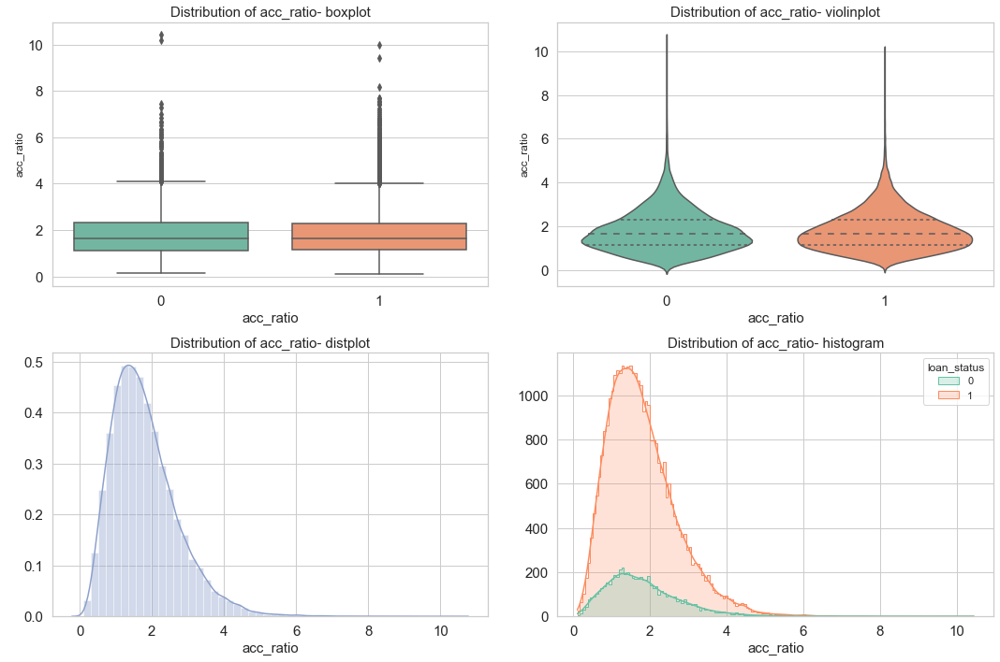

In [121]:
print_4plots('acc_ratio')
data_eda_outliers_removed['acc_ratio'].describe()

Obserwacje: Średnio klienci otwierają ok 2 linii kredytowych rok. Ta średnia jest podobna w grupie spłacających i niespłacających pożyczki.

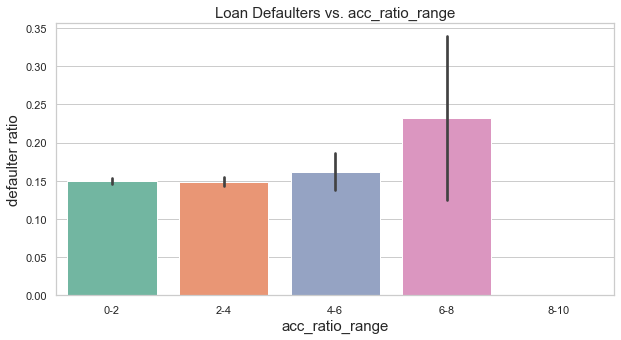

In [122]:
#acc_ratio_ranges 
bins = [0, 2, 4, 6, 8, 10]
label = ['0-2', '2-4', '4-6', '6-8', '8-10']
data_eda_outliers_removed['acc_ratio_range'] = pd.cut(data_eda_outliers_removed['acc_ratio'], bins, labels=label)

print_barplot('acc_ratio_range')

Obserwacje: W przypadku otwierania 6-8 linii kredytowych na rok, ryzyko niespłącenia jest wyraxnie większe niż dla innych grup.

## future_annual_inc_ratio

In [123]:
#future_annual_inc_ratio
data_eda_outliers_removed['future_annual_inc_ratio']=(data_eda_outliers_removed['annual_inc'] - 12* data_eda_outliers_removed['installment'])/data_eda_outliers_removed['annual_inc']

/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


count    39601.000000
mean         0.934465
std          0.039759
min          0.458290
25%          0.912255
50%          0.942228
75%          0.964575
max          0.998110
Name: future_annual_inc_ratio, dtype: float64

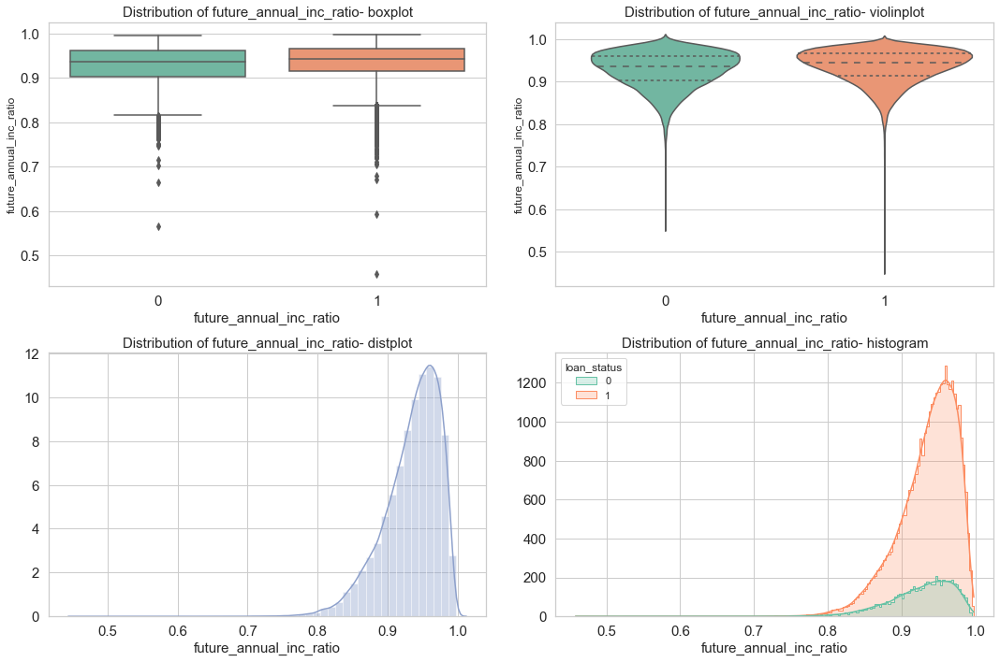

In [124]:
print_4plots('future_annual_inc_ratio')
data_eda_outliers_removed['future_annual_inc_ratio'].describe()

Obserwacje: średnio wzięcie pożyczki obniży dochód klienta o 7 %. Jest niewielka różnica w tym wskażniku między osobami spłącającymi a niespąłcającymi pożyczki.

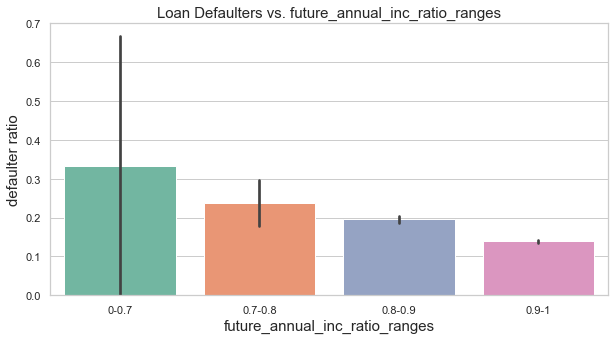

In [125]:
#future_annual_inc_ratio_ranges 
bins = [0, 0.7, 0.8, 0.9, 1]
label = ['0-0.7', '0.7-0.8', '0.8-0.9', '0.9-1']
data_eda_outliers_removed['future_annual_inc_ratio_ranges'] = pd.cut(data_eda_outliers_removed['future_annual_inc_ratio'], bins, labels=label)

print_barplot('future_annual_inc_ratio_ranges')

Obserwacje: Im mniej obniży dochód roczny wzięcie pożyczki, tym mniejsze ryzyko jej niespłacenia. 

## loan_amnt_higer_than_state_average

In [134]:
#average_loan_amnt_for_state

average_loan_amnt_for_state = []
for a,b in zip(data_eda_outliers_removed.groupby(['addr_state']).sum()['loan_amnt'], states['All']):
    avg=int(a/b)
    average_loan_amnt_for_state.append(avg)
states["average_loan_amnt_for_state"] = average_loan_amnt_for_state



In [135]:
states

loan_status,0,1,All,Probability_loan_default[%],Probability_loan_paid[%],average_loan_amnt_for_state
addr_state,,,,,,
AK,16,61,77,20.8,79.2,11964
AL,57,384,441,12.9,87.1,10356
AR,33,218,251,13.1,86.9,9922
AZ,133,745,878,15.1,84.9,10410
CA,1133,5790,6923,16.4,83.6,10614
CO,98,701,799,12.3,87.7,10355
CT,96,637,733,13.1,86.9,10355
DC,15,192,207,7.2,92.8,11239
DE,15,110,125,12.0,88.0,9779


In [136]:
average_loan_amnt_for_state = states[["average_loan_amnt_for_state"]]
average_loan_amnt_for_state

loan_status,average_loan_amnt_for_state
addr_state,
AK,11964
AL,10356
AR,9922
AZ,10410
CA,10614
CO,10355
CT,10355
DC,11239
DE,9779


In [137]:
data_eda_outliers_removed=data_eda_outliers_removed.join(average_loan_amnt_for_state, on='addr_state')

In [138]:
data_eda_outliers_removed['loan_amnt_diff']=data_eda_outliers_removed['average_loan_amnt_for_state']-data_eda_outliers_removed['loan_amnt']

In [139]:
data_eda_outliers_removed['loan_amnt_diff'].describe()

count    39601.000000
mean        -0.386859
std       6608.242748
min     -22855.000000
25%      -4140.000000
50%       1200.000000
75%       5155.000000
max      10964.000000
Name: loan_amnt_diff, dtype: float64

In [140]:
data_eda_outliers_removed['loan_amnt_higer_than_state_average']=np.where(data_eda_outliers_removed['loan_amnt_diff']<0,1,0)

In [141]:
data_eda_outliers_removed['loan_amnt_higer_than_state_average'].describe()

count    39601.000000
mean         0.410848
std          0.491994
min          0.000000
25%          0.000000
50%          0.000000
75%          1.000000
max          1.000000
Name: loan_amnt_higer_than_state_average, dtype: float64

<AxesSubplot:xlabel='loan_amnt_higer_than_state_average', ylabel='count'>

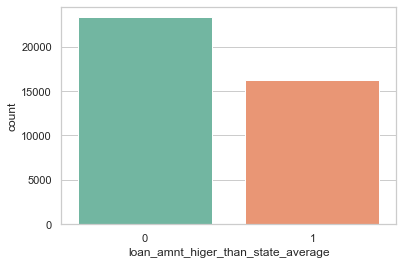

In [142]:
sns.countplot(x=data_eda_outliers_removed['loan_amnt_higer_than_state_average'],palette=sns.color_palette('Set2'))

Obserwacje: Więcej osób bierze pożyczki niższe niż średnia w stanie.

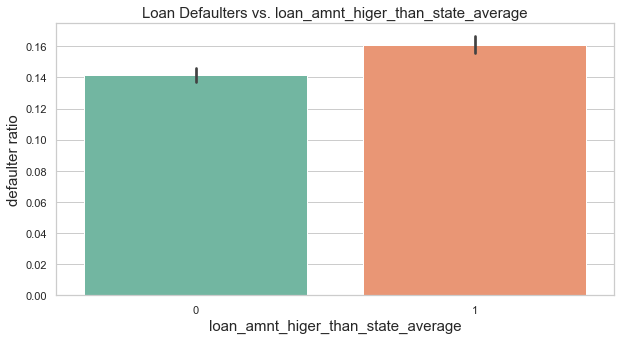

In [143]:
print_barplot('loan_amnt_higer_than_state_average')

Obserwacje: Wzięcie pożyczki większej niż średnia w stanie, wiąże się z większym ryzykiem niespłacenia.

## Przygotowanie zbioru danych do machine learning

In [144]:
#będę pracować na zbiorze z zakodowanymi zmiennymi, także wybrane do usunięcia kolumny podczas 
#analizy zbioru data_eda_outliers_removed usuwam w zbiorze #data_outliers_removed, a następnie dodaję do niego kolumny
#powstałe w ramach późniejszego feature engineeringu, które będą istotne dla modelowania


to_drop_ml =['issue_month', 'tax_liens', 'acc_now_delinq', 'delinq_amnt', 'revol_bal', 'emp_length','issue_month', 
'earliest_cr_line', 'issue_d', 'installment', 'pub_rec_bankruptcies', 'grade']

data_ml=data_outliers_removed.drop(to_drop_ml, axis=1)
data_ml.shape

(39601, 90)

In [145]:
acc_ratio = data_eda_outliers_removed['acc_ratio']
data_ml = data_ml.join(acc_ratio)

In [146]:
future_annual_inc_ratio = data_eda_outliers_removed['future_annual_inc_ratio']
data_ml = data_ml.join(future_annual_inc_ratio)

In [147]:
loan_amnt_higer_than_state_average = data_eda_outliers_removed['loan_amnt_higer_than_state_average']
data_ml = data_ml.join(loan_amnt_higer_than_state_average)

In [148]:
data_ml.shape

(39601, 93)

In [149]:
data_ml.isnull().sum().sum()

0

# 4. Modelowanie

## a. Klasteryzacja (grupowanie)

### Standaryzacja danych

In [150]:
# redukcja wymiarów zbioru - na potrzeby wizualizacji grup
from sklearn.decomposition import PCA
# skalowanie zmiennych - wskazane przy metodach korzystających z miar odległości
from sklearn.preprocessing import StandardScaler
# biblioteki do grupowania sklearn
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.cluster import DBSCAN

from scipy.cluster.hierarchy import linkage
from scipy.cluster.hierarchy import dendrogram
from scipy.cluster.hierarchy import cut_tree
import scipy.cluster.hierarchy as sch


In [151]:
X = data_ml.drop('loan_status',axis =1)  
y = data_ml['loan_status']

In [152]:
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

In [153]:
X_scaled_df = pd.DataFrame(X_scaled,columns=X.columns)

In [154]:
X_scaled_df.head()

,loan_amnt,int_rate,sub_grade,annual_inc,desc,dti,delinq_2yrs,inq_last_6mths,open_acc,pub_rec,...,addr_state_UT,addr_state_VA,addr_state_VT,addr_state_WA,addr_state_WI,addr_state_WV,addr_state_WY,acc_ratio,future_annual_inc_ratio,loan_amnt_higer_than_state_average
0,-0.828635,-0.386730,-0.607703,-1.146444,0.369742,2.134240,-0.297029,-0.045603,-1.472784,-0.240193,...,-0.081295,-0.1903,-0.037293,-0.144958,-0.110885,-0.066047,-0.044709,-1.603589,-0.399919,-0.835078
1,-1.206308,0.884270,0.405508,-0.973022,0.369742,-1.834819,-0.297029,2.598528,-1.472784,-0.240193,...,-0.081295,-0.1903,-0.037293,-0.144958,-0.110885,-0.066047,-0.044709,-1.624094,1.046395,-0.835078
2,-1.221415,1.074095,0.550252,-1.486004,-1.306904,-0.685058,-0.297029,0.615429,-1.717710,-0.240193,...,-0.081295,-0.1903,-0.037293,-0.144958,-0.110885,-0.066047,-0.044709,-0.884933,-0.429108,-0.835078
3,-0.073288,0.394578,-0.028725,-0.418072,0.369742,0.994904,-0.297029,-0.045603,0.241697,-0.240193,...,-0.081295,-0.1903,-0.037293,-0.144958,-0.110885,-0.066047,-0.044709,0.586314,-0.433209,-0.835078
4,-1.130773,0.174491,-0.173470,0.472161,0.369742,0.688103,-0.297029,-0.706636,1.466327,-0.240193,...,-0.081295,-0.1903,-0.037293,-0.144958,-0.110885,-0.066047,-0.044709,0.640554,1.392574,-0.835078


### Redukacja wymiarów (PCA)

In [155]:
from sklearn.decomposition import PCA
pca = PCA(random_state=42)
pca.fit(X_scaled)

PCA(random_state=42)

In [156]:
#ile zmienności wyjaśniają uzyskane kompontenty
var_cumu = np.cumsum(pca.explained_variance_ratio_)
var_cumu

array([0.04549014, 0.08327898, 0.10915253, 0.13241742, 0.1524471 ,
       0.16959717, 0.18613458, 0.2007961 , 0.21508178, 0.22838135,
       0.24122244, 0.25368997, 0.26598741, 0.27808489, 0.29001649,
       0.30184501, 0.31355412, 0.32520559, 0.33682573, 0.34838719,
       0.35991519, 0.37140307, 0.3828031 , 0.39416274, 0.4054943 ,
       0.41681549, 0.42811151, 0.43936747, 0.4505938 , 0.46180856,
       0.47300076, 0.48415819, 0.49528299, 0.50639661, 0.51748581,
       0.52855113, 0.53960114, 0.55064577, 0.56167511, 0.57269248,
       0.58369599, 0.5946841 , 0.60565257, 0.61661565, 0.62757453,
       0.63852925, 0.64947083, 0.66040719, 0.67133362, 0.68225502,
       0.69317311, 0.70408968, 0.71498575, 0.72587567, 0.73676285,
       0.74763647, 0.75850612, 0.76935342, 0.78019955, 0.79101783,
       0.8018014 , 0.81254158, 0.82325816, 0.83395712, 0.84462393,
       0.85523864, 0.86584372, 0.87639518, 0.8868706 , 0.89725141,
       0.90758622, 0.91781171, 0.92784669, 0.93776423, 0.94742

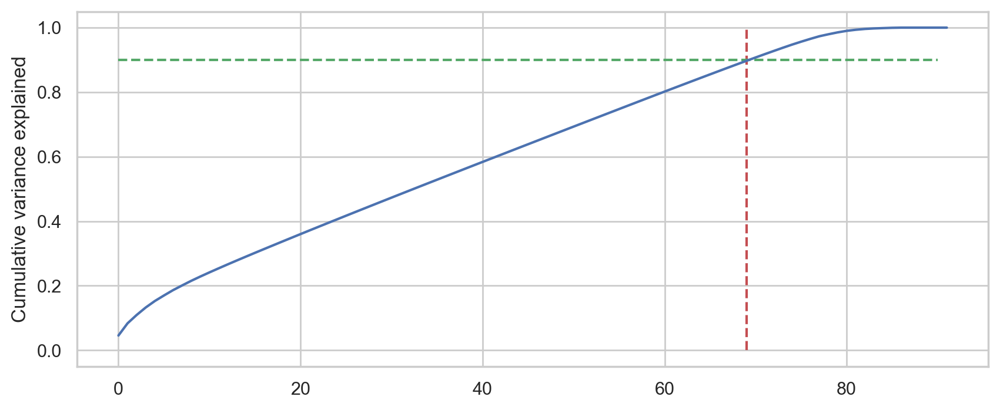

In [157]:
fig = plt.figure(figsize=[10,4],dpi=200)
plt.vlines(x=69, ymax=1, ymin=0, colors="r", linestyles="--")
plt.hlines(y=0.90, xmax=90, xmin=0, colors="g", linestyles="--")
plt.plot(var_cumu)
plt.ylabel("Cumulative variance explained")
plt.show()

In [158]:
from sklearn.decomposition import IncrementalPCA
pca_final = IncrementalPCA(n_components=69)
X_pca = pca_final.fit_transform(X_scaled)

In [159]:
#Redukacja do 69 kolumn wyjaśni nam ok 90% zmienności
# Explaining the Variance ratio
print('Explained variation per principal component: {}'.format(pca_final.explained_variance_ratio_.sum()))

Explained variation per principal component: 0.875599383490384


In [160]:
print(X.shape)
print(X_pca.shape)

(39601, 92)
(39601, 69)


In [161]:
X_pca_df = pd.DataFrame(X_pca,columns=['PC1','PC2','PC3','PC4','PC5','PC6','PC7','PC8', 'PC9','PC10','PC11','PC12', 'PC13','PC14','PC15','PC16','PC17','PC18','PC19','PC20', 'PC21','PC22','PC23','PC24', 'PC25','PC26','PC27','PC28','PC29','PC30','PC31','PC32','PC33','PC34','PC35','PC36','PC37','PC38', 'PC39','PC40','PC41','PC42', 'PC43','PC44','PC45','PC46','PC47','PC48','PC49','PC50', 'PC51','PC52','PC53','PC54', 'PC55','PC56','PC57','PC58','PC59','PC60','PC61','PC62','PC63','PC64','PC65','PC66','PC67','PC68','PC69'])

In [162]:
X_pca_df.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,...,PC60,PC61,PC62,PC63,PC64,PC65,PC66,PC67,PC68,PC69
0,-0.874205,-0.646444,-1.745295,-0.492947,-0.123743,-2.618056,0.566320,-1.044931,3.575671,0.814126,...,-0.350685,-0.413333,-0.591429,-0.027476,0.814794,0.253505,-0.798219,-2.169188,0.048916,-0.327487
1,-1.023628,-1.382893,-2.734977,4.141089,0.465884,2.033593,-0.867510,-0.482304,-0.436576,-1.426941,...,-0.378638,1.571786,-0.338429,-0.884579,1.737729,-0.552820,0.270846,0.096352,-0.682435,-1.101424
2,-1.694636,-2.675527,-0.749244,0.691754,-1.356232,0.265166,-0.051204,0.495326,0.909670,-1.195557,...,-0.243148,-0.509586,0.897937,-0.295607,-2.215166,2.387351,-1.202011,-0.524208,-0.742460,-0.017151
3,-0.576083,-0.512989,0.215637,-0.274222,2.174242,0.430556,1.345239,0.095057,0.516376,0.342730,...,-0.089903,-0.350576,-0.157157,0.616992,0.743192,-0.143291,-0.189048,0.318951,-1.153778,0.772684
4,0.632221,-0.060879,0.555387,1.713906,3.332173,0.962568,0.310502,-1.684261,0.540484,-0.094203,...,-2.120225,-0.803074,-1.723944,1.847296,-0.067064,-0.363175,0.335281,-0.095686,-0.562248,-0.638648


In [163]:
X_pca_df_2=X_pca_df[['PC1','PC2']]

In [164]:
X_pca_df_2.head()

,PC1,PC2
0,-0.874205,-0.646444
1,-1.023628,-1.382893
2,-1.694636,-2.675527
3,-0.576083,-0.512989
4,0.632221,-0.060879


/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



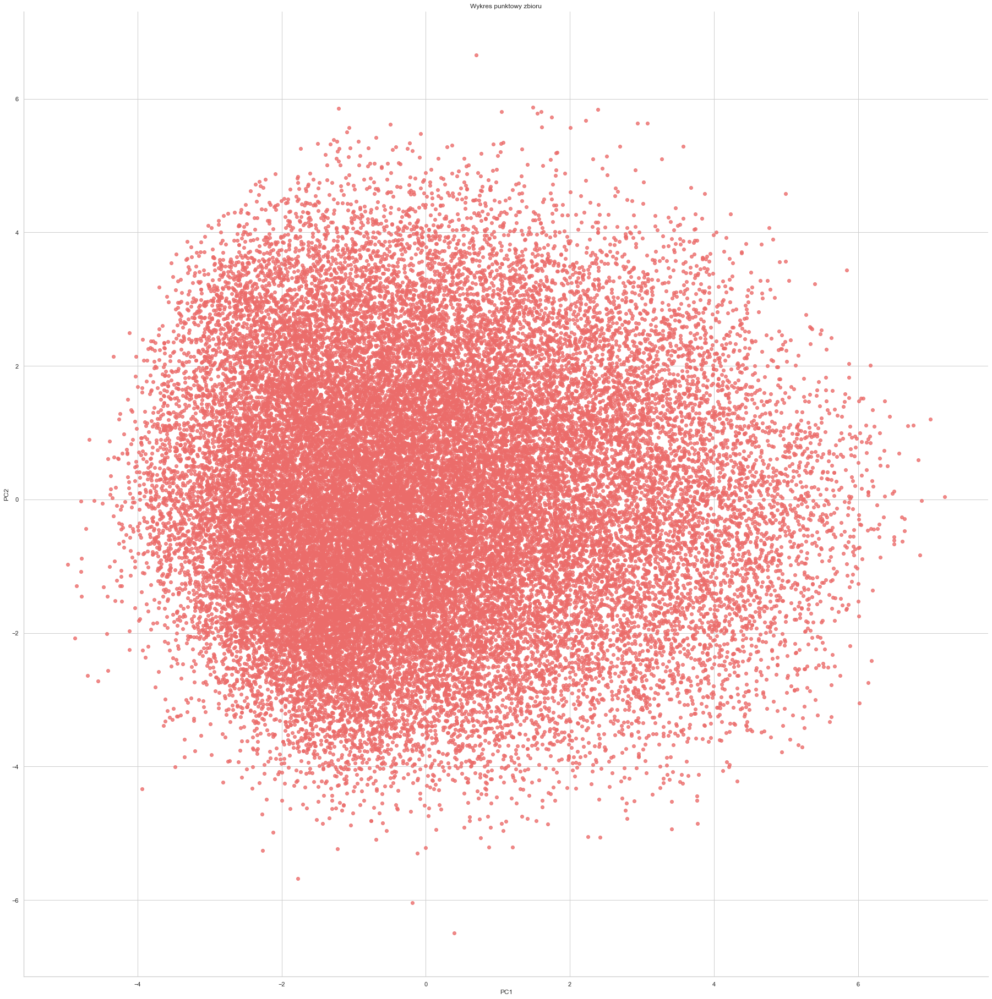

In [165]:
sns.lmplot('PC1', 'PC2', data = X_pca_df, scatter_kws={"color": "#eb6c6a"}, fit_reg=False, height=25).set(title = 'Wykres punktowy zbioru')
#sns.set(font_scale=1.5)
plt.show()

In [166]:
#sampling danych
X_pca_df_sampled=X_pca_df.sample(10000, random_state=42)

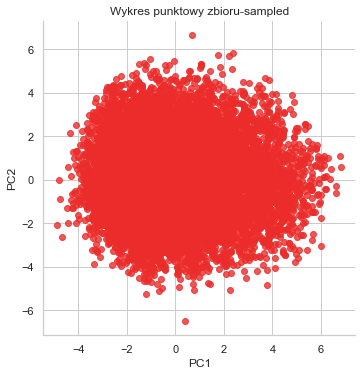

In [167]:
sns.lmplot('PC1', 'PC2', data = X_pca_df_sampled, scatter_kws={"color": "#eb2c2a"}, fit_reg=False).set(title = 'Wykres punktowy zbioru-sampled')
#sns.set(font_scale=1.5)
plt.show()

## Grupowanie hierarchiczne

In [ ]:
agglomerative = AgglomerativeClustering(linkage='ward', affinity='euclidean', n_clusters=3).fit(X_pca_df_sampled)

In [169]:
X_pca_df_sampled['Aggl_Clust_label'] = agglomerative.labels_

/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



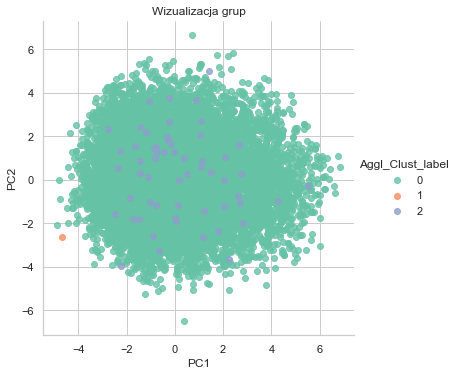

In [170]:
sns.lmplot('PC1', 'PC2', data = X_pca_df_sampled, hue = 'Aggl_Clust_label', fit_reg=False, palette = sns.color_palette('Set2')).set(title='Wizualizacja grup')
#sns.set(font_scale=1)
plt.show()

In [171]:
# Miara wewnętrzna - wskaźnik sylwetkowy
# średnią odległość pomiędzy obserwacjami wewnątrz grupy (a) i średnią odległość obserwacji do najbliższej „obcej” grupy (b). 
# Silhouette obliczany jest dla każdej obserwacji w następujący sposób: (a – b)/max(a, b)

range_n_clusters = [2, 3, 4, 5, 6, 7, 8]

for num_clusters in range_n_clusters:
    
    # intialise kmeans
    agglomerative = AgglomerativeClustering(linkage='ward', affinity='euclidean', n_clusters=num_clusters).fit(X_pca_df_sampled)
    
    cluster_labels = agglomerative.labels_
    
    # silhouette score
    silhouette_avg = silhouette_score(X_pca_df_sampled, cluster_labels)
    print("For n_clusters={0}, the silhouette score is {1}".format(num_clusters, silhouette_avg))

For n_clusters=2, the silhouette score is 0.895037512839985
For n_clusters=3, the silhouette score is 0.33135084317220237
For n_clusters=4, the silhouette score is 0.33439199655438956
For n_clusters=5, the silhouette score is 0.3381196433055102
For n_clusters=6, the silhouette score is 0.34076728990981475
For n_clusters=7, the silhouette score is 0.1636587085873734
For n_clusters=8, the silhouette score is 0.1586621980949971


In [172]:
fig = plt.figure(figsize=[10,4],dpi=200)
dendrogram = sch.dendrogram(sch.linkage(X_pca_df_sampled,  method="ward", metric='euclidean'))
plt.title('Dendrogram')
plt.xlabel(' ')
plt.ylabel('Euclidean distances')
plt.show()

KeyboardInterrupt: 

### Grupowanie iteracyjno-optymalizacyjne

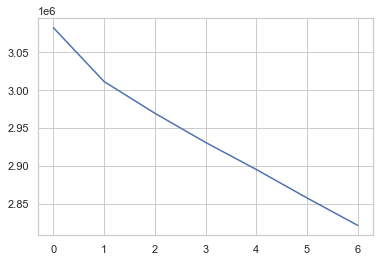

In [173]:
#określenie optymalnej liczby klastrów
# metoda łokcia - elbow-curve
ssd = [] # Sum of squared distances
range_n_clusters = [2, 3, 4, 5, 6, 7, 8]
for num_clusters in range_n_clusters:
    kmeans = KMeans(n_clusters=num_clusters, max_iter=1000)
    kmeans.fit(X_pca_df)
    
    ssd.append(kmeans.inertia_) #Sum of squared distances
    
# plot the SSDs for each n_clusters
# ssd
plt.plot(ssd)

In [270]:
#wygląda na to, że 3/4/5 klastry będą najlepsze, zobaczmy jeszcze miarę liczbową

In [271]:
# Miara wewnętrzna - wskaźnik sylwetkowy
# średnią odległość pomiędzy obserwacjami wewnątrz grupy (a) i średnią odległość obserwacji do najbliższej „obcej” grupy (b). 
# Silhouette obliczany jest dla każdej obserwacji w następujący sposób: (a – b)/max(a, b)

range_n_clusters = [2, 3, 4, 5, 6, 7, 8]

for num_clusters in range_n_clusters:
    
    # intialise kmeans
    kmeans = KMeans(n_clusters=num_clusters, max_iter=1000)
    kmeans.fit(X_pca_df)
    
    cluster_labels = kmeans.labels_
    
    # silhouette score
    silhouette_avg = silhouette_score(X_pca_df, cluster_labels)
    print("For n_clusters={0}, the silhouette score is {1}".format(num_clusters, silhouette_avg))

For n_clusters=2, the silhouette score is 0.045377607687754784
For n_clusters=3, the silhouette score is 0.040068357639447105
For n_clusters=4, the silhouette score is 0.025470113762499094
For n_clusters=5, the silhouette score is 0.030389143556367612
For n_clusters=6, the silhouette score is 0.0469834472905562
For n_clusters=7, the silhouette score is 0.03753518737335926
For n_clusters=8, the silhouette score is 0.04453156207720789


Automatically created module for IPython interactive environment
For n_clusters = 2 The average silhouette_score is : 0.06511738683808974
For n_clusters = 3 The average silhouette_score is : 0.06935486515080493
For n_clusters = 4 The average silhouette_score is : 0.038904238528183255
For n_clusters = 5 The average silhouette_score is : 0.044180311893923845
For n_clusters = 6 The average silhouette_score is : 0.044111210305664124


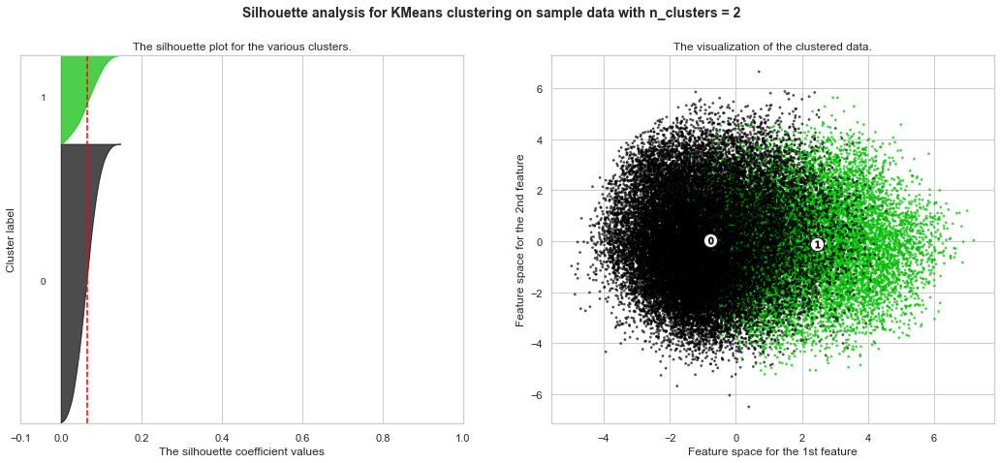

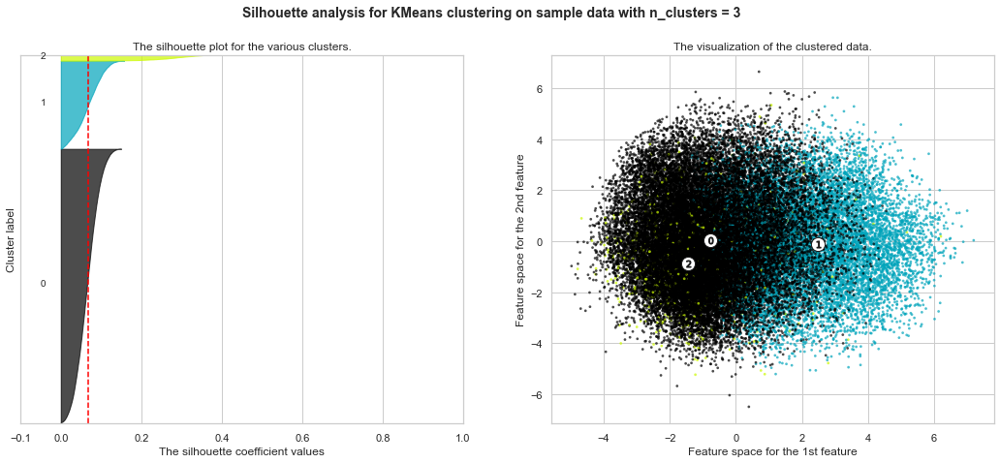

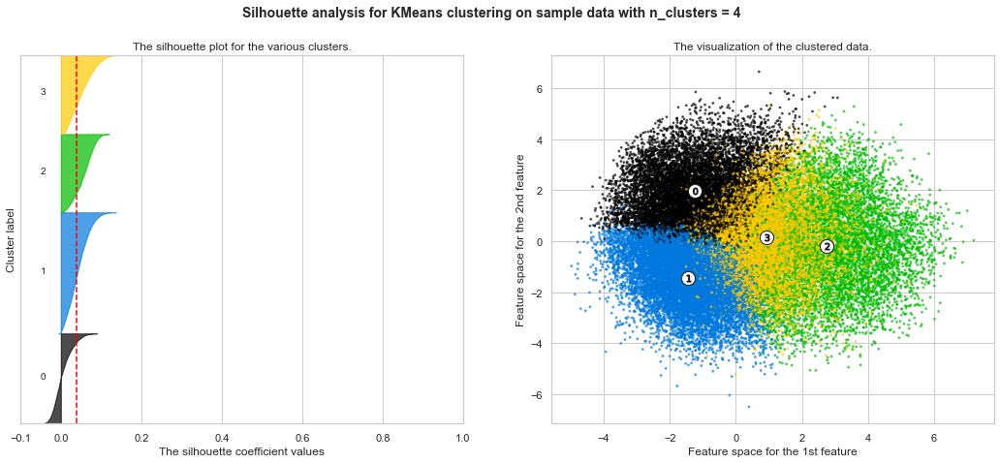

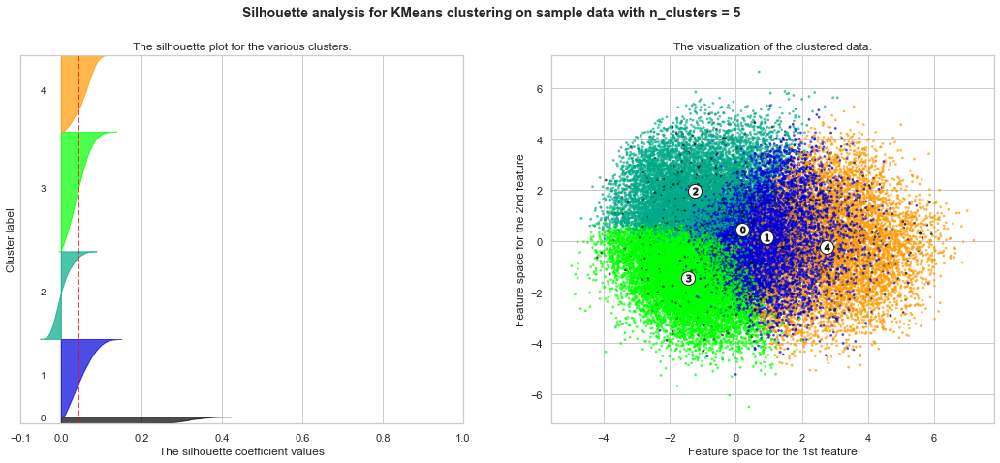

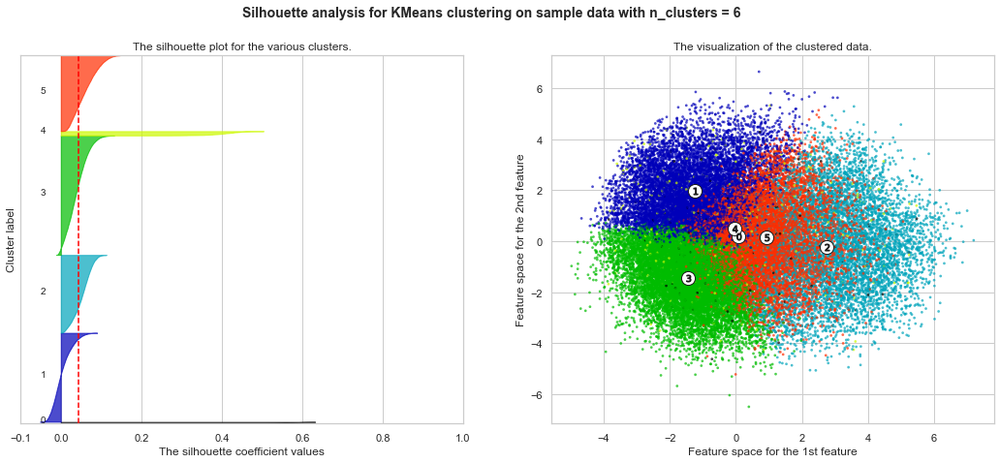

In [740]:
#kod z dokumentacji: https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.pyplot as plt
import matplotlib.cm as cm

print(__doc__)

range_n_clusters = [2, 3, 4, 5, 6]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X_pca_df)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X_pca_df, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X_pca_df, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X_pca_df['PC1'], X_pca_df['PC2'], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

In [ ]:
#z przedstawionych wykresów wynika, że pierwotnie przeze mnie wybrane 5 klastrów wcale nie jest najlepsze - miary s.score
#dla próbek są ujemne - co widać na wykresach - próbki źle sklasyfikowane. Z wykresów wynika, że 2 lub 3 klastry, to
#będzie odpowiedni podział. Decyduję się na 3 , bo średnia silhouette_score: 0.06935486515080493 dla 3 jest również najwyższa

In [174]:
kmeans = KMeans(n_clusters=3, max_iter=1000).fit(X_pca_df)

In [175]:
X_pca_df['Kmeans_label'] = kmeans.labels_

/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



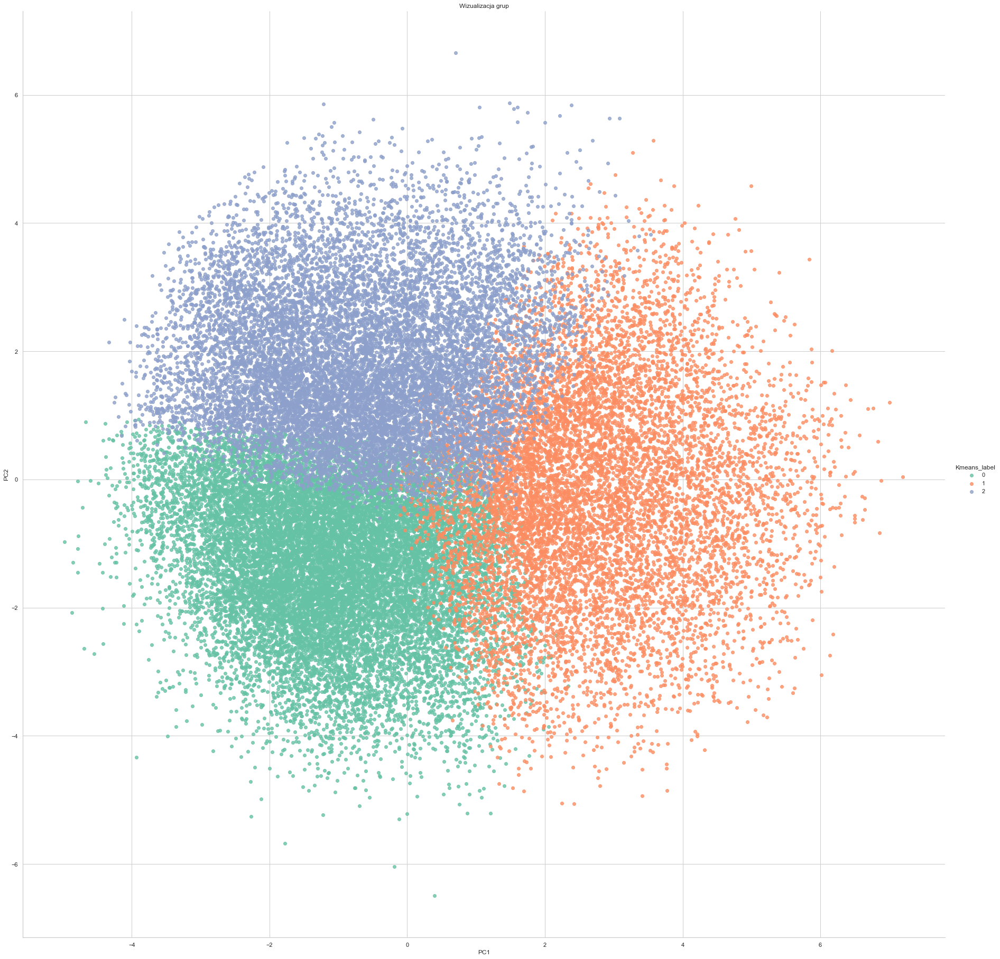

In [176]:
sns.lmplot('PC1', 'PC2', data = X_pca_df, hue = 'Kmeans_label', fit_reg=False, palette = sns.color_palette('Set2'),height=25).set(title='Wizualizacja grup')
#sns.set(font_scale=4)
plt.show()

### Grupowanie gęstościowe

In [808]:
#sampling danych
X_pca_df_sampled2=X_pca_df.sample(1000, random_state=42)

In [809]:
dbscan = DBSCAN(eps=0.5, metric='euclidean', min_samples=5, n_jobs=-1).fit(X_pca_df_sampled2)

In [811]:
X_pca_df_sampled2['Dbscan_label'] = dbscan.labels_

/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



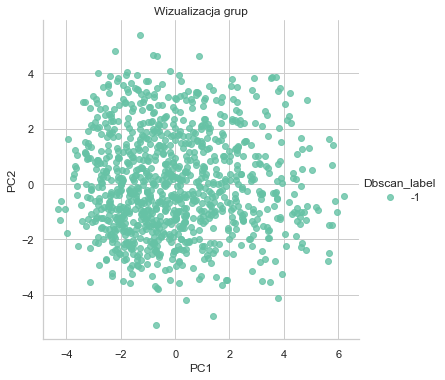

In [813]:
sns.lmplot('PC1', 'PC2', data = X_pca_df_sampled2, hue = 'Dbscan_label', fit_reg=False, palette = sns.color_palette('Set2')).set(title='Wizualizacja grup')
#sns.set(font_scale=2)
plt.show()

In [817]:
#optymalizacja parametrów DBSCAN
from sklearn.neighbors import NearestNeighbors
neigh = NearestNeighbors(n_neighbors=2)
nbrs = neigh.fit(X_pca_df_sampled2)
distances, indices = nbrs.kneighbors(X_pca_df_sampled2)

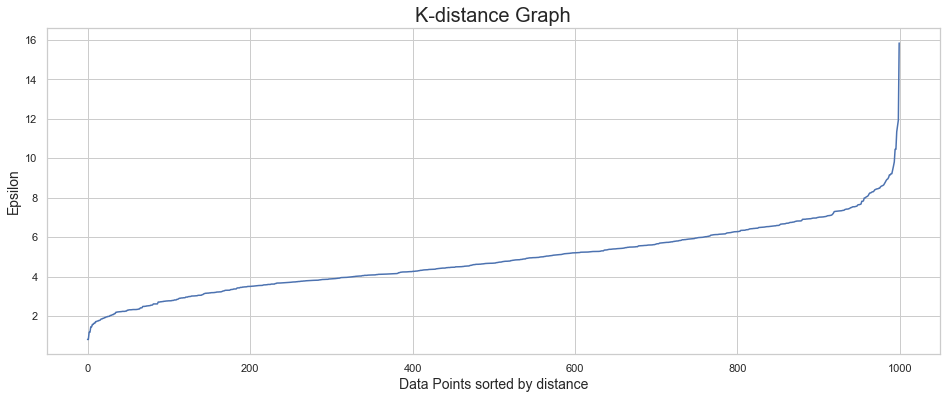

In [818]:
# Plotting K-distance Graph
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.figure(figsize=(16,6))
plt.plot(distances)
plt.title('K-distance Graph',fontsize=20)
plt.xlabel('Data Points sorted by distance',fontsize=14)
plt.ylabel('Epsilon',fontsize=14)
plt.show()

In [819]:
# Miara wewnętrzna - wskaźnik sylwetkowy
# średnią odległość pomiędzy obserwacjami wewnątrz grupy (a) i średnią odległość obserwacji do najbliższej „obcej” grupy (b). 
# Silhouette obliczany jest dla każdej obserwacji w następujący sposób: (a – b)/max(a, b)

range_min_samples = [5, 8, 10, 12, 15, 17, 20]

for min_samples in range_min_samples:
    
    # intialise kmeans
    dbscan=DBSCAN(eps=9, metric='euclidean', min_samples=min_samples).fit(X_pca_df_sampled2)
    
    cluster_labels = dbscan.labels_
    
    # silhouette score
    silhouette_avg = silhouette_score(X_pca_df_sampled2, cluster_labels)
    print("For min_samples={0}, the silhouette score is {1}".format(min_samples, silhouette_avg))

For min_samples=5, the silhouette score is 0.21335693617572749
For min_samples=8, the silhouette score is 0.17079332146719473
For min_samples=10, the silhouette score is 0.15464533419748797
For min_samples=12, the silhouette score is 0.14254172301674103
For min_samples=15, the silhouette score is 0.13509382683324167
For min_samples=17, the silhouette score is 0.13509382683324167
For min_samples=20, the silhouette score is 0.13872438091635803


In [824]:
from sklearn.cluster import DBSCAN
dbscan_opt=DBSCAN(eps=9, metric='euclidean', min_samples=15).fit(X_pca_df_sampled2)

In [825]:
X_pca_df_sampled2['Dbscan_opt_label'] = dbscan_opt.labels_

/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



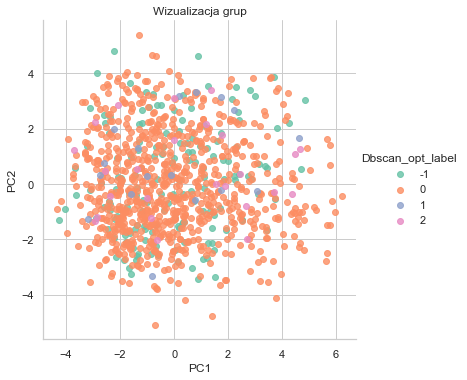

In [826]:
sns.lmplot('PC1', 'PC2', data = X_pca_df_sampled2, hue = 'Dbscan_opt_label', fit_reg=False, palette = sns.color_palette('Set2')).set(title='Wizualizacja grup')
#sns.set(font_scale=2)
plt.show()

In [827]:
X_pca_df_sampled2['DBSCAN_opt_label']=dbscan_opt.labels_
X_pca_df_sampled2['DBSCAN_opt_label'].value_counts()

 0    797
-1    161
 2     25
 1     17
Name: DBSCAN_opt_label, dtype: int64

In [828]:
X_pca_df['Kmeans_label'].value_counts()

2    20390
0    10239
1     8972
Name: Kmeans_label, dtype: int64

In [829]:
X_pca_df_sampled['Aggl_Clust_label'].value_counts()

2    9917
0      82
1       1
Name: Aggl_Clust_label, dtype: int64

In [287]:
#z doboru parametrów w algorytmach i analizy wyników wygrywa 5 klastrów, zaś tutaj najlepsza metoda to k-means, 
#bo działa na całym zbiorze i miary też ma najwyższe

### Uzupełnienie danych o informacje o klastrach

In [177]:
#jak to przypisać skoro dane były undersamplowane? z przypisania reszty rezygnuję, bo były przypisane jedynie 1000 próbkom
X['Kmeans_label'] = kmeans.labels_

In [178]:
X

,loan_amnt,int_rate,sub_grade,annual_inc,desc,dti,delinq_2yrs,inq_last_6mths,open_acc,pub_rec,...,addr_state_VA,addr_state_VT,addr_state_WA,addr_state_WI,addr_state_WV,addr_state_WY,acc_ratio,future_annual_inc_ratio,loan_amnt_higer_than_state_average,Kmeans_label
0,5000.0,10.65,6,24000.0,1,27.65,0.0,1.0,3.0,0.0,...,0,0,0,0,0,0,0.334200,0.918565,0,0
1,2500.0,15.27,13,30000.0,1,1.00,0.0,5.0,3.0,0.0,...,0,0,0,0,0,0,0.315457,0.976068,0,0
2,2400.0,15.96,14,12252.0,0,8.72,0.0,2.0,2.0,0.0,...,0,0,0,0,0,0,0.991080,0.917405,0,0
3,10000.0,13.49,10,49200.0,1,20.00,0.0,1.0,10.0,0.0,...,0,0,0,0,0,0,2.335859,0.917241,0,0
4,3000.0,12.69,9,80000.0,1,17.94,0.0,0.0,15.0,0.0,...,0,0,0,0,0,0,2.385436,0.989832,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42508,6000.0,13.12,19,12000.0,0,4.40,0.0,9.0,15.0,0.0,...,0,0,0,0,0,0,6.201550,0.797490,0,0
42509,5350.0,13.12,19,4000.0,0,15.00,0.0,1.0,1.0,0.0,...,0,0,0,0,0,0,1.724138,0.458290,0,0
42511,10000.0,14.70,24,50000.0,0,7.22,2.0,0.0,14.0,0.0,...,0,0,0,0,0,0,2.551020,0.917157,0,0
42513,6000.0,10.59,11,20000.0,1,12.90,0.0,4.0,5.0,0.0,...,0,0,0,0,0,0,0.525394,0.882832,0,0


In [179]:
clast=[]
clast=pd.DataFrame(clast)
clast = clast.assign(loan_status=y)
clast['Kmeans_label']=kmeans.labels_
clast


,loan_status,Kmeans_label
0,1,0
1,0,0
2,1,0
3,1,0
4,1,1
...,...,...
42508,1,0
42509,1,0
42511,1,0
42513,1,0


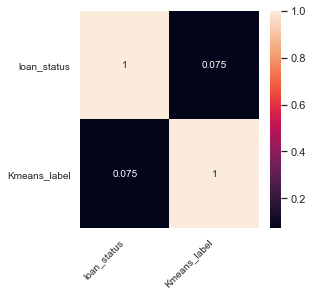

In [180]:
#Correlation matrix
plt.figure(figsize = (4,4))       
plt.rcParams["font.size"] = "10"
ax=sns.heatmap(clast.corr(),annot = True)
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right',
    fontsize = 10);
ax.set_yticklabels(
    ax.get_yticklabels(),
    rotation=0,
    fontsize = 10);

In [181]:
from scipy.stats import chi2_contingency
from scipy.stats import chi2
contingency_table=pd.crosstab(clast['Kmeans_label'],clast['loan_status'])

stat, p, dof, expected = chi2_contingency(contingency_table)
print('stat=%.3f, p=%.3f' % (stat, p))
if p <= 0.05:
    print('Dependent (reject H0)')
else:
    print('Independent (fail to reject H0)')

stat=911.751, p=0.000
Dependent (reject H0)


In [293]:
#korelacja jest słaba, ale zmienne są zależne, zatem pozostawiam tą kolumnę w datasecie

## Podsumowanie etapu klasteryzacji
Przeporwadziłam trzy rodzaje grupowania róznymi metodami, przy czym najodpiwiedniejsza okazała się metoda K-means. Biorąc pod uwagę metodę łokcia, miarę silhouette score(średnią) i wykresy silhouette score dla wszyskitch punktów
zdecydowałam o podziale zbioru na 3 klastry. Taki też wybór zastosowałam w dwóch pozostałych metodach, jednak do danych dopisałam jedynie wynik grupowania K-means, bo inne metody przeprowadzane były na próbkach danych 1000 lub 10000. 

## b. Modelowanie - porównanie modeli

Na etapie modelowania przedstawiam dwa podejścia: jedno zakłada zbalansowanie całego zestawu danych na początku, przed podziałem na zbiory treningowy i testowy. Pozwala ono uzyskać bardzo dobre wyniki, jednak umieszczenie w zbiorze testowym danych z oversamplingu pwoduje zbyt optymistyczne predykcje. Bardziej "rzeczywiste" jest podejście drugie - zakałdające zbalansowanie jedynie zbiorów treningowych. Wyniki nie są już tak wysokie, ale lepiej oddają użycie modelu na prawdziwych danych. 

## Podejście nr 1: Zbalansowanie całego zestawu danych

### Zbalansowanie klas 

In [294]:
#!pip install imblearn
#!pip install delayed


In [189]:
from imblearn.combine import SMOTETomek
from collections import Counter
# Implementacja oversamplingu by zbalansować klasy
smk = SMOTETomek(random_state=42)
X_res, y_res = smk.fit_resample(X, y)
print("Wielkość datasetu bazowego {}".format(Counter(y)))
print("Wielkość datasetu po oversamplingu {}".format(Counter(y_res)))

Wielkość datasetu bazowego Counter({1: 33676, 0: 5925})
Wielkość datasetu po oversamplingu Counter({1: 31210, 0: 31210})


### Podział danych na testowe i treningowe i skalowanie

In [259]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.5, random_state = 42,stratify=y)

In [260]:
X_train_res, X_test_res, y_train_res, y_test_res = train_test_split(X_res, y_res, test_size = 0.2, random_state = 42)

In [261]:
## Feature scaling - skalowanie danych - sprowadzanie atrybutów do wspólnej skali 
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

X_train_s = scaler.fit_transform(X_train)
X_test_s = scaler.transform(X_test)
#fit_transform vs. transform :train set and test set are normalized by StandardScaler using the information 
#only from the train set (test set is unseen).


X_train_res_s = scaler.fit_transform(X_train_res)
X_test_res_s = scaler.transform(X_test_res)

In [262]:
X_train_s = pd.DataFrame(X_train, columns=X.columns)
X_test_s = pd.DataFrame(X_test, columns=X.columns)
X_train_res_s = pd.DataFrame(X_train_res_s, columns=X.columns)
X_test_res_s = pd.DataFrame(X_test_res_s, columns=X.columns)


In [263]:
X_train_res_s.describe()

,loan_amnt,int_rate,sub_grade,annual_inc,desc,dti,delinq_2yrs,inq_last_6mths,open_acc,pub_rec,...,addr_state_VA,addr_state_VT,addr_state_WA,addr_state_WI,addr_state_WV,addr_state_WY,acc_ratio,future_annual_inc_ratio,loan_amnt_higer_than_state_average,Kmeans_label
count,4.993600e+04,4.993600e+04,4.993600e+04,4.993600e+04,4.993600e+04,4.993600e+04,4.993600e+04,4.993600e+04,4.993600e+04,4.993600e+04,...,4.993600e+04,4.993600e+04,4.993600e+04,4.993600e+04,4.993600e+04,4.993600e+04,4.993600e+04,4.993600e+04,4.993600e+04,4.993600e+04
mean,1.497965e-16,6.417332e-16,-6.304922e-17,-2.052232e-16,9.205051e-16,3.043331e-16,1.989204e-15,-2.775558e-16,2.418853e-16,-6.494991e-16,...,1.513674e-15,-6.018327e-16,2.456493e-16,-2.722615e-16,-1.436663e-15,4.179622e-16,-3.007225e-17,-4.804356e-15,3.510578e-16,-2.904308e-16
std,1.000010e+00,1.000010e+00,1.000010e+00,1.000010e+00,1.000010e+00,1.000010e+00,1.000010e+00,1.000010e+00,1.000010e+00,1.000010e+00,...,1.000010e+00,1.000010e+00,1.000010e+00,1.000010e+00,1.000010e+00,1.000010e+00,1.000010e+00,1.000010e+00,1.000010e+00,1.000010e+00
min,-1.507660e+00,-2.112773e+00,-1.691631e+00,-1.721720e+00,-1.177092e+00,-2.163842e+00,-3.300628e-01,-7.970940e-01,-2.061599e+00,-2.972973e-01,...,-1.464130e-01,-2.759626e-02,-1.122164e-01,-8.639904e-02,-5.049495e-02,-3.410040e-02,-1.925546e+00,-9.112500e+00,-8.401274e-01,-9.600823e-01
25%,-8.422777e-01,-6.504477e-01,-8.006347e-01,-6.790122e-01,-1.177092e+00,-7.379927e-01,-3.300628e-01,-7.970940e-01,-7.669555e-01,-2.972973e-01,...,-1.464130e-01,-2.759626e-02,-1.122164e-01,-8.639904e-02,-5.049495e-02,-3.410040e-02,-7.165010e-01,-5.855845e-01,-8.401274e-01,-9.600823e-01
50%,-1.621093e-01,2.756548e-02,-2.066371e-01,-2.134097e-01,5.529819e-01,2.715987e-02,-3.300628e-01,-1.506865e-01,-1.501867e-01,-2.972973e-01,...,-1.464130e-01,-2.759626e-02,-1.122164e-01,-8.639904e-02,-5.049495e-02,-3.410040e-02,-1.535477e-01,1.883673e-01,-8.401274e-01,3.060650e-01
75%,6.363492e-01,7.013717e-01,6.843594e-01,4.082558e-01,5.529819e-01,7.714218e-01,-3.300628e-01,4.957210e-01,5.321735e-01,-2.972973e-01,...,-1.464130e-01,-2.759626e-02,-1.122164e-01,-8.639904e-02,-5.049495e-02,-3.410040e-02,5.480307e-01,7.694216e-01,1.190296e+00,3.060650e-01
max,3.297878e+00,3.001055e+00,3.357349e+00,5.925844e+00,2.283056e+00,2.607354e+00,1.821173e+01,2.053435e+01,3.375904e+00,1.988724e+01,...,6.829997e+00,3.623679e+01,8.911354e+00,1.157420e+01,1.980396e+01,2.932517e+01,9.908172e+00,1.646803e+00,1.190296e+00,1.572212e+00


### Logistic Regression (LR ,Regresja logistyczna )

In [195]:
from sklearn.linear_model import LogisticRegression
logisticRegr = LogisticRegression(max_iter=1000)
logisticRegr.fit(X_train_res_s, y_train_res)
lr_score = logisticRegr.score(X_test_res_s, y_test_res)
print("Model score : %s" % "{0:.3%}".format(lr_score))
lr_train_score=logisticRegr.score(X_train_res_s, y_train_res)
# performance on train data
print('Performance on training data using LR:',lr_train_score)
# performance on test data
print('Performance on testing data using LR:',lr_score)

Model score : 91.605%
Performance on training data using LR: 0.9123077539250241
Performance on testing data using LR: 0.9160525472604935


In [196]:
#niewielka różnica błędu na zbirach testowym i terningowym przy dość wysokiej dokładności - dobry kandydat

In [197]:
lr_predictions = logisticRegr.predict(X_test_res_s)
from sklearn import metrics
cm = metrics.confusion_matrix(y_test_res, lr_predictions)
print(cm)
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

[[5273 1025]
 [  23 6163]]


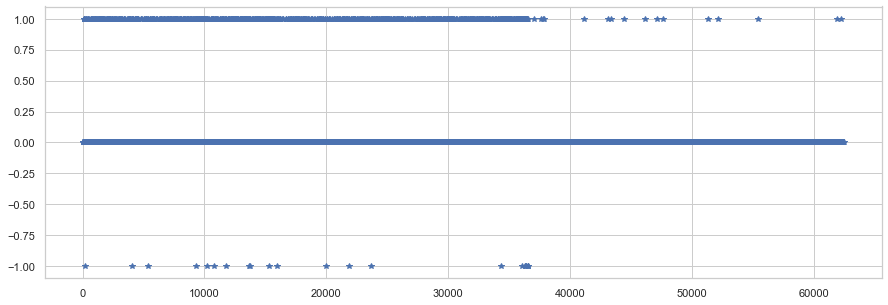

In [198]:
plt.figure(figsize=(15,5))
lr_errors = lr_predictions - y_test_res
plt.plot(lr_errors, '*')

In [199]:
lr_y_score=logisticRegr.predict_proba(X_test_res_s)[:, 1]
lr_auroc_score=metrics.roc_auc_score(y_test_res, lr_y_score)
print("LR AUROC score : %s" % "{0:.3%}".format(lr_auroc_score))
lr_accuracy = metrics.accuracy_score(y_test_res, lr_predictions)
print("LR Accuracy : %s" % "{0:.3%}".format(lr_accuracy))
lr_precision=metrics.precision_score(y_test_res, lr_predictions)
print("LR Precision : %s" % "{0:.3%}".format(lr_precision))
lr_recall=metrics.recall_score(y_test_res, lr_predictions)
print("LR Sensitivity : %s" % "{0:.3%}".format(lr_recall))
lr_specificity = TN / float(TN + FP)
print('LR Specificity : {0:.3%}'.format(lr_specificity))

LR AUROC score : 95.087%
LR Accuracy : 91.605%
LR Precision : 85.740%
LR Sensitivity : 99.628%
LR Specificity : 85.740%


In [200]:
#uwaga: najpierw robiłam: lr_auroc_score=metrics.roc_auc_score(lr_predictions, y_test_res),
#ale po doczytaniu w dokumentacji okazało się, że jako parametr w roc_auc_score nleży podać tzw. y i y_score, czyli inaczej
#niż dla innych, gdzie jest to y_true i y_prediction. Zorientowałam się dopiero po drobnych w różnicach w AUROC_score
#liczonym z metrics.roc_auc_score i takim liczonym dla wykresu. Po zamianie wszystko się zgadza. Przy okazji natknęłam 
#się na inny błąd - w innych metrykach miałam odwrotną kolejność: najpierw y_prediction a potem y_true (efektem była zamiana wyników
#Precision i sensitivity)

### Decision Tree (DT, Drzewo decyzyjne)

In [201]:
from sklearn.tree import DecisionTreeClassifier
dtree = DecisionTreeClassifier()
dtree.fit(X_train_res_s, y_train_res)
dtree_score = dtree.score(X_test_res_s, y_test_res)
print("Model score : %s" % "{0:.3%}".format(dtree_score))
dtree_train_score=dtree.score(X_train_res_s, y_train_res)
# performance on train data
print('Performance on training data using DT:',dtree_train_score)
# performance on test data
print('Performance on testing data using DT:',dtree_score)

Model score : 85.141%
Performance on training data using DT: 1.0
Performance on testing data using DT: 0.8514098045498237


In [202]:
#wygląda na przeuczony, trzeba zbalansować wariancję-obciążenie, spróbuję użyć innego podziału danych
#30:70 - powinno pomóc

In [203]:
dt_predictions = dtree.predict(X_test_res_s)
cm = metrics.confusion_matrix(y_test_res, dt_predictions)
print(cm)
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

[[5412  886]
 [ 969 5217]]


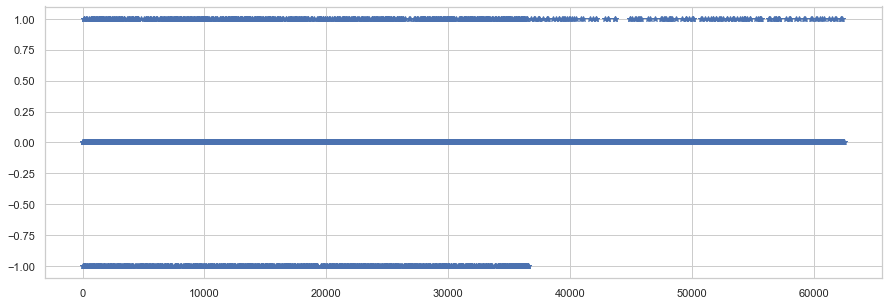

In [204]:
plt.figure(figsize=(15,5))
dt_errors = dt_predictions - y_test_res
plt.plot(dt_errors, '*')

In [205]:
dt_y_score=dtree.predict_proba(X_test_res_s)[:, 1]
dt_auroc_score=metrics.roc_auc_score(y_test_res, dt_y_score)
print("DT AUROC score : %s" % "{0:.3%}".format(dt_auroc_score))
dt_accuracy = metrics.accuracy_score(y_test_res, dt_predictions)
print("DT Accuracy : %s" % "{0:.3%}".format(dt_accuracy))
dt_precision=metrics.precision_score(y_test_res, dt_predictions)
print("DT Precision : %s" % "{0:.3%}".format(dt_precision))
dt_recall=metrics.recall_score(y_test_res, dt_predictions,)
print("DT Sensitivity : %s" % "{0:.3%}".format(dt_recall))
dt_specificity = TN / float(TN + FP)
print('DT Specificity : {0:.3%}'.format(dt_specificity))

DT AUROC score : 85.134%
DT Accuracy : 85.141%
DT Precision : 85.483%
DT Sensitivity : 84.336%
DT Specificity : 85.483%


### Decision Tree 2 (BDT,  drzewo decyzyjne z innym podziałem (30:70))

In [206]:
from sklearn.model_selection import train_test_split
X_train_2, X_test_2, y_train_2, y_test_2 = train_test_split(X, y, test_size = 0.3, random_state = 42)
X_train_res_2, X_test_res_2, y_train_res_2, y_test_res_2 = train_test_split(X_res, y_res, test_size = 0.3, random_state = 42)

In [207]:
scaler = StandardScaler()

X_train_s_2 = scaler.fit_transform(X_train_2)
X_test_s_2 = scaler.transform(X_test_2)
#fit_transform vs. transform :train set and test set are normalized by StandardScaler using the information 
#only from the train set (test set is unseen).

X_train_res_s_2 = scaler.fit_transform(X_train_res_2)
X_test_res_s_2 = scaler.transform(X_test_res_2)

X_res_s=scaler.fit_transform(X_res)

In [208]:
dtree_2 = DecisionTreeClassifier()
dtree_2.fit(X_train_res_s_2, y_train_res_2)
dtree_2_score = dtree_2.score(X_test_res_s_2, y_test_res_2)
print("Model score : %s" % "{0:.3%}".format(dtree_2_score))
dtree_2_train_score=dtree_2.score(X_train_res_s_2, y_train_res_2)
# performance on train data
print('Performance on training data using DT_2:',dtree_2_train_score)
# performance on test data
print('Performance on testing data using DT_2:',dtree_2_score)

Model score : 84.140%
Performance on training data using DT_2: 1.0
Performance on testing data using DT_2: 0.8413969881448253


In [209]:
dt_2_predictions = dtree_2.predict(X_test_res_s_2)
cm = metrics.confusion_matrix(y_test_res_2, dt_2_predictions)
print(cm)
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

[[8004 1400]
 [1570 7752]]


In [210]:
dt_2_y_score=dtree_2.predict_proba(X_test_res_s_2)[:, 1]
dt_2_auroc_score=metrics.roc_auc_score(y_test_res_2, dt_2_y_score)
print("DT_2 AUROC score : %s" % "{0:.3%}".format(dt_2_auroc_score))
dt_2_accuracy = metrics.accuracy_score(y_test_res_2, dt_2_predictions)
print("DT_2 Accuracy : %s" % "{0:.3%}".format(dt_2_accuracy))
dt_2_precision=metrics.precision_score(y_test_res_2, dt_2_predictions)
print("DT_2 Precision : %s" % "{0:.3%}".format(dt_2_precision))
dt_2_recall=metrics.recall_score(y_test_res_2, dt_2_predictions)
print("DT_2 Sensitivity : %s" % "{0:.3%}".format(dt_2_recall))
dt_2_specificity = TN / float(TN + FP)
print('DT_2 Specificity : {0:.3%}'.format(dt_2_specificity))

DT_2 AUROC score : 84.135%
DT_2 Accuracy : 84.140%
DT_2 Precision : 84.703%
DT_2 Sensitivity : 83.158%
DT_2 Specificity : 84.703%


In [211]:
#spodziewałam się, że zwiększenie zbioru testowego pomoże w zmniejszeniu różnicy między dopasowaniem na zbiorze testowym
#i treningowym, ale tak się nie stało, wynik na treningowym jest taki sam, a na testowym jest nawet trochę gorszy

### Random Forest (RF, Las losowy)

In [212]:
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier(n_estimators=100)
rf.fit(X_train_res_s, y_train_res)
rf_score = rf.score(X_test_res_s, y_test_res)
print("Model score : %s" % "{0:.3%}".format(rf_score))
rf_train_score=rf.score(X_train_res_s, y_train_res)
# performance on train data
print('Performance on training data using RF:',rf_train_score)
# performance on test data
print('Performance on testing data using RF:',rf_score)

Model score : 91.429%
Performance on training data using RF: 1.0
Performance on testing data using RF: 0.9142902915732137


In [213]:
#wygląda na przeuczony, trzeba zbalansować wariancję-obciążenie, ale jest szybki, spróbuję użyć innego podziału danych
#30:70 - powinno pomóc na początek

In [214]:
rf_predictions = rf.predict(X_test_res_s)
cm = metrics.confusion_matrix(y_test_res, rf_predictions)
print(cm)
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

[[5308  990]
 [  80 6106]]


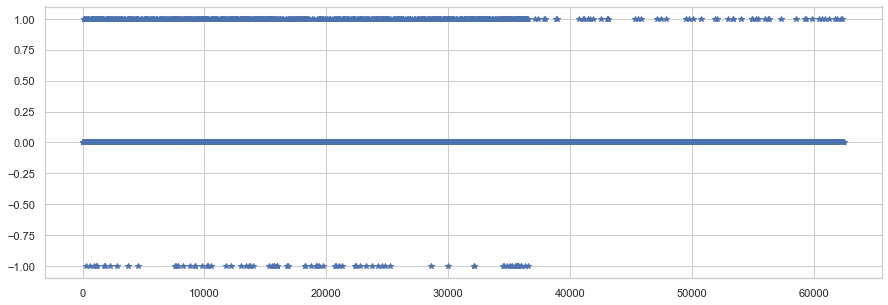

In [215]:
plt.figure(figsize=(15,5))
rf_errors = rf_predictions - y_test_res
plt.plot(rf_errors, '*')

In [216]:
rf_y_score=rf.predict_proba(X_test_res_s)[:, 1]
rf_auroc_score=metrics.roc_auc_score(y_test_res, rf_y_score)
print("RF AUROC score : %s" % "{0:.3%}".format(rf_auroc_score))
rf_accuracy = metrics.accuracy_score(y_test_res, rf_predictions)
print("RF Accuracy : %s" % "{0:.3%}".format(rf_accuracy))
rf_precision=metrics.precision_score(y_test_res, rf_predictions)
print("RF Precision : %s" % "{0:.3%}".format(rf_precision))
rf_recall=metrics.recall_score(y_test_res, rf_predictions)
print("RF Sensitivity : %s" % "{0:.3%}".format(rf_recall))
rf_specificity = TN / float(TN + FP)
print('RF Specificity : {0:.3%}'.format(rf_specificity))

RF AUROC score : 95.784%
RF Accuracy : 91.429%
RF Precision : 86.048%
RF Sensitivity : 98.707%
RF Specificity : 86.048%


### Random Forest 2 (RF, Las losowy z innym podziałem (30:70))

In [217]:
rf_2 = RandomForestClassifier(n_estimators=100)
rf_2.fit(X_train_res_s_2, y_train_res_2)
rf_2_score = rf_2.score(X_test_res_s_2, y_test_res_2)
print("Model score : %s" % "{0:.3%}".format(rf_2_score))
rf_2_train_score=rf_2.score(X_train_res_s_2,y_train_res_2)
# performance on train data
print('Performance on training data using RF_2:',rf_2_train_score)
# performance on test data
print('Performance on testing data using RF_2:',rf_2_score)

Model score : 90.943%
Performance on training data using RF_2: 1.0
Performance on testing data using RF_2: 0.9094307380113211


In [218]:
rf_2_predictions = rf_2.predict(X_test_res_s_2)
cm = metrics.confusion_matrix(y_test_res_2, rf_2_predictions)
print(cm)
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

[[7877 1527]
 [ 169 9153]]


In [219]:
rf_2_y_score=rf_2.predict_proba(X_test_res_s_2)[:, 1]
rf_2_auroc_score=metrics.roc_auc_score(y_test_res_2, rf_2_y_score)
print("RF_2 AUROC score : %s" % "{0:.3%}".format(rf_2_auroc_score))
rf_2_accuracy = metrics.accuracy_score(y_test_res_2, rf_2_predictions)
print("RF_2 Accuracy : %s" % "{0:.3%}".format(rf_2_accuracy))
rf_2_precision=metrics.precision_score(y_test_res_2, rf_2_predictions)
print("RF_2 Precision : %s" % "{0:.3%}".format(rf_2_precision))
rf_2_recall=metrics.recall_score(y_test_res_2, rf_2_predictions)
print("RF_2 Sensitivity : %s" % "{0:.3%}".format(rf_2_recall))
rf_2_specificity = TN / float(TN + FP)
print('RF_2 Specificity : {0:.3%}'.format(rf_2_specificity))

RF_2 AUROC score : 95.659%
RF_2 Accuracy : 90.943%
RF_2 Precision : 85.702%
RF_2 Sensitivity : 98.187%
RF_2 Specificity : 85.702%


### Support Vector Machines (SVM, Maszyna wektorów nośnych)

In [220]:
#import time
#licznik_start = time.time()

#from sklearn.svm import SVC
#svm = SVC(kernel='linear')
#svm.fit(X_train_res_s, y_train_res)
#svm_score = svm.score(X_test_res_s, y_test_res)
#print("Model score : %s" % "{0:.3%}".format(svm_score))
#svm_train_score=svm.score(X_train_res_s,y_train_res)
#performance on train data
#print('Performance on training data using SVM:',svm_train_score)
#performance on test data
#print('Performance on testing data using SVM:',svm_score)

#print("Work time [min]: ", (time.time() - licznik_start)/60)

In [221]:
import time
licznik_start = time.time()

from sklearn.svm import LinearSVC
lsvm = LinearSVC(dual = False)
lsvm.fit(X_train_res_s, y_train_res)
lsvm_score = lsvm.score(X_test_res_s, y_test_res)
print("Model score : %s" % "{0:.3%}".format(lsvm_score))
lsvm_train_score=lsvm.score(X_train_res_s,y_train_res)
# performance on train data
print('Performance on training data using LinearSVM:',lsvm_train_score)
# performance on test data
print('Performance on testing data using LinearSVM:',lsvm_score)

print("Work time [min]: ", (time.time() - licznik_start)/60)

Model score : 91.517%
Performance on training data using LinearSVM: 0.912508010253124
Performance on testing data using LinearSVM: 0.9151714194168535
Work time [min]:  0.0429462472597758


In [222]:
#bardzo długo trwało liczenie, podobne błędy na zbirach testowym i terningowym przy dość wysokiej dokładności 
#byłby to dobry kandydat, ale czas liczenia za długi. Po zamianie na Linear SVC jest dużo lepiej i szybciej!

In [223]:
lsvm_predictions = lsvm.predict(X_test_res_s)
cm = metrics.confusion_matrix(y_test_res, lsvm_predictions)
print(cm)
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

[[5247 1051]
 [   8 6178]]


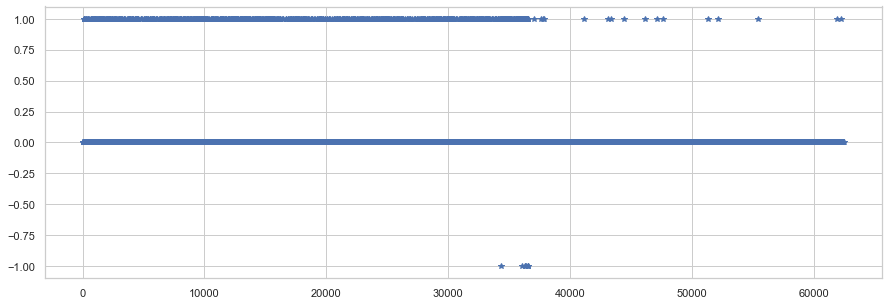

In [224]:
plt.figure(figsize=(15,5))
lsvm_errors = lsvm_predictions - y_test_res
plt.plot(lsvm_errors, '*')

In [225]:
#lsvm_y_score=lsvm.predict_proba(X_test_res_s)[:, 1] --> dla linear svm nie działa predict_proba
lsvm_auroc_score=metrics.roc_auc_score(y_test_res,lsvm.decision_function(X_test_res_s))
print("Linear SVM AUROC score : %s" % "{0:.3%}".format(lsvm_auroc_score))
lsvm_accuracy = metrics.accuracy_score(y_test_res, lsvm_predictions)
print("Linear SVM Accuracy : %s" % "{0:.3%}".format(lsvm_accuracy))
lsvm_precision=metrics.precision_score(y_test_res, lsvm_predictions)
print("Linear SVM Precision : %s" % "{0:.3%}".format(lsvm_precision))
lsvm_recall=metrics.recall_score(y_test_res, lsvm_predictions)
print("Linear SVM Sensitivity : %s" % "{0:.3%}".format(lsvm_recall))
lsvm_specificity = TN / float(TN + FP)
print('Linear SVM Specificity : {0:.3%}'.format(lsvm_specificity))

Linear SVM AUROC score : 95.102%
Linear SVM Accuracy : 91.517%
Linear SVM Precision : 85.461%
Linear SVM Sensitivity : 99.871%
Linear SVM Specificity : 85.461%


### K Nearest Neighbors (KNN, k-Najbliższych sąsiadów)

In [226]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier()
knn.fit(X_train_res_s, y_train_res)
knn_score = knn.score(X_test_res_s, y_test_res)
print("Model score : %s" % "{0:.3%}".format(knn_score))
knn_train_score=knn.score(X_train_res_s,y_train_res)
# performance on train data
print('Performance on training data using KNN:',knn_train_score)
# performance on test data
print('Performance on testing data using KNN:',knn_score)

Model score : 90.211%
Performance on training data using KNN: 0.9217398269785325
Performance on testing data using KNN: 0.9021147068247357


In [227]:
#dośc mała różnica między błędami na zbiorze treningowym i testowym, do poprawy parametrami, ale dość wolny, choć nie 
#tak, jak SVM

In [228]:
knn_predictions = knn.predict(X_test_res_s)
cm = metrics.confusion_matrix(y_test_res, knn_predictions)
print(cm)
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

[[5324  974]
 [ 248 5938]]


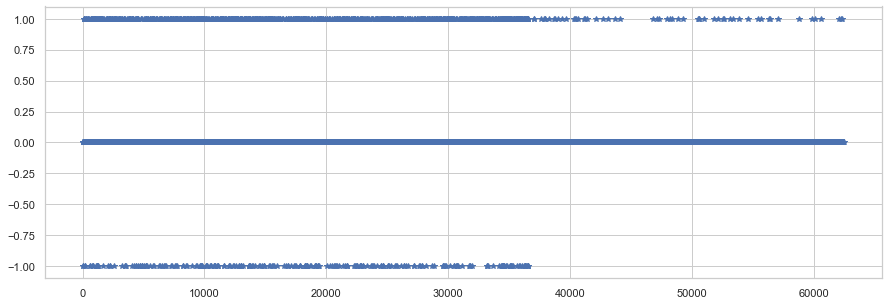

In [229]:
plt.figure(figsize=(15,5))
knn_errors = knn_predictions - y_test_res
plt.plot(knn_errors, '*')

In [230]:
knn_y_score=knn.predict_proba(X_test_res_s)[:, 1]
knn_auroc_score=metrics.roc_auc_score(y_test_res, knn_y_score)
print("KNN AUROC score : %s" % "{0:.3%}".format(knn_auroc_score))
knn_accuracy = metrics.accuracy_score(y_test_res, knn_predictions)
print("KNN SVM Accuracy : %s" % "{0:.3%}".format(knn_accuracy))
knn_precision=metrics.precision_score(y_test_res, knn_predictions)
print("KNN Precision : %s" % "{0:.3%}".format(knn_precision))
knn_recall=metrics.recall_score(y_test_res, knn_predictions)
print("KNN Sensitivity : %s" % "{0:.3%}".format(knn_recall))
knn_specificity = TN / float(TN + FP)
print('KNN Specificity : {0:.3%}'.format(knn_specificity))

KNN AUROC score : 93.498%
KNN SVM Accuracy : 90.211%
KNN Precision : 85.909%
KNN Sensitivity : 95.991%
KNN Specificity : 85.909%


## Porównanie modeli

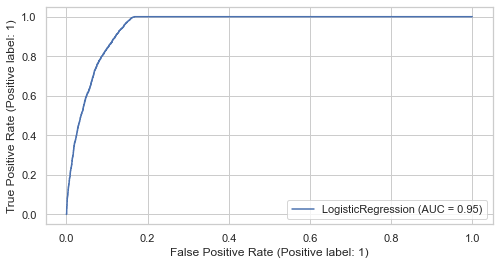

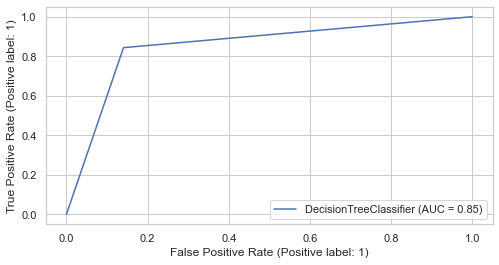

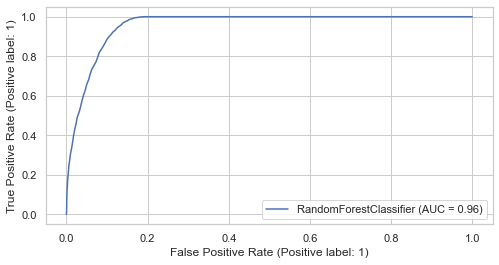

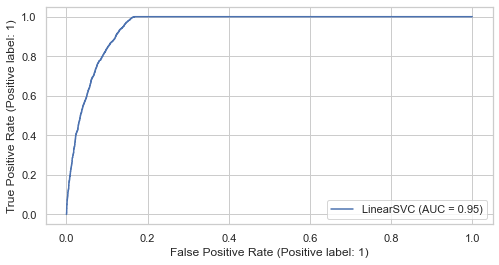

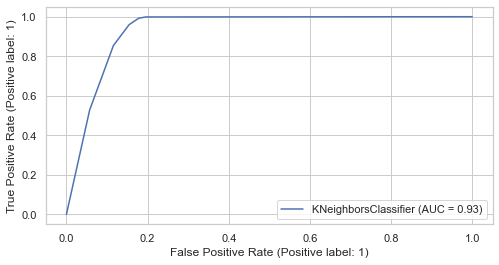

In [231]:
import matplotlib.pyplot as plt  
from sklearn import datasets, model_selection
from matplotlib import rcParams
rcParams['figure.figsize'] = 8,4
metrics.plot_roc_curve(logisticRegr,X_test_res_s, y_test_res)
metrics.plot_roc_curve(dtree, X_test_res_s, y_test_res)
metrics.plot_roc_curve(rf, X_test_res_s, y_test_res)
metrics.plot_roc_curve(lsvm, X_test_res_s, y_test_res)
metrics.plot_roc_curve(knn, X_test_res_s, y_test_res)

In [232]:
prediction_data={'Model':['Logistic Regression',
                          'Decision Tree',
                          'Decision Tree_2 (30:70)',
                          'Random Forest',
                          'Random Forest_2 (30:70)',
                          'Linear SVM',
                          'KNN'
                         ],
                   'AUROC score':[lr_auroc_score,
                              dt_auroc_score,
                              dt_2_auroc_score,
                              rf_auroc_score,
                              rf_2_auroc_score,
                              lsvm_auroc_score,
                              knn_auroc_score],
                 
                   'Accuracy':[lr_accuracy,
                              dt_accuracy,
                              dt_2_accuracy,
                              rf_accuracy,
                              rf_2_accuracy,
                              lsvm_accuracy,
                              knn_accuracy],
                 
                    'Precision':[lr_precision,
                              dt_precision,
                              dt_2_precision,
                              rf_precision,
                              rf_2_precision,
                              lsvm_precision,
                              knn_precision],
                 
                    'Sensitivity':[lr_recall,
                              dt_recall,
                              dt_2_recall,
                              rf_recall,
                              rf_2_recall,
                              lsvm_recall,
                              knn_recall],
                 
                    'Specificity':[lr_specificity,
                              dt_specificity,
                              dt_2_specificity,
                              rf_specificity,
                              rf_2_specificity,
                              lsvm_specificity,
                              knn_specificity],
                 
                    'Train Accuracy':[lr_train_score,
                              dtree_train_score,
                              dtree_2_train_score,
                              rf_train_score,
                              rf_2_train_score,
                              lsvm_train_score,
                              knn_train_score],
                 
                    }

prediction_table = pd.DataFrame(prediction_data)
prediction_table

,Model,AUROC score,Accuracy,Precision,Sensitivity,Specificity,Train Accuracy
0,Logistic Regression,0.950870,0.916053,0.857401,0.996282,0.857401,0.912308
1,Decision Tree,0.851338,0.851410,0.854825,0.843356,0.854825,1.000000
2,Decision Tree_2 (30:70),0.841354,0.841397,0.847028,0.831581,0.847028,1.000000
3,Random Forest,0.957839,0.914290,0.860485,0.987068,0.860485,1.000000
4,Random Forest_2 (30:70),0.956588,0.909431,0.857022,0.981871,0.857022,1.000000
5,Linear SVM,0.951016,0.915171,0.854613,0.998707,0.854613,0.912508
6,KNN,0.934983,0.902115,0.859086,0.959909,0.859086,0.921740


## c. Porównanie modeli na zredukowanych danych - PCA

### Redukacja wymiarów danych po zbalansowaniu i standaryzacji z użyciem PCA na zbiorze treningowym

In [233]:
from sklearn.decomposition import PCA
pca = PCA(random_state=42)
pca.fit(X_train_res_s)

PCA(random_state=42)

In [234]:
#ile zmienności wyjaśniają uzyskane kompontenty
var_cumu = np.cumsum(pca.explained_variance_ratio_)
var_cumu

array([0.04551392, 0.08749912, 0.11287504, 0.13373901, 0.15210751,
       0.16813848, 0.18337722, 0.19677938, 0.20974906, 0.22241452,
       0.23470906, 0.24676021, 0.25853871, 0.27031157, 0.2819267 ,
       0.29353001, 0.30508608, 0.31647502, 0.32783403, 0.33914438,
       0.35043062, 0.36169488, 0.37291495, 0.38408558, 0.39524004,
       0.40633476, 0.41739787, 0.42843494, 0.43946263, 0.45047639,
       0.46144874, 0.47239058, 0.48332004, 0.49422386, 0.50510928,
       0.51599277, 0.52685983, 0.5377199 , 0.54856931, 0.55941593,
       0.57024885, 0.58107703, 0.59189779, 0.60271593, 0.61352501,
       0.62432836, 0.63512564, 0.64591646, 0.65670106, 0.66748272,
       0.67825908, 0.68903256, 0.69979658, 0.71055554, 0.7213098 ,
       0.73204812, 0.74277454, 0.75349015, 0.76417543, 0.77484036,
       0.78546879, 0.79600827, 0.80653945, 0.81703532, 0.82752116,
       0.83794758, 0.84835187, 0.85868318, 0.86894163, 0.87917288,
       0.88931516, 0.89942025, 0.90940151, 0.91930408, 0.92915

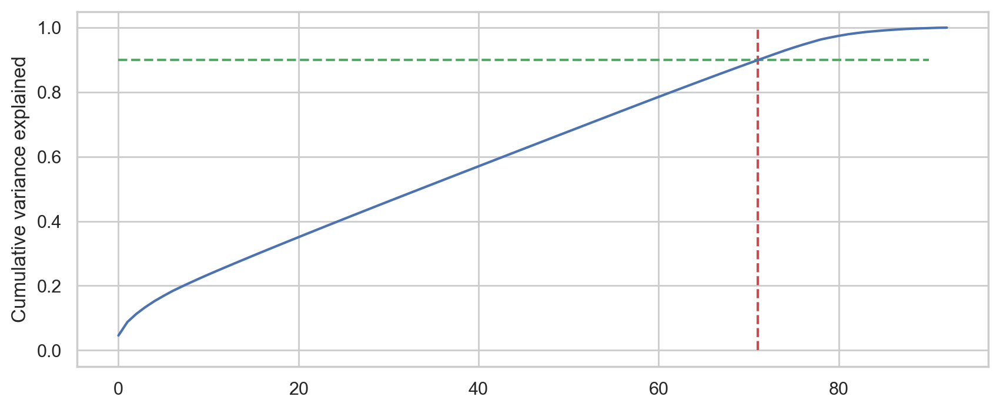

In [235]:
fig = plt.figure(figsize=[10,4],dpi=200)
plt.vlines(x=71, ymax=1, ymin=0, colors="r", linestyles="--")
plt.hlines(y=0.90, xmax=90, xmin=0, colors="g", linestyles="--")
plt.plot(var_cumu)
plt.ylabel("Cumulative variance explained")
plt.show()

In [236]:
from sklearn.decomposition import IncrementalPCA
pca_models = IncrementalPCA(n_components=71)
X_train_res_s_pca = pca_models.fit_transform(X_train_res_s)

In [237]:
X_test_res_s_pca = pca_models.transform(X_test_res_s)

In [238]:
#Redukacja do 69 kolumn wyjaśni nam ok 90% zmienności
# Explaining the Variance ratio
print('Explained variation per principal component: {}'.format(pca_models.explained_variance_ratio_.sum()))

Explained variation per principal component: 0.8779102669593672


In [239]:
print(X_train_res_s.shape)
print(X_train_res_s_pca.shape)

(49936, 93)
(49936, 71)


In [240]:
print(X_test_res_s.shape)
print(X_test_res_s_pca.shape)

(12484, 93)
(12484, 71)


In [241]:
X_train_res_s_pca_df = pd.DataFrame(X_train_res_s_pca,columns=['PC1','PC2','PC3','PC4','PC5','PC6','PC7','PC8', 'PC9','PC10','PC11','PC12', 'PC13','PC14','PC15','PC16','PC17','PC18','PC19','PC20', 'PC21','PC22','PC23','PC24', 'PC25','PC26','PC27','PC28','PC29','PC30','PC31','PC32','PC33','PC34','PC35','PC36','PC37','PC38', 'PC39','PC40','PC41','PC42', 'PC43','PC44','PC45','PC46','PC47','PC48','PC49','PC50', 'PC51','PC52','PC53','PC54', 'PC55','PC56','PC57','PC58','PC59','PC60','PC61','PC62','PC63','PC64','PC65','PC66','PC67','PC68','PC69', 'PC70','PC71'])

In [242]:
X_train_res_s_pca_df.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,...,PC62,PC63,PC64,PC65,PC66,PC67,PC68,PC69,PC70,PC71
0,-1.952468,0.962558,1.151443,-2.043897,1.418225,-0.535999,0.356225,-0.173470,-0.653659,0.798821,...,0.456671,0.363411,-0.311828,-0.526231,0.920910,0.565973,-0.161789,-0.079877,-0.826912,0.235738
1,0.239842,-5.085112,-1.724417,1.057808,-1.573454,0.027352,-0.401558,0.907145,-0.195035,-1.707158,...,3.429200,-1.623761,1.466694,-1.049031,0.402499,0.118495,-1.321107,-0.384606,0.935712,0.152508
2,0.232077,-2.080566,-0.274787,2.914033,0.034992,-1.307511,-1.235981,0.267699,2.303673,3.091441,...,-1.143333,2.453072,0.973317,1.487599,-0.445632,0.198660,0.288169,0.545244,0.404451,0.015723
3,4.326205,0.994715,-0.369910,-0.587299,0.222727,-0.068468,-1.431407,1.201085,0.143768,0.279144,...,1.135153,1.042685,-0.108322,0.062656,-0.627671,-0.257789,0.440972,0.492761,0.210028,-0.656155
4,-2.169746,0.308714,-2.750465,-0.592981,1.645855,-0.800672,1.286849,1.076348,-1.614182,-0.938650,...,0.034289,-0.126994,0.069670,-0.141274,0.146067,-0.022924,-0.467461,-0.146229,-0.511654,0.028937


In [243]:
X_test_res_s_pca_df = pd.DataFrame(X_test_res_s_pca,columns=['PC1','PC2','PC3','PC4','PC5','PC6','PC7','PC8', 'PC9','PC10','PC11','PC12', 'PC13','PC14','PC15','PC16','PC17','PC18','PC19','PC20', 'PC21','PC22','PC23','PC24', 'PC25','PC26','PC27','PC28','PC29','PC30','PC31','PC32','PC33','PC34','PC35','PC36','PC37','PC38', 'PC39','PC40','PC41','PC42', 'PC43','PC44','PC45','PC46','PC47','PC48','PC49','PC50', 'PC51','PC52','PC53','PC54', 'PC55','PC56','PC57','PC58','PC59','PC60','PC61','PC62','PC63','PC64','PC65','PC66','PC67','PC68','PC69', 'PC70','PC71'])

In [244]:
X_test_res_s_pca_df.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,...,PC62,PC63,PC64,PC65,PC66,PC67,PC68,PC69,PC70,PC71
0,1.494362,-3.021968,-0.638125,0.935618,2.550054,1.853490,-1.686036,0.575341,-1.064719,-0.876510,...,0.016211,-0.653965,-0.545542,0.023964,0.043331,0.099437,0.807340,1.495958,-0.769881,0.135440
1,-0.084742,-0.419834,-1.532187,-0.640093,1.371956,-0.568106,0.419406,0.332363,-1.494540,0.775099,...,-1.479791,0.288787,-1.275839,0.855613,-0.560479,0.018063,-0.277162,0.042775,0.982738,-0.919704
2,-0.276679,0.695459,1.919144,0.718275,0.414642,0.091305,0.529312,-2.329827,0.406016,1.141308,...,-0.265935,0.301580,0.047499,0.095745,-0.780479,0.270657,-0.424540,-0.426545,-0.314485,0.068631
3,1.836666,1.185896,2.017058,1.813576,1.610600,0.338271,-0.094085,-1.493426,0.656113,-0.141148,...,0.100296,-0.158178,0.203019,-0.196659,-0.402642,0.323257,0.465270,0.076821,0.414048,-0.955202
4,0.582990,0.586641,-0.193734,-1.096334,-0.653117,-1.100640,-1.420223,-0.522963,1.103869,-0.078750,...,0.012300,0.305035,-0.771864,-0.497359,0.161119,-0.142759,-0.672798,-1.181205,-0.192988,-0.403333


### Logistic Regression (LR ,Regresja logistyczna ) + PCA(71)

In [552]:
logisticRegr = LogisticRegression(max_iter=1000)
logisticRegr.fit(X_train_res_s_pca, y_train_res)
lr_pca_score = logisticRegr.score(X_test_res_s_pca, y_test_res)
print("Model_PCA score : %s" % "{0:.3%}".format(lr_pca_score))
lr_train_pca_score=logisticRegr.score(X_train_res_s_pca, y_train_res)
# performance on train data
print('Performance on training data using LR_PCA:',lr_train_pca_score)
# performance on test data
print('Performance on testing data using LR_PCA:',lr_pca_score)

lr_pca_predictions = logisticRegr.predict(X_test_res_s_pca)
cm = metrics.confusion_matrix(y_test_res, lr_pca_predictions)
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

lr_pca_y_score=logisticRegr.predict_proba(X_test_res_s_pca)[:, 1]
lr_pca_auroc_score=metrics.roc_auc_score(y_test_res, lr_pca_y_score)
print("LR_PCA AUROC score : %s" % "{0:.3%}".format(lr_pca_auroc_score))
lr_pca_accuracy = metrics.accuracy_score(y_test_res, lr_pca_predictions)
print("LR_PCA Accuracy : %s" % "{0:.3%}".format(lr_pca_accuracy))
lr_pca_precision=metrics.precision_score(y_test_res, lr_pca_predictions)
print("LR_PCA Precision : %s" % "{0:.3%}".format(lr_pca_precision))
lr_pca_recall=metrics.recall_score(y_test_res, lr_pca_predictions)
print("LR_PCA Sensitivity : %s" % "{0:.3%}".format(lr_pca_recall))
lr_pca_specificity = TN / float(TN + FP)
print('LR_PCA Specificity : {0:.3%}'.format(lr_pca_specificity))

Model_PCA score : 90.588%
Performance on training data using LR_PCA: 0.9022148349887856
Performance on testing data using LR_PCA: 0.905879525793015
LR_PCA AUROC score : 94.336%
LR_PCA Accuracy : 90.588%
LR_PCA Precision : 85.859%
LR_PCA Sensitivity : 96.977%
LR_PCA Specificity : 85.859%


### Decision Tree (DT, Drzewo decyzyjne)+ PCA(71)

In [553]:
dtree = DecisionTreeClassifier()
dtree.fit(X_train_res_s_pca, y_train_res)
dtree_pca_score = dtree.score(X_test_res_s_pca, y_test_res)
print("Model_PCA score : %s" % "{0:.3%}".format(dtree_pca_score))
dtree_train_pca_score=dtree.score(X_train_res_s_pca, y_train_res)
# performance on train data
print('Performance on training data using DT_PCA:',dtree_train_pca_score)
# performance on test data
print('Performance on testing data using DT_PCA:',dtree_pca_score)

dt_pca_predictions = dtree.predict(X_test_res_s_pca)
cm = metrics.confusion_matrix(y_test_res, dt_pca_predictions)
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

dt_pca_y_score=dtree.predict_proba(X_test_res_s_pca)[:, 1]
dt_pca_auroc_score=metrics.roc_auc_score(y_test_res, dt_pca_y_score)
print("DT_PCA AUROC score : %s" % "{0:.3%}".format(dt_pca_auroc_score))
dt_pca_accuracy = metrics.accuracy_score(y_test_res, dt_pca_predictions)
print("DT_PCA Accuracy : %s" % "{0:.3%}".format(dt_pca_accuracy))
dt_pca_precision=metrics.precision_score(y_test_res, dt_pca_predictions)
print("DT_PCA Precision : %s" % "{0:.3%}".format(dt_pca_precision))
dt_pca_recall=metrics.recall_score(y_test_res, dt_pca_predictions,)
print("DT_PCA Sensitivity : %s" % "{0:.3%}".format(dt_pca_recall))
dt_pca_specificity = TN / float(TN + FP)
print('DT_PCA Specificity : {0:.3%}'.format(dt_pca_specificity))

Model_PCA score : 83.851%
Performance on training data using DT_PCA: 1.0
Performance on testing data using DT_PCA: 0.8385132970201858
DT_PCA AUROC score : 83.833%
DT_PCA Accuracy : 83.851%
DT_PCA Precision : 85.018%
DT_PCA Sensitivity : 81.830%
DT_PCA Specificity : 85.018%


### Random Forest (RF, Las losowy)+ PCA(71)

In [556]:
rf = RandomForestClassifier(n_estimators=100)
rf.fit(X_train_res_s_pca, y_train_res)
rf_pca_score = rf.score(X_test_res_s_pca, y_test_res)
print("Model_PCA score : %s" % "{0:.3%}".format(rf_pca_score))
rf_train_pca_score=rf.score(X_train_res_s_pca, y_train_res)
# performance on train data
print('Performance on training data using RF_PCA:',rf_train_pca_score)
# performance on test data
print('Performance on testing data using RF_PCA:',rf_pca_score)

rf_pca_predictions = rf.predict(X_test_res_s_pca)
cm = metrics.confusion_matrix(y_test_res, rf_pca_predictions)
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

rf_pca_y_score=rf.predict_proba(X_test_res_s_pca)[:, 1]
rf_pca_auroc_score=metrics.roc_auc_score(y_test_res, rf_pca_y_score)
print("RF_PCA AUROC score : %s" % "{0:.3%}".format(rf_pca_auroc_score))
rf_pca_accuracy = metrics.accuracy_score(y_test_res, rf_pca_predictions)
print("RF_PCA Accuracy : %s" % "{0:.3%}".format(rf_pca_accuracy))
rf_pca_precision=metrics.precision_score(y_test_res, rf_pca_predictions)
print("RF_PCA Precision : %s" % "{0:.3%}".format(rf_pca_precision))
rf_pca_recall=metrics.recall_score(y_test_res, rf_pca_predictions)
print("RF_PCA Sensitivity : %s" % "{0:.3%}".format(rf_pca_recall))
rf_pca_specificity = TN / float(TN + FP)
print('RF_PCA Specificity : {0:.3%}'.format(rf_pca_specificity))

Model_PCA score : 90.732%
Performance on training data using RF_PCA: 1.0
Performance on testing data using RF_PCA: 0.9073213713553349
RF_PCA AUROC score : 94.174%
RF_PCA Accuracy : 90.732%
RF_PCA Precision : 84.793%
RF_PCA Sensitivity : 99.062%
RF_PCA Specificity : 84.793%


### Support Vector Machines (SVM, Maszyna wektorów nośnych) + PCA (71)

In [557]:
licznik_start = time.time()

lsvm = LinearSVC(dual = False)
lsvm.fit(X_train_res_s_pca, y_train_res)
lsvm_pca_score = lsvm.score(X_test_res_s_pca, y_test_res)
print("Model_PCA score : %s" % "{0:.3%}".format(lsvm_pca_score))
lsvm_train_pca_score=lsvm.score(X_train_res_s_pca,y_train_res)
# performance on train data
print('Performance on training data using LinearSVM_PCA:',lsvm_train_pca_score)
# performance on test data
print('Performance on testing data using LinearSVM_PCA:',lsvm_pca_score)

print("Work time [min]: ", (time.time() - licznik_start)/60)

lsvm_pca_predictions = lsvm.predict(X_test_res_s_pca)
cm = metrics.confusion_matrix(y_test_res, lsvm_pca_predictions)
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]


#lsvm_y_score=lsvm.predict_proba(X_test_res_s)[:, 1] --> dla linear svm nie działa predict_proba
lsvm_pca_auroc_score=metrics.roc_auc_score(y_test_res,lsvm.decision_function(X_test_res_s_pca))
print("Linear SVM_PCA AUROC score : %s" % "{0:.3%}".format(lsvm_pca_auroc_score))
lsvm_pca_accuracy = metrics.accuracy_score(y_test_res, lsvm_pca_predictions)
print("Linear SVM_PCA Accuracy : %s" % "{0:.3%}".format(lsvm_pca_accuracy))
lsvm_pca_precision=metrics.precision_score(y_test_res, lsvm_pca_predictions)
print("Linear SVM_PCA Precision : %s" % "{0:.3%}".format(lsvm_pca_precision))
lsvm_pca_recall=metrics.recall_score(y_test_res, lsvm_pca_predictions)
print("Linear SVM_PCA Sensitivity : %s" % "{0:.3%}".format(lsvm_pca_recall))
lsvm_pca_specificity = TN / float(TN + FP)
print('Linear SVM_PCA Specificity : {0:.3%}'.format(lsvm_pca_specificity))

Model_PCA score : 90.812%
Performance on training data using LinearSVM_PCA: 0.9053989106055751
Performance on testing data using LinearSVM_PCA: 0.9081223966677348
Work time [min]:  0.040829201539357506
Linear SVM_PCA AUROC score : 94.467%
Linear SVM_PCA Accuracy : 90.812%
Linear SVM_PCA Precision : 85.233%
Linear SVM_PCA Sensitivity : 98.529%
Linear SVM_PCA Specificity : 85.233%


### K Nearest Neighbors (KNN, k-Najbliższych sąsiadów) + PCA(71)

In [558]:
knn = KNeighborsClassifier()
knn.fit(X_train_res_s_pca, y_train_res)
knn_pca_score = knn.score(X_test_res_s_pca, y_test_res)
print("Model_PCA score : %s" % "{0:.3%}".format(knn_pca_score))
knn_train_pca_score=knn.score(X_train_res_s_pca,y_train_res)
# performance on train data
print('Performance on training data using KNN_PCA:',knn_train_pca_score)
# performance on test data
print('Performance on testing data using KNN_PCA:',knn_pca_score)

knn_pca_predictions = knn.predict(X_test_res_s_pca)
cm = metrics.confusion_matrix(y_test_res, knn_pca_predictions)
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

knn_pca_y_score=knn.predict_proba(X_test_res_s_pca)[:, 1]
knn_pca_auroc_score=metrics.roc_auc_score(y_test_res, knn_pca_y_score)
print("KNN_PCA AUROC score : %s" % "{0:.3%}".format(knn_pca_auroc_score))
knn_pca_accuracy = metrics.accuracy_score(y_test_res, knn_pca_predictions)
print("KNN_PCA SVM Accuracy : %s" % "{0:.3%}".format(knn_pca_accuracy))
knn_pca_precision=metrics.precision_score(y_test_res, knn_pca_predictions)
print("KNN_PCA Precision : %s" % "{0:.3%}".format(knn_pca_precision))
knn_pca_recall=metrics.recall_score(y_test_res, knn_pca_predictions)
print("KNN_PCA Sensitivity : %s" % "{0:.3%}".format(knn_pca_recall))
knn_pca_specificity = TN / float(TN + FP)
print('KNN_PCA Specificity : {0:.3%}'.format(knn_pca_specificity))


Model_PCA score : 89.963%
Performance on training data using KNN_PCA: 0.9209788529317526
Performance on testing data using KNN_PCA: 0.899631528356296
KNN_PCA AUROC score : 93.315%
KNN_PCA SVM Accuracy : 89.963%
KNN_PCA Precision : 85.835%
KNN_PCA Sensitivity : 95.506%
KNN_PCA Specificity : 85.835%


### Porównanie modeli pracujących na zredukowanych danych (PCA71)

In [605]:
pca71={'Model':['Logistic Regression_PCA71',
                          'Decision Tree_PCA71',
                          'Random Forest_PCA71',
                          'Linear SVM_PCA71',
                          'KNN_PCA71'
                         ],
                   'AUROC score':[lr_pca_auroc_score,
                              dt_pca_auroc_score,
                              rf_pca_auroc_score,
                              lsvm_pca_auroc_score,
                              knn_pca_auroc_score],
                 
                   'Accuracy':[lr_pca_accuracy,
                              dt_pca_accuracy,
                              rf_pca_accuracy,
                              lsvm_pca_accuracy,
                              knn_pca_accuracy],
                 
                    'Precision':[lr_pca_precision,
                              dt_pca_precision,
                              rf_pca_precision,
                              lsvm_pca_precision,
                              knn_pca_precision],
                 
                    'Sensitivity':[lr_pca_recall,
                              dt_pca_recall,
                              rf_pca_recall,
                              lsvm_pca_recall,
                              knn_pca_recall],
                 
                    'Specificity':[lr_pca_specificity,
                              dt_pca_specificity,
                              rf_pca_specificity,
                              lsvm_pca_specificity,
                              knn_pca_specificity],
                 
                    'Train Accuracy':[lr_train_pca_score,
                              dtree_train_pca_score,
                              rf_train_pca_score,
                              lsvm_train_pca_score,
                              knn_train_pca_score],
                 
                    }

pca71 = pd.DataFrame(pca71)
prediction_table  = prediction_table.append(pca71, ignore_index=True)
prediction_table 

,Model,AUROC score,Accuracy,Precision,Sensitivity,Specificity,Train Accuracy
0,Logistic Regression,0.950881,0.916053,0.857401,0.996282,0.857401,0.912348
1,Decision Tree,0.846911,0.847004,0.851992,0.836566,0.851992,1.000000
2,Decision Tree_2 (30:70),0.844396,0.844441,0.850487,0.834156,0.850487,1.000000
3,Random Forest,0.957538,0.913649,0.861143,0.984481,0.861143,1.000000
4,Random Forest_2 (30:70),0.956973,0.910873,0.858119,0.983587,0.858119,1.000000
5,Linear SVM,0.950988,0.915171,0.854613,0.998707,0.854613,0.912508
6,KNN,0.935492,0.902675,0.860165,0.959586,0.860165,0.921700
7,Logistic Regression_PCA71,0.943363,0.905880,0.858595,0.969770,0.858595,0.902215
8,Decision Tree_PCA71,0.838334,0.838513,0.850185,0.818299,0.850185,1.000000
9,Random Forest_PCA71,0.941743,0.907321,0.847931,0.990624,0.847931,1.000000


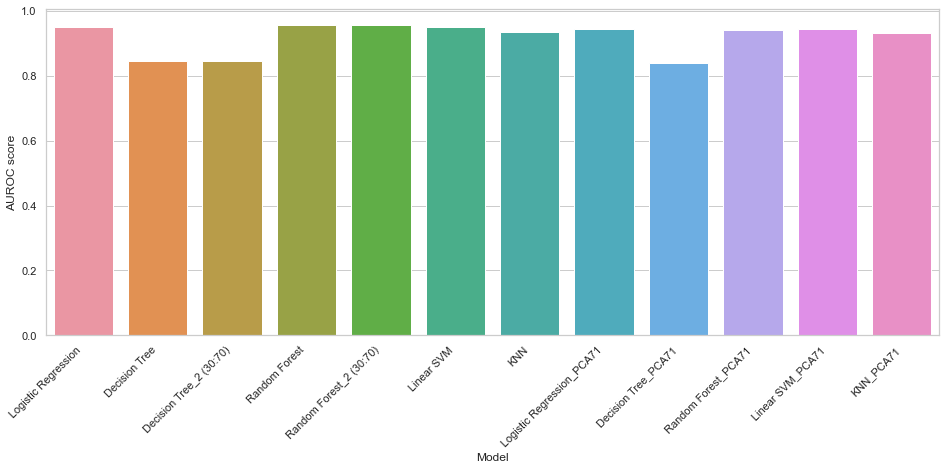

In [615]:
plt.figure(figsize=(16, 6))
ax=sns.barplot(x=prediction_table['Model'], y=prediction_table['AUROC score'])
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right');
    #fontsize = 10);

In [ ]:
#zastosowanie zredukowanych danych spowodowało niewielkie pogorszenie wyników, jeśli chodzi o AUROC score i Accuracy:
# o 1-2%, natomiast dla Precision, Sensitivity czy Specificity różnice te są nawet mniejsze. To nadal bardzo dobre wyniki,
#natomiast te modele nie liczą się zbyt długo, więc kwestia tu na czym nam zalezy bardzije - czy na jak najwyższym wyniku
#czy na jak najszybszym liczeniu. Oba podejścia są ok.

## d. Wybór ostatecznego modelu i dostrojenie go 

In [ ]:
#na tym etapie biorąc pod uwagę dokładność i inne parametry oraz czas działania, wybieram do dalszej optymalizacji 
#Regresję logistyczną, drzewo decyzyjne i Random Forest - dla nich zrobię kroswalidację k-Fold, a potem optymalizację parametrów

#muszę uważać na standaryzację danych przy kroswalidacji - powinna ona być robiona po każdym podziale na zbiór testowy
#i treningowy, a zatem operować na wejściu trzeba danymi nieprzeskalowanymi - aby wziąć to pod uwagę, użyję pipeline 
#(artykuł: https://towardsdatascience.com/pre-process-data-with-pipeline-to-prevent-data-leakage-during-cross-validation-e3442cca7fdc)

### Logistic Regression (LR ,Regresja logistyczna ) + kroswalidacja k-Fold i Stratified k-Fold

In [336]:
from sklearn.model_selection import KFold
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import cross_val_score
from sklearn import pipeline
from sklearn import preprocessing

kfold = KFold(n_splits=10,shuffle=True, random_state=42)
logisticRegr_kfold = pipeline.make_pipeline(preprocessing.StandardScaler(), LogisticRegression(solver='lbfgs',max_iter=500))
results = cross_val_score(logisticRegr_kfold,X_res, y_res, cv=kfold)
accuracy=np.mean(abs(results))
print('LR with k-Fold Average Accuracy: ',accuracy)
print('LR with k-Fold Standard Deviation: ',results.std())

skfold = StratifiedKFold(n_splits=10,shuffle=True, random_state=42)
logisticRegr_skfold = pipeline.make_pipeline(preprocessing.StandardScaler(), LogisticRegression(solver='lbfgs',max_iter=500))
results2 = cross_val_score(logisticRegr_skfold,X_res, y_res, cv=skfold)
accuracy=np.mean(abs(results2))
print('LR with Stratified k-Fold Average Accuracy: ',accuracy)
print('LR with Stratified k-Fold k-Fold Standard Deviation: ',results2.std())

LR with k-Fold Average Accuracy:  0.9128644665171421
LR with k-Fold Standard Deviation:  0.0030214267048045153
LR with Stratified k-Fold Average Accuracy:  0.9127042614546619
LR with Stratified k-Fold k-Fold Standard Deviation:  0.0019964019281812203


In [355]:
#multi-metrics to evaluete crossvalidation - cross_validation zamiast cros_val_score
from sklearn.model_selection import cross_validate
from sklearn.model_selection import cross_val_predict
results3m = cross_validate(logisticRegr_skfold,X_res, y_res, cv=skfold, scoring = ['roc_auc','accuracy','precision', 'recall']
                           ,return_train_score=True)
logisticRegr_skfold_auroc_score = np.mean(results3m['test_roc_auc'])
logisticRegr_skfold_accuracy = np.mean(results3m['test_accuracy'])
logisticRegr_skfold_precision = np.mean(results3m['test_precision'])
logisticRegr_skfold_recall = np.mean(results3m['test_recall'])

print("LR with Stratified k-Fold average AUROC score : %s" % "{0:.3%}".format(logisticRegr_skfold_auroc_score))
print("LR with Stratified k-Fold average Accuracy : %s" % "{0:.3%}".format(logisticRegr_skfold_accuracy))
print("LR with Stratified k-Fold average Precision : %s" % "{0:.3%}".format(logisticRegr_skfold_precision))
print("LR with Stratified k-Fold average Sensitivity : %s" % "{0:.3%}".format(logisticRegr_skfold_recall))

#specificity nie jest dostępne jako metryka w cross_validate, dlatego jako jedyną liczę ją na podstawie predykcji 
#(predykcje przy kroswalidacji nie są polecane do wyliczania metryk - zgdonie z dokumentacją: Passing these 
#predictions into an evaluation metric may not be a valid way to measure generalization performance. Dlatego też do
#reszty ważniejszych dla mnie metryk używam funkcji cross_validation)
logisticRegr_skfold_predictions = cross_val_predict(logisticRegr_skfold,X_res, y_res, cv=skfold)
cm = metrics.confusion_matrix(y_res, logisticRegr_skfold_predictions)
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

logisticRegr_skfold_specificity = TN / float(TN + FP)
print('LR with Stratified k-Fold average Specificity : {0:.3%}'.format(logisticRegr_skfold_specificity))

LR with Stratified k-Fold average AUROC score : 94.947%
LR with Stratified k-Fold average Accuracy : 91.270%
LR with Stratified k-Fold average Precision : 85.431%
LR with Stratified k-Fold average Sensitivity : 99.513%
LR with Stratified k-Fold average Specificity : 85.430%


In [341]:
logisticRegr_skfold_train_accuracy = np.mean(results3m['train_accuracy'])
print('LR with Stratified k-Fold average Train Accuracy : {0:.3%}'.format(logisticRegr_skfold_train_accuracy))

LR with Stratified k-Fold average Train Accuracy : 91.300%


In [ ]:
#regresja logistyczna jest dużo szybsza niż drzewo decyzyjne i las losowy, przy bardzo dobrych wynikach

### Drzewo Decyzyjne (DT , Drzewo decyzyjne ) + kroswalidacja k-Fold  i Stratified k-Fold

In [342]:
kfold = KFold(n_splits=10,shuffle=True, random_state=42)
dtree_kfold = pipeline.make_pipeline(preprocessing.StandardScaler(), DecisionTreeClassifier())
results = cross_val_score(dtree_kfold,X_res, y_res, cv=kfold)
accuracy=np.mean(abs(results))
print('DT with k-Fold Average Accuracy: ',accuracy)
print('DT with k-Fold Standard Deviation: ',results.std())

skfold = StratifiedKFold(n_splits=10,shuffle=True, random_state=42)
dtree_skfold = pipeline.make_pipeline(preprocessing.StandardScaler(), DecisionTreeClassifier())
results2 = cross_val_score(dtree_skfold,X_res, y_res, cv=skfold)
accuracy=np.mean(abs(results2))
print('DT with Stratified k-Fold Average Accuracy: ',accuracy)
print('DT with Stratified k-Fold k-Fold Standard Deviation: ',results2.std())

DT with k-Fold Average Accuracy:  0.8460749759692406
DT with k-Fold Standard Deviation:  0.0019683720030000207
DT with Stratified k-Fold Average Accuracy:  0.8454341557193207
DT with Stratified k-Fold k-Fold Standard Deviation:  0.0035864471542290275


In [343]:
#multi-metrics to evaluete crossvalidation - cross_validation zamiast cros_val_score
from sklearn.model_selection import cross_validate
results3m = cross_validate(dtree_skfold,X_res, y_res, cv=skfold, scoring = ['roc_auc','accuracy','precision', 'recall'],
                          return_train_score=True)
dtree_skfold_auroc_score = np.mean(results3m['test_roc_auc'])
dtree_skfold_accuracy = np.mean(results3m['test_accuracy'])
dtree_skfold_precision = np.mean(results3m['test_precision'])
dtree_skfold_recall = np.mean(results3m['test_recall'])

print("DT with Stratified k-Fold average AUROC score : %s" % "{0:.3%}".format(dtree_skfold_auroc_score))
print("DT with Stratified k-Fold average Accuracy : %s" % "{0:.3%}".format(dtree_skfold_accuracy))
print("DT with Stratified k-Fold average Precision : %s" % "{0:.3%}".format(dtree_skfold_precision))
print("DT with Stratified k-Fold average Sensitivity : %s" % "{0:.3%}".format(dtree_skfold_recall))

#specificity 
dtree_skfold_predictions = cross_val_predict(dtree_skfold,X_res, y_res, cv=skfold)
cm = metrics.confusion_matrix(y_res, dtree_skfold_predictions)
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

dtree_skfold_specificity = TN / float(TN + FP)
print('DT with Stratified k-Fold average Specificity : {0:.3%}'.format(dtree_skfold_specificity))

DT with Stratified k-Fold average AUROC score : 84.596%
DT with Stratified k-Fold average Accuracy : 84.596%
DT with Stratified k-Fold average Precision : 85.374%
DT with Stratified k-Fold average Sensitivity : 83.499%
DT with Stratified k-Fold average Specificity : 85.302%


In [344]:
dtree_skfold_train_accuracy = np.mean(results3m['train_accuracy'])
print('DT with Stratified k-Fold average Train Accuracy : {0:.3%}'.format(dtree_skfold_train_accuracy))

DT with Stratified k-Fold average Train Accuracy : 100.000%


### RandomForest (RF ,Las losowy ) + kroswalidacja k-Fold i Stratified k-Fold

In [383]:
kfold = KFold(n_splits=10,shuffle=True, random_state=42)
rf_kfold = pipeline.make_pipeline(preprocessing.StandardScaler(), RandomForestClassifier(n_estimators=100))
results = cross_val_score(rf_kfold,X_res, y_res, cv=kfold)
accuracy=np.mean(abs(results))
print('RF with k-Fold Average Accuracy: ',accuracy)
print('RF with k-Fold Standard Deviation: ',results.std())

skfold = StratifiedKFold(n_splits=10,shuffle=True, random_state=42)
rf_skfold = pipeline.make_pipeline(preprocessing.StandardScaler(), RandomForestClassifier(n_estimators=100))
results2 = cross_val_score(rf_skfold,X_res, y_res, cv=skfold)
accuracy=np.mean(abs(results2))
print('RF with Stratified k-Fold Average Accuracy: ',accuracy)
print('RF with Stratified k-Fold k-Fold Standard Deviation: ',results2.std())

RF with k-Fold Average Accuracy:  0.9131688561358539
RF with k-Fold Standard Deviation:  0.0027178258841074453
RF with Stratified k-Fold Average Accuracy:  0.9139378404357578
RF with Stratified k-Fold k-Fold Standard Deviation:  0.0023662672781335145


In [346]:
#multi-metrics to evaluete crossvalidation - cross_validation zamiast cros_val_score
from sklearn.model_selection import cross_validate
results3m = cross_validate(rf_skfold,X_res, y_res, cv=skfold, scoring = ['roc_auc','accuracy','precision', 'recall'],
                          return_train_score=True)
rf_skfold_auroc_score = np.mean(results3m['test_roc_auc'])
rf_skfold_accuracy = np.mean(results3m['test_accuracy'])
rf_skfold_precision = np.mean(results3m['test_precision'])
rf_skfold_recall = np.mean(results3m['test_recall'])

print("RF with Stratified k-Fold average AUROC score : %s" % "{0:.3%}".format(rf_skfold_auroc_score))
print("RF with Stratified k-Fold average Accuracy : %s" % "{0:.3%}".format(rf_skfold_accuracy))
print("RF with Stratified k-Fold average Precision : %s" % "{0:.3%}".format(rf_skfold_precision))
print("RF with Stratified k-Fold average Sensitivity : %s" % "{0:.3%}".format(rf_skfold_recall))

#specificity nie jest dostępne jako metryka w cross_validate, dlatego jako jedyną liczę ją na podstawie predykcji 
#(predykcje przy kroswalidacji nie są polecane do wyliczania metryk - zgdonie z dokumentacją: Passing these 
#predictions into an evaluation metric may not be a valid way to measure generalization performance. Dlatego też do
#reszty ważniejszych dla mnie metryk używam funkcji cross_validation)
rf_skfold_predictions = cross_val_predict(rf_skfold,X_res, y_res, cv=skfold)
cm = metrics.confusion_matrix(y_res, rf_skfold_predictions)
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

rf_skfold_specificity = TN / float(TN + FP)
print('RF_optimized with Stratified k-Fold Specificity : {0:.3%}'.format(rf_skfold_specificity))

RF with Stratified k-Fold average AUROC score : 95.717%
RF with Stratified k-Fold average Accuracy : 91.365%
RF with Stratified k-Fold average Precision : 86.137%
RF with Stratified k-Fold average Sensitivity : 98.600%
RF_optimized with Stratified k-Fold Specificity : 86.007%


In [347]:
rf_skfold_train_accuracy = np.mean(results3m['train_accuracy'])
print('RF with Stratified k-Fold average Train Accuracy : {0:.3%}'.format(rf_skfold_train_accuracy))

RF with Stratified k-Fold average Train Accuracy : 100.000%


In [348]:
#opis podjętych kroków: po uwzględnieniu kroswalidacji k-Fold z n_splits=5 na domyślnych parametrach wyniki (accuracy)
#nie były zadowalające - gorsze niż bez kroswalidacji, ale przy n_splits=10 i shuffle=True i były już porównywalne, 
#a zatem całkiem dobre, przy czym nadal najlepsze dla regresji logistycznej oraz random forest. Jeszczwe odrobinę lepsze
#uzyskuje się dla kroswalidacji Stratified k-Fold. Sprawdzam jeszcze krzywe uczenia.

### krzywe uczenia

In [349]:
## żródło: http://scikit-learn.org/stable/auto_examples/model_selection/plot_learning_curve.html
from sklearn.model_selection import learning_curve
def plot_learning_curve(estimator, title, X, y, ylim=None, cv=None,
                        n_jobs=1, train_sizes=np.linspace(.1, 1.0, 5)):
    """
    Generate a simple plot of the test and training learning curve.

    Parameters
    ----------
    estimator : object type that implements the "fit" and "predict" methods
        An object of that type which is cloned for each validation.

    title : string
        Title for the chart.

    X : array-like, shape (n_samples, n_features)
        Training vector, where n_samples is the number of samples and
        n_features is the number of features.

    y : array-like, shape (n_samples) or (n_samples, n_features), optional
        Target relative to X for classification or regression;
        None for unsupervised learning.

    ylim : tuple, shape (ymin, ymax), optional
        Defines minimum and maximum yvalues plotted.

    cv : int, cross-validation generator or an iterable, optional
        Determines the cross-validation splitting strategy.
        Possible inputs for cv are:
          - None, to use the default 3-fold cross-validation,
          - integer, to specify the number of folds.
          - An object to be used as a cross-validation generator.
          - An iterable yielding train/test splits.

        For integer/None inputs, if ``y`` is binary or multiclass,
        :param train_sizes:
        :class:`StratifiedKFold` used. If the estimator is not a classifier
        or if ``y`` is neither binary nor multiclass, :class:`KFold` is used.

        Refer :ref:`User Guide <cross_validation>` for the various
        cross-validators that can be used here.

    n_jobs : integer, optional
        Number of jobs to run in parallel (default 1).
    """
    plt.figure()
    plt.title(title)
    if ylim is not None:
        plt.ylim(*ylim)
    plt.xlabel("Training examples")
    plt.ylabel("Score")
    train_sizes, train_scores, test_scores = learning_curve(
        estimator, X_res, y_res, cv=cv, n_jobs=n_jobs, train_sizes=train_sizes)
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)
    plt.grid()

    plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                     train_scores_mean + train_scores_std, alpha=0.1,
                     color="r")
    plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                     test_scores_mean + test_scores_std, alpha=0.1, color="g")
    plt.plot(train_sizes, train_scores_mean, 'o-', color="r",
             label="Training score")
    plt.plot(train_sizes, test_scores_mean, 'o-', color="g",
             label="Cross-validation score")

    plt.legend(loc="best")
    return plt

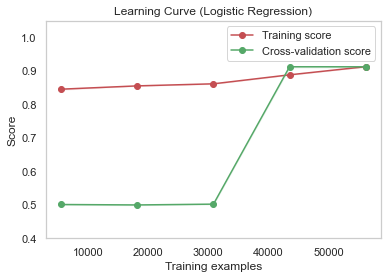

In [350]:
plot_learning_curve(logisticRegr_skfold, 'Learning Curve (Logistic Regression)', X_res, y_res, (0.4, 1.05), cv=skfold, n_jobs=4)
plt.show()

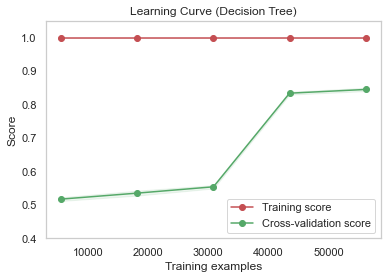

In [351]:
plot_learning_curve(dtree_skfold, 'Learning Curve (Decision Tree)', X_res, y_res, (0.4, 1.05), cv=skfold, n_jobs=4)
plt.show()

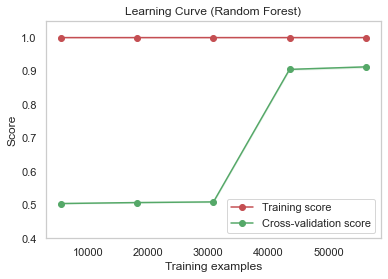

In [352]:
plot_learning_curve(rf_skfold, 'Learning Curve (Random Forest)', X_res, y_res, (0.4, 1.05), cv=skfold, n_jobs=4)
plt.show()

In [ ]:
#z krzywych uczenia wynika, że po połowie próbek model zaczyna minimalizwować błąd. Dla regresji logistycznej
#dokładności dla zbiorów testowych i treningowych są bardzo podobne, natomiast dla drzewa decyzyjnego i lasu losowego 
#jest między nimi różnica, bo modele te uczą się z dokładnością 1, bardzo dobrze dopasowując się na zbiorze trenignowym
#myślę, że te różnice uda się zminimalizować optymalizacją parametrów z pomocą RandomizedSearchCV 

In [616]:
#porównanie 
skfolds = {'Model':['Logistic Regression Sk-Fold',
                          'Decision Tree Sk-Fold',
                          'Random Forest Sk-Fold',],
           
                 'AUROC score':[logisticRegr_skfold_auroc_score,
                              dtree_skfold_auroc_score,
                              rf_skfold_auroc_score],
                 
                   'Accuracy':[logisticRegr_skfold_accuracy,
                              dtree_skfold_accuracy,
                              rf_skfold_accuracy],
                 
                    'Precision':[logisticRegr_skfold_precision,
                              dtree_skfold_precision,
                              rf_skfold_precision],
                 
                    'Sensitivity':[logisticRegr_skfold_recall,
                              dtree_skfold_recall,
                              rf_skfold_recall],
                 
                    'Specificity':[logisticRegr_skfold_specificity,
                              dtree_skfold_specificity,
                              rf_skfold_specificity],
           
                'Train Accuracy':[logisticRegr_skfold_train_accuracy ,
                              dtree_skfold_train_accuracy,
                              rf_skfold_train_accuracy]
                 
                    }

skfolds = pd.DataFrame(skfolds)

#append rows to the dataframe
prediction_table  = prediction_table.append(skfolds, ignore_index=True)
prediction_table 

,Model,AUROC score,Accuracy,Precision,Sensitivity,Specificity,Train Accuracy
0,Logistic Regression,0.950881,0.916053,0.857401,0.996282,0.857401,0.912348
1,Decision Tree,0.846911,0.847004,0.851992,0.836566,0.851992,1.000000
2,Decision Tree_2 (30:70),0.844396,0.844441,0.850487,0.834156,0.850487,1.000000
3,Random Forest,0.957538,0.913649,0.861143,0.984481,0.861143,1.000000
4,Random Forest_2 (30:70),0.956973,0.910873,0.858119,0.983587,0.858119,1.000000
5,Linear SVM,0.950988,0.915171,0.854613,0.998707,0.854613,0.912508
6,KNN,0.935492,0.902675,0.860165,0.959586,0.860165,0.921700
7,Logistic Regression_PCA71,0.943363,0.905880,0.858595,0.969770,0.858595,0.902215
8,Decision Tree_PCA71,0.838334,0.838513,0.850185,0.818299,0.850185,1.000000
9,Random Forest_PCA71,0.941743,0.907321,0.847931,0.990624,0.847931,1.000000


In [617]:
#poszczególne "etapy" wybierania modelu i osiągane wyniki doklejam do całościowej tabeli pod samodzielnymi nazwami,
#tak, aby każdy "etap" móc sobie wywołać samodzielnie
skfolds

,Model,AUROC score,Accuracy,Precision,Sensitivity,Specificity,Train Accuracy
0,Logistic Regression Sk-Fold,0.949470,0.912704,0.854307,0.995130,0.854298,0.912998
1,Decision Tree Sk-Fold,0.845963,0.845963,0.853739,0.834989,0.853017,1.000000
2,Random Forest Sk-Fold,0.957169,0.913649,0.861374,0.985998,0.860070,1.000000


In [ ]:
#na podstawie wyników parametru auroc score, który jest parametrem decyzyjnym w projekcie, jako finalny model wybieram
#random forest i dla niego będę optymalizować parametry z użyciem RandomizedSearchCV, a następnie badać istotne zmienne,
#na koniec sprawdzę jeszcze jego skuteczność na zredukowanych danych 

### Optymalizacja parametrów modelu Random Forest

#### RandomForest (RF ,Las losowy) + kroswalidacja Stratified k-Fold + RandomizedSearchCV_1

In [344]:
from sklearn.model_selection import RandomizedSearchCV

In [360]:
import time
licznik_start = time.time()

model=RandomForestClassifier()

cv=StratifiedKFold(n_splits=10,shuffle=True, random_state=42)

params = {'n_estimators': np.arange(50,500,50),
              'max_features' : ['auto', 'sqrt'],
              'min_samples_leaf': [1,2,5,20],
              'min_samples_split': [2, 5, 10],
              'max_depth' : np.arange(5,100,5),
              'max_leaf_nodes': np.arange(2,10,2),
             }

# konfiguracja procesu przetestowania siatki parametrów
process = pipeline.make_pipeline(StandardScaler(), RandomizedSearchCV(model, params, 
                                 cv = cv, verbose = 5, scoring = 'roc_auc', n_iter = 10, return_train_score = True, 
                                 n_jobs = -1))
# nauczanie modelu
process.fit(X_res, y_res)

print("Czas pracy [min]: ", (time.time() - licznik_start)/60)
#Czas pracy przy n_iter=100 [min]:  60.75990444819133
#Czas pracy przy n_iter=10 [min]:  7.76
#wyniki porównywalne


Fitting 10 folds for each of 10 candidates, totalling 100 fits
Czas pracy [min]:  7.766347952683767


In [431]:
# pobranie wyników procesu - RandomizedSearchCV
process_effect=process.named_steps["randomizedsearchcv"]

best_params = process_effect.best_params_
best_estimator = process_effect.best_estimator_
best_score = process_effect.best_score_

print('The best fitted parameters for Random Forest are: ' +str(best_params))
print('The best fitted estimator is: ' +str(best_estimator))
print('They allow to achieve the best auroc_score: ',best_score)

The best fitted parameters for Random Forest are: {'n_estimators': 250, 'min_samples_split': 5, 'min_samples_leaf': 20, 'max_leaf_nodes': 8, 'max_features': 'auto', 'max_depth': 75}
The best fitted estimator is: RandomForestClassifier(max_depth=75, max_leaf_nodes=8, min_samples_leaf=20,
                       min_samples_split=5, n_estimators=250)
They allow to achieve the best auroc_score:  0.8972969181391657


In [427]:
#sprawdzenie błędów na zbiorze treningowym
trening_score = np.mean(abs(process_effect.cv_results_['mean_train_score']))
print('Mean training auroc_score for Random Forest_optimized:',trening_score)
testing_score = np.mean(abs(process_effect.cv_results_['mean_test_score']))
print('Mean testing auroc_score for Random Forest_optimized:',testing_score)

Mean training auroc_score for Random Forest_optimized: 0.8718415276523472
Mean testing auroc_score for Random Forest_optimized: 0.8712326201119618


In [420]:
#multi-metrics to evaluete crossvalidation - cross_validation zamiast cros_val_score
from sklearn.model_selection import cross_validate

skfold = StratifiedKFold(n_splits=10,shuffle=True, random_state=42)
rf_skfold_opt = pipeline.make_pipeline(preprocessing.StandardScaler(), RandomForestClassifier(n_estimators=250,
                                     min_samples_split=5,min_samples_leaf=20,max_leaf_nodes=8,max_features='sqrt',max_depth=75))

results3m = cross_validate(rf_skfold_opt,X_res, y_res, cv=skfold, scoring = ['roc_auc','accuracy','precision', 'recall'],
                          return_train_score=True)
rf_skfold_opt_auroc_score = np.mean(results3m['test_roc_auc'])
rf_skfold_opt_accuracy = np.mean(results3m['test_accuracy'])
rf_skfold_opt_precision = np.mean(results3m['test_precision'])
rf_skfold_opt_recall = np.mean(results3m['test_recall'])

print("RF_optimized with Stratified k-Fold average AUROC score : %s" % "{0:.3%}".format(rf_skfold_opt_auroc_score))
print("RF_optimized with Stratified k-Fold average Accuracy : %s" % "{0:.3%}".format(rf_skfold_opt_accuracy))
print("RF_optimized with Stratified k-Fold average Precision : %s" % "{0:.3%}".format(rf_skfold_opt_precision))
print("RF_optimized with Stratified k-Fold average Sensitivity : %s" % "{0:.3%}".format(rf_skfold_opt_recall))

#specificity 
rf_skfold_opt_predictions = cross_val_predict(rf_skfold_opt,X_res, y_res, cv=skfold)
cm = metrics.confusion_matrix(y_res, rf_skfold_opt_predictions)
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

rf_skfold_opt_specificity = TN / float(TN + FP)
print('RF_optimized with Stratified k-Fold Specificity : {0:.3%}'.format(rf_skfold_opt_specificity))

RF_optimized with Stratified k-Fold average AUROC score : 89.642%
RF_optimized with Stratified k-Fold average Accuracy : 81.435%
RF_optimized with Stratified k-Fold average Precision : 80.244%
RF_optimized with Stratified k-Fold average Sensitivity : 83.406%
RF_optimized with Stratified k-Fold Specificity : 80.177%


In [421]:
rf_skfold_opt_train_accuracy = np.mean(results3m['train_accuracy'])
print('RF_optimized with Stratified k-Fold average Train Accuracy : {0:.3%}'.format(rf_skfold_opt_train_accuracy))

RF_optimized with Stratified k-Fold average Train Accuracy : 81.471%


In [ ]:
#najpierw zrobiłam przeszukanie w bardzo szerokich zakresach parametrów przy 100 iteracjach, algorytm liczył ponad 
#godzinę, ale wyniki były gorsze niż dla parametrów defaultowych, za to zmniejszyła się różnica między skutecznością na
#zbiorze treningowym i testowym, co ogólnie było pożądane. Ale postanowiłam zmniejszyć zakresy poszukiwań bardziej wokół
#wartości, które są domyślne, by w tych zakresach poszukać optymalnych parametrów. Dlatego optymalizuję jeszcze raz,
#teraz z użyciem dwóch słowników w siatce parametrów. Dodaję też out-of-bag score = True, aby przyspiesyć 
#(artykuł: https://towardsdatascience.com/how-to-fit-random-forests-faster-a837de51d376)

#### RandomForest (RF ,Las losowy) + kroswalidacja Stratified k-Fold + RandomizedSearchCV_2

In [397]:
import time
licznik_start = time.time()

model=RandomForestClassifier()

cv=StratifiedKFold(n_splits=10,shuffle=True, random_state=42)

params2 = [{
                      "n_estimators": [20, 50, 100],
                      "min_samples_split": [2, 5, 20, 50],
                      "max_depth": [10, 20, None],
                        "warm_start":[True],
                        "bootstrap" : [True]
                      },
                     {

                      "bootstrap" : [True], 
                      "n_estimators": [10, 100, 300, 500, 1000],
                      "min_samples_leaf": [1, 3, 5, 10],
                      "max_features": ["sqrt", None],
                        "oob_score": [True],
                        "warm_start":[True]
                      }]

# konfiguracja procesu przetestowania siatki parametrów
process2 = pipeline.make_pipeline(StandardScaler(), RandomizedSearchCV(model, params2, 
                                 cv = cv, verbose = 5, scoring = 'roc_auc', n_iter = 10, return_train_score = True, 
                                 n_jobs = -1))
# nauczanie modelu
process2.fit(X_res, y_res)

print("Work time 2[min]: ", (time.time() - licznik_start)/60)
#Work time for n_iter=10 [min]:  21.32


Fitting 10 folds for each of 10 candidates, totalling 100 fits
Work time 2[min]:  21.327436300118766


In [433]:
# pobranie wyników procesu - RandomizedSearchCV2
process2_effect=process2.named_steps["randomizedsearchcv"]

best_params2 = process2_effect.best_params_
best_estimator2 = process2_effect.best_estimator_
best_score2 = process2_effect.best_score_

print('The best fitted parameters for Random Forest2 are: ' +str(best_params2))
print('The best fitted estimator is: ' +str(best_estimator2))
print('They allow to achieve the best auroc_score: ',best_score2)

The best fitted parameters for Random Forest2 are: {'warm_start': True, 'oob_score': True, 'n_estimators': 500, 'min_samples_leaf': 3, 'max_features': 'sqrt', 'bootstrap': True}
The best fitted estimator is: RandomForestClassifier(max_features='sqrt', min_samples_leaf=3,
                       n_estimators=500, oob_score=True, warm_start=True)
They allow to achieve the best auroc_score:  0.9550928013875062


In [434]:
#sprawdzenie błędów na zbiorze treningowym
trening_score2 = np.mean(abs(process2_effect.cv_results_['mean_train_score']))
print('Mean training auroc_score:',trening_score2)
testing_score2 = np.mean(abs(process2_effect.cv_results_['mean_test_score']))
print('Mean testing auroc_score:',testing_score2)

Mean training auroc_score: 0.9802593218505212
Mean testing auroc_score: 0.9475794960516459


In [ ]:
#udało się zmniejszyć różnicę między dokładnością na zbiorze treningowym a testowym. Sprawdzam inne metryki.
#Jest to kandydat na finalny model 

In [438]:
#multi-metrics to evaluete crossvalidation - cross_validation zamiast cros_val_score
from sklearn.model_selection import cross_validate

skfold = StratifiedKFold(n_splits=10,shuffle=True, random_state=42)
rf_skfold_opt2 = pipeline.make_pipeline(preprocessing.StandardScaler(), RandomForestClassifier(n_estimators=500,
                                     min_samples_leaf=3,max_features='sqrt',bootstrap=True, warm_start=True,oob_score=True))

results3m = cross_validate(rf_skfold_opt2,X_res, y_res, cv=skfold, scoring = ['roc_auc','accuracy','precision', 'recall'],
                          return_train_score=True)
rf_skfold_opt2_auroc_score = np.mean(results3m['test_roc_auc'])
rf_skfold_opt2_accuracy = np.mean(results3m['test_accuracy'])
rf_skfold_opt2_precision = np.mean(results3m['test_precision'])
rf_skfold_opt2_recall = np.mean(results3m['test_recall'])

print("RF_optimized_2 with Stratified k-Fold average AUROC score : %s" % "{0:.3%}".format(rf_skfold_opt2_auroc_score))
print("RF_optimized_2 with Stratified k-Fold average Accuracy : %s" % "{0:.3%}".format(rf_skfold_opt2_accuracy))
print("RF_optimized_2 with Stratified k-Fold average Precision : %s" % "{0:.3%}".format(rf_skfold_opt2_precision))
print("RF_optimized_2 with Stratified k-Fold average Sensitivity : %s" % "{0:.3%}".format(rf_skfold_opt2_recall))

#specificity 
rf_skfold_opt2_predictions = cross_val_predict(rf_skfold_opt2,X_res, y_res, cv=skfold)
cm = metrics.confusion_matrix(y_res, rf_skfold_opt2_predictions)
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

rf_skfold_opt2_specificity = TN / float(TN + FP)
print('RF_optimized_2 with Stratified k-Fold Specificity : {0:.3%}'.format(rf_skfold_opt2_specificity))

RF_optimized_2 with Stratified k-Fold average AUROC score : 95.514%
RF_optimized_2 with Stratified k-Fold average Accuracy : 90.839%
RF_optimized_2 with Stratified k-Fold average Precision : 85.169%
RF_optimized_2 with Stratified k-Fold average Sensitivity : 98.904%
RF_optimized_2 with Stratified k-Fold Specificity : 85.169%


In [439]:
rf_skfold_opt2_train_accuracy = np.mean(results3m['train_accuracy'])
print('RF_optimized_2 with Stratified k-Fold average Train Accuracy : {0:.3%}'.format(rf_skfold_opt2_train_accuracy))

RF_optimized_2 with Stratified k-Fold average Train Accuracy : 95.555%


In [618]:
optimization = {'Model':['Random Forest Sk-Fold_optimized_1',
                    'Random Forest Sk-Fold_optmized_2',],
           
                 'AUROC score':[rf_skfold_opt_auroc_score,
                               rf_skfold_opt2_auroc_score],
                 
                   'Accuracy':[rf_skfold_opt_accuracy,
                               rf_skfold_opt2_accuracy],
                 
                    'Precision':[rf_skfold_opt_precision,
                               rf_skfold_opt2_precision],
                 
                    'Sensitivity':[rf_skfold_opt_recall,
                               rf_skfold_opt2_recall],
                
                    'Specificity':[rf_skfold_opt_specificity,
                               rf_skfold_opt2_specificity],
           
                'Train Accuracy':[rf_skfold_opt_train_accuracy,
                               rf_skfold_opt2_train_accuracy]
                 
                    }

optimization = pd.DataFrame(optimization)

#append rows to the dataframe
prediction_table  = prediction_table.append(optimization, ignore_index=True)
prediction_table 

,Model,AUROC score,Accuracy,Precision,Sensitivity,Specificity,Train Accuracy
0,Logistic Regression,0.950881,0.916053,0.857401,0.996282,0.857401,0.912348
1,Decision Tree,0.846911,0.847004,0.851992,0.836566,0.851992,1.000000
2,Decision Tree_2 (30:70),0.844396,0.844441,0.850487,0.834156,0.850487,1.000000
3,Random Forest,0.957538,0.913649,0.861143,0.984481,0.861143,1.000000
4,Random Forest_2 (30:70),0.956973,0.910873,0.858119,0.983587,0.858119,1.000000
5,Linear SVM,0.950988,0.915171,0.854613,0.998707,0.854613,0.912508
6,KNN,0.935492,0.902675,0.860165,0.959586,0.860165,0.921700
7,Logistic Regression_PCA71,0.943363,0.905880,0.858595,0.969770,0.858595,0.902215
8,Decision Tree_PCA71,0.838334,0.838513,0.850185,0.818299,0.850185,1.000000
9,Random Forest_PCA71,0.941743,0.907321,0.847931,0.990624,0.847931,1.000000


### Istotność zmiennych

In [487]:
# względna istotność cech wykorzystanych do modelowania
feature_importance = pd.DataFrame(dict(importance=process2_effect.best_estimator_.feature_importances_, 
                                          feature=X_res.columns.values)).sort_values(by='importance', ascending=False)
feature_importance

,importance,feature
7,1.041446e-01,inq_last_6mths
37,6.187299e-02,term_ 36
1,5.344157e-02,int_rate
20,4.281517e-02,verification_status_Not Verified
21,3.841461e-02,verification_status_Source Verified
...,...,...
16,4.232015e-07,home_ownership_NONE
64,3.339529e-07,addr_state_MS
60,0.000000e+00,addr_state_ME
52,0.000000e+00,addr_state_ID


[Text(0.5, 1.0, 'Importance of features used in optimized2 RandomForestClassifier()')]

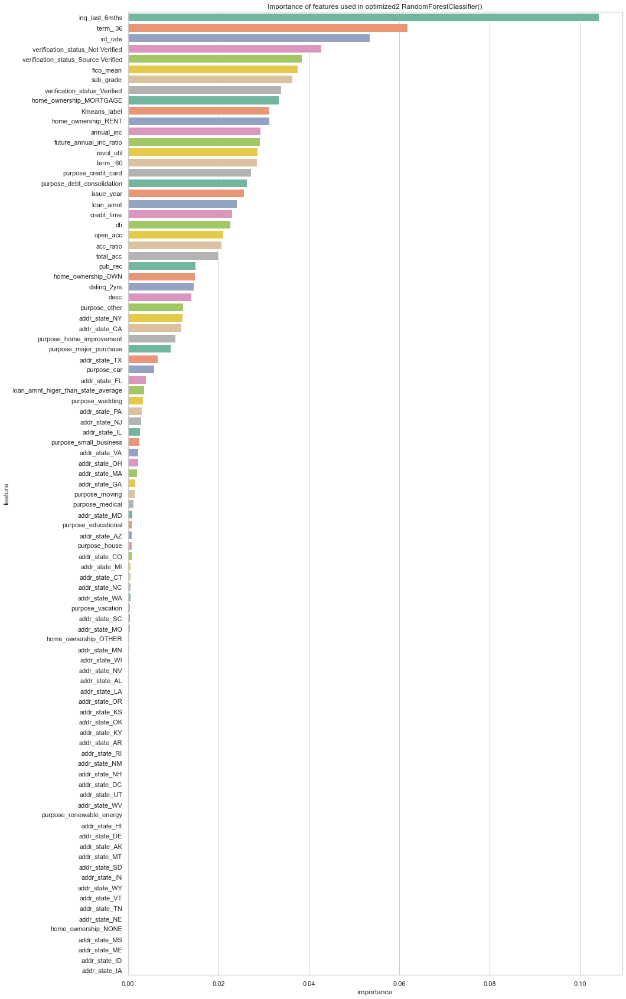

In [445]:
# wizualizacja istotności cech
from matplotlib import rcParams
rcParams['figure.figsize'] = 15,30

sns.barplot(y=feature_importance['feature'],x=feature_importance['importance'], data=feature_importance, orient='h',
            palette = sns.color_palette('Set2')).set(title="Importance of features used in optimized2 "+str(model))


In [488]:
feature_important=feature_importance[feature_importance.importance>0.0002]
feature_not_important=feature_importance[feature_importance.importance<=0.0002]

In [491]:
feature_important.shape

(64, 2)

In [492]:
to_drop_nimp=feature_not_important['feature']
to_drop_nimp.shape

(29,)

In [493]:
X_res_imp=X_res.drop(to_drop_nimp, axis=1)
X_res_imp.shape

(62420, 64)

In [494]:
#sprawdzenie modelu na istotnych zmiennych - 64 kolumny-- uwaga długo się liczy
#multi-metrics to evaluete crossvalidation - cross_validation zamiast cros_val_score
from sklearn.model_selection import cross_validate

skfold = StratifiedKFold(n_splits=10,shuffle=True, random_state=42)
rf_skfold_opt2_imp = pipeline.make_pipeline(preprocessing.StandardScaler(), RandomForestClassifier(n_estimators=500,
                                     min_samples_leaf=3,max_features='sqrt',bootstrap=True, warm_start=True,oob_score=True))

results3m = cross_validate(rf_skfold_opt2_imp,X_res_imp, y_res, cv=skfold, scoring = ['roc_auc','accuracy','precision', 'recall'],
                          return_train_score=True)
rf_skfold_opt2_imp_auroc_score = np.mean(results3m['test_roc_auc'])
rf_skfold_opt2_imp_accuracy = np.mean(results3m['test_accuracy'])
rf_skfold_opt2_imp_precision = np.mean(results3m['test_precision'])
rf_skfold_opt2_imp_recall = np.mean(results3m['test_recall'])

print("RF_optimized_2_imp with Stratified k-Fold average AUROC score : %s" % "{0:.3%}".format(rf_skfold_opt2_imp_auroc_score))
print("RF_optimized_2_imp with Stratified k-Fold average Accuracy : %s" % "{0:.3%}".format(rf_skfold_opt2_imp_accuracy))
print("RF_optimized_2_imp with Stratified k-Fold average Precision : %s" % "{0:.3%}".format(rf_skfold_opt2_imp_precision))
print("RF_optimized_2_imp with Stratified k-Fold average Sensitivity : %s" % "{0:.3%}".format(rf_skfold_opt2_imp_recall))

#specificity 
rf_skfold_opt2_imp_predictions = cross_val_predict(rf_skfold_opt2_imp,X_res_imp, y_res, cv=skfold)
cm = metrics.confusion_matrix(y_res, rf_skfold_opt2_imp_predictions)
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

rf_skfold_opt2_imp_specificity = TN / float(TN + FP)
print('RF_optimized_2_imp with Stratified k-Fold Specificity : {0:.3%}'.format(rf_skfold_opt2_imp_specificity))

RF_optimized_2_imp with Stratified k-Fold average AUROC score : 95.600%
RF_optimized_2_imp with Stratified k-Fold average Accuracy : 90.982%
RF_optimized_2_imp with Stratified k-Fold average Precision : 85.312%
RF_optimized_2_imp with Stratified k-Fold average Sensitivity : 99.013%
RF_optimized_2_imp with Stratified k-Fold Specificity : 85.332%


In [495]:
rf_skfold_opt2_imp_train_accuracy = np.mean(results3m['train_accuracy'])
print('RF_optimized_2_imp with Stratified k-Fold average Train Accuracy : {0:.3%}'.format(rf_skfold_opt2_imp_train_accuracy))

RF_optimized_2_imp with Stratified k-Fold average Train Accuracy : 96.448%


In [ ]:
#z istotnymi zmiennymi wzrostł parametr AUROc_score, ale również zwiększyła się eóżnica między dokładnością na zbiorze
#treningowym i testowym, próbuje jeszcze wybrać mniej zmiennych jako istotne

In [496]:
feature_most_important=feature_importance[feature_importance.importance>0.001]
feature_not_most_important=feature_importance[feature_importance.importance<=0.001]

In [497]:
feature_most_important.shape

(48, 2)

In [498]:
to_drop_nmimp=feature_not_most_important['feature']
to_drop_nmimp.shape

(45,)

In [499]:
X_res_mimp=X_res.drop(to_drop_nmimp, axis=1)
X_res_mimp.shape

(62420, 48)

In [500]:
#sprawdzenie modelu na istotnych zmiennych - 48 kolumn-- uwaga długo się liczy
#multi-metrics to evaluete crossvalidation - cross_validation zamiast cros_val_score
from sklearn.model_selection import cross_validate

skfold = StratifiedKFold(n_splits=10,shuffle=True, random_state=42)
rf_skfold_opt2_mimp = pipeline.make_pipeline(preprocessing.StandardScaler(), RandomForestClassifier(n_estimators=500,
                                     min_samples_leaf=3,max_features='sqrt',bootstrap=True, warm_start=True,oob_score=True))

results3m = cross_validate(rf_skfold_opt2_mimp,X_res_mimp, y_res, cv=skfold, scoring = ['roc_auc','accuracy','precision', 'recall'],
                          return_train_score=True)
rf_skfold_opt2_mimp_auroc_score = np.mean(results3m['test_roc_auc'])
rf_skfold_opt2_mimp_accuracy = np.mean(results3m['test_accuracy'])
rf_skfold_opt2_mimp_precision = np.mean(results3m['test_precision'])
rf_skfold_opt2_mimp_recall = np.mean(results3m['test_recall'])

print("RF_optimized_2_most_imp with Stratified k-Fold average AUROC score : %s" % "{0:.3%}".format(rf_skfold_opt2_mimp_auroc_score))
print("RF_optimized_2_most_imp with Stratified k-Fold average Accuracy : %s" % "{0:.3%}".format(rf_skfold_opt2_mimp_accuracy))
print("RF_optimized_2_most_imp with Stratified k-Fold average Precision : %s" % "{0:.3%}".format(rf_skfold_opt2_mimp_precision))
print("RF_optimized_2_most_imp with Stratified k-Fold average Sensitivity : %s" % "{0:.3%}".format(rf_skfold_opt2_mimp_recall))

#specificity 
rf_skfold_opt2_mimp_predictions = cross_val_predict(rf_skfold_opt2_mimp,X_res_mimp, y_res, cv=skfold)
cm = metrics.confusion_matrix(y_res, rf_skfold_opt2_mimp_predictions)
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

rf_skfold_opt2_mimp_specificity = TN / float(TN + FP)
print('RF_optimized_2_most_imp with Stratified k-Fold Specificity : {0:.3%}'.format(rf_skfold_opt2_mimp_specificity))

RF_optimized_2_most_imp with Stratified k-Fold average AUROC score : 95.586%
RF_optimized_2_most_imp with Stratified k-Fold average Accuracy : 90.900%
RF_optimized_2_most_imp with Stratified k-Fold average Precision : 85.351%
RF_optimized_2_most_imp with Stratified k-Fold average Sensitivity : 98.754%
RF_optimized_2_most_imp with Stratified k-Fold Specificity : 85.353%


In [520]:
rf_skfold_opt2_mimp_train_accuracy = np.mean(results3m['train_accuracy'])
print('RF_optimized_2_most_imp with Stratified k-Fold average Train Accuracy : {0:.3%}'.format(rf_skfold_opt2_mimp_train_accuracy))

RF_optimized_2_most_imp with Stratified k-Fold average Train Accuracy : 100.000%


In [ ]:
#nie jest lepiej, ale też nie jakoś bardzo gorzej, różnice na poziomie 0,001 wskaźnika., 
#Ale na zbiorze treningowym znów 100%, a zatem ograniczenie istotnych zmiennych do 64 było lepszym pomysłem

### dla istotnych zmiennych dostrojenie modelu jeszcze raz podobnym zakresie parametrów tylko już w jednym słowniku

In [516]:
import time
licznik_start = time.time()

model=RandomForestClassifier()

cv=StratifiedKFold(n_splits=10,shuffle=True, random_state=42)

params3_imp = [{

                      "bootstrap" : [True], 
                      "n_estimators": [100, 300, 500],
                    "min_samples_split": [2, 5, 20, 50],
                      "min_samples_leaf": [1, 3, 5, 10],
                      "max_features": ["sqrt", None],
                        "oob_score": [True],
                        "warm_start":[True]
                      }]

# konfiguracja procesu przetestowania siatki parametrów
process3_imp = pipeline.make_pipeline(StandardScaler(), RandomizedSearchCV(model, params3_imp, 
                                 cv = cv, verbose = 5, scoring = 'roc_auc', n_iter = 10, return_train_score = True, 
                                 n_jobs = -1))
# nauczanie modelu
process3_imp.fit(X_res_imp, y_res)

print("Work time 3_imp[min]: ", (time.time() - licznik_start)/60)
#Work time for n_iter=10 [min]:  55.17

Fitting 10 folds for each of 10 candidates, totalling 100 fits
Work time 3_imp[min]:  55.1762961824735


In [522]:
# pobranie wyników procesu - RandomizedSearchCV3
process3_imp_effect=process3_imp.named_steps["randomizedsearchcv"]

best_params3_imp = process3_imp_effect.best_params_
best_estimator3_imp = process3_imp_effect.best_estimator_
best_score3_imp = process3_imp_effect.best_score_

print('The best fitted parameters for Random Forest3_imp are: ' +str(best_params3_imp))
print('The best fitted estimator is: ' +str(best_estimator3_imp))
print('They allow to achieve the best auroc_score: ',best_score3_imp)

The best fitted parameters for Random Forest3_imp are: {'warm_start': True, 'oob_score': True, 'n_estimators': 300, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_features': 'sqrt', 'bootstrap': True}
The best fitted estimator is: RandomForestClassifier(max_features='sqrt', min_samples_split=5,
                       n_estimators=300, oob_score=True, warm_start=True)
They allow to achieve the best auroc_score:  0.9572622530693822


In [523]:
#sprawdzenie błędów na zbiorze treningowym
trening_score3_imp = np.mean(abs(process3_imp_effect.cv_results_['mean_train_score']))
print('Mean training auroc_score:',trening_score3_imp)
testing_score3_imp = np.mean(abs(process3_imp_effect.cv_results_['mean_test_score']))
print('Mean testing auroc_score:',testing_score3_imp)

Mean training auroc_score: 0.9930257123887584
Mean testing auroc_score: 0.9513706541489416


In [ ]:
#wydaje się, że jest podobnie, albo troszkę gorzej dla trzeciej próby optymalizacji - pod model z wykorzystaniem
#istotnych zmiennych. Sprawdzam metryki

In [524]:
#multi-metrics to evaluete crossvalidation - cross_validation zamiast cros_val_score
from sklearn.model_selection import cross_validate

skfold = StratifiedKFold(n_splits=10,shuffle=True, random_state=42)
rf_skfold_opt3_imp = pipeline.make_pipeline(preprocessing.StandardScaler(), RandomForestClassifier(n_estimators=500,
                                     min_samples_split=2, min_samples_leaf=1,max_features='sqrt',bootstrap=True, 
                                                                                warm_start=True,oob_score=True))

results3m = cross_validate(rf_skfold_opt3_imp,X_res_imp, y_res, cv=skfold, scoring = ['roc_auc','accuracy','precision', 'recall'],
                          return_train_score=True)
rf_skfold_opt3_imp_auroc_score = np.mean(results3m['test_roc_auc'])
rf_skfold_opt3_imp_accuracy = np.mean(results3m['test_accuracy'])
rf_skfold_opt3_imp_precision = np.mean(results3m['test_precision'])
rf_skfold_opt3_imp_recall = np.mean(results3m['test_recall'])

print("RF_optimized_3_imp with Stratified k-Fold average AUROC score : %s" % "{0:.3%}".format(rf_skfold_opt3_imp_auroc_score))
print("RF_optimized_3_imp with Stratified k-Fold average Accuracy : %s" % "{0:.3%}".format(rf_skfold_opt3_imp_accuracy))
print("RF_optimized_3_imp with Stratified k-Fold average Precision : %s" % "{0:.3%}".format(rf_skfold_opt3_imp_precision))
print("RF_optimized_3_imp with Stratified k-Fold average Sensitivity : %s" % "{0:.3%}".format(rf_skfold_opt3_imp_recall))

#specificity 
rf_skfold_opt3_imp_predictions = cross_val_predict(rf_skfold_opt3_imp,X_res_imp, y_res, cv=skfold)
cm = metrics.confusion_matrix(y_res, rf_skfold_opt3_imp_predictions)
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

rf_skfold_opt3_imp_specificity = TN / float(TN + FP)
print('RF_optimized_3_imp with Stratified k-Fold Specificity : {0:.3%}'.format(rf_skfold_opt3_imp_specificity))

RF_optimized_3_imp with Stratified k-Fold average AUROC score : 95.881%
RF_optimized_3_imp with Stratified k-Fold average Accuracy : 91.411%
RF_optimized_3_imp with Stratified k-Fold average Precision : 85.918%
RF_optimized_3_imp with Stratified k-Fold average Sensitivity : 99.061%
RF_optimized_3_imp with Stratified k-Fold Specificity : 85.939%


In [525]:
rf_skfold_opt3_imp_train_accuracy = np.mean(results3m['train_accuracy'])
print('RF_optimized3_imp with Stratified k-Fold average Train Accuracy : {0:.3%}'.format(rf_skfold_opt3_imp_train_accuracy))
##znów 100% na zbiorze trenigowym, czyli ta 3. optymalizacja bez sensu

RF_optimized3_imp with Stratified k-Fold average Train Accuracy : 100.000%


In [619]:
#Porównanie 

importance = {'Model':['Random Forest Sk-Fold_optimized_2_imp_features',
                    'Random Forest Sk-Fold_optmized_2_most_imp_features',
                    'Random Forest Sk-Fold_optmized_3_imp_features'],
           
                 'AUROC score':[rf_skfold_opt2_imp_auroc_score,
                               rf_skfold_opt2_mimp_auroc_score,
                               rf_skfold_opt3_imp_auroc_score],
                 
                   'Accuracy':[rf_skfold_opt2_imp_accuracy,
                              rf_skfold_opt2_mimp_accuracy,
                              rf_skfold_opt3_imp_accuracy],
                 
                    'Precision':[rf_skfold_opt2_imp_precision,
                                rf_skfold_opt2_mimp_precision,
                                rf_skfold_opt3_imp_precision],
                 
                    'Sensitivity':[rf_skfold_opt2_imp_recall,
                                  rf_skfold_opt2_mimp_recall,
                                  rf_skfold_opt3_imp_recall],
                
                    'Specificity':[rf_skfold_opt2_imp_specificity,
                                  rf_skfold_opt2_mimp_specificity,
                                  rf_skfold_opt3_imp_specificity],
           
                'Train Accuracy':[rf_skfold_opt2_imp_train_accuracy,
                                 rf_skfold_opt2_mimp_train_accuracy,
                                 rf_skfold_opt3_imp_train_accuracy]
                 
                    }

importance = pd.DataFrame(importance)

#append rows to the dataframe
prediction_table  = prediction_table.append(importance, ignore_index=True)
prediction_table 

,Model,AUROC score,Accuracy,Precision,Sensitivity,Specificity,Train Accuracy
0,Logistic Regression,0.950881,0.916053,0.857401,0.996282,0.857401,0.912348
1,Decision Tree,0.846911,0.847004,0.851992,0.836566,0.851992,1.000000
2,Decision Tree_2 (30:70),0.844396,0.844441,0.850487,0.834156,0.850487,1.000000
3,Random Forest,0.957538,0.913649,0.861143,0.984481,0.861143,1.000000
4,Random Forest_2 (30:70),0.956973,0.910873,0.858119,0.983587,0.858119,1.000000
5,Linear SVM,0.950988,0.915171,0.854613,0.998707,0.854613,0.912508
6,KNN,0.935492,0.902675,0.860165,0.959586,0.860165,0.921700
7,Logistic Regression_PCA71,0.943363,0.905880,0.858595,0.969770,0.858595,0.902215
8,Decision Tree_PCA71,0.838334,0.838513,0.850185,0.818299,0.850185,1.000000
9,Random Forest_PCA71,0.941743,0.907321,0.847931,0.990624,0.847931,1.000000


## Sprawdzenie modelu Random Forest Sk-Fold_optmized_2 na danych niezbalansowanych

In [402]:
from sklearn.model_selection import cross_validate
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import cross_val_score
from sklearn import pipeline
from sklearn.model_selection import cross_val_predict


skfold = StratifiedKFold(n_splits=10,shuffle=True, random_state=42)
rf_skfold_opt2 = pipeline.make_pipeline(preprocessing.StandardScaler(), 
                                            RandomForestClassifier(n_estimators=500,min_samples_leaf=3,
                                            max_features='sqrt',bootstrap=True, warm_start=True,oob_score=True))

results3m = cross_validate(rf_skfold_opt2,X, y, cv=skfold, scoring = ['roc_auc','accuracy','precision', 'recall'],
                          return_train_score=True)
rf_skfold_opt2_nsmt_auroc_score = np.mean(results3m['test_roc_auc'])
rf_skfold_opt2_nsmt_accuracy = np.mean(results3m['test_accuracy'])
rf_skfold_opt2_nsmt_precision = np.mean(results3m['test_precision'])
rf_skfold_opt2_nsmt_recall = np.mean(results3m['test_recall'])

print("RF_optimized_2_nsmt with Stratified k-Fold average AUROC score : %s" % "{0:.3%}".format(rf_skfold_opt2_nsmt_auroc_score))
print("RF_optimized_2_nsmt with Stratified k-Fold average Accuracy : %s" % "{0:.3%}".format(rf_skfold_opt2_nsmt_accuracy))
print("RF_optimized_2_nsmt with Stratified k-Fold average Precision : %s" % "{0:.3%}".format(rf_skfold_opt2_nsmt_precision))
print("RF_optimized_2_nsmt with Stratified k-Fold average Sensitivity : %s" % "{0:.3%}".format(rf_skfold_opt2_nsmt_recall))

#specificity 
rf_skfold_opt2_nsmt_predictions = cross_val_predict(rf_skfold_opt2,X, y, cv=skfold)
cm = metrics.confusion_matrix(y, rf_skfold_opt2_nsmt_predictions)
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

rf_skfold_opt2_nsmt_specificity = TN / float(TN + FP)
print('RF_optimized_2 with Stratified k-Fold Specificity : {0:.3%}'.format(rf_skfold_opt2_nsmt_specificity))

rf_skfold_opt2_nsmt_train_accuracy = np.mean(results3m['train_accuracy'])
print('RF_optimized2_nsmt with Stratified k-Fold average Train Accuracy : {0:.3%}'.format(rf_skfold_opt3_nmst_train_accuracy))


KeyboardInterrupt: 

## Podejście nr 2: Porównanie działania niektórych modeli z użyciem tylko danych treningowych poddanych zbalansowaniu, a danych testowych bez modyfikacji - przeciwdziałanie przeuczeniu i zbyt optymistycznym prognozom 

In [400]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.5, random_state = 42,stratify=y)

In [401]:
from imblearn.combine import SMOTETomek
from collections import Counter
#SMOTETomek tylko na zbiorze treningowym! do sprawdzenia

smk = SMOTETomek(sampling_strategy=1, random_state=42)
X_train_res3, y_train_res3 = smk.fit_resample(X_train, y_train)
print("Wielkość train data bazowego {}".format(Counter(y_train)))
print("Wielkość train data po oversamplingu {}".format(Counter(y_train_res3)))

Wielkość train data bazowego Counter({1: 16838, 0: 2962})
Wielkość train data po oversamplingu Counter({1: 15654, 0: 15654})


In [382]:
scaler = StandardScaler()
X_train_res3_s=scaler.fit_transform(X_train_res3)
X_test_s3 = scaler.transform(X_test)

In [383]:
X_train_res3_s=pd.DataFrame(X_train_res3_s, columns=X.columns)
X_test_s3=pd.DataFrame(X_test_s3, columns=X.columns)

### Logistic Regression (LR ,Regresja logistyczna )  - tylko dane treningowe poddane zbalansowaniu, dane testowe nieruszone

In [384]:
from sklearn.linear_model import LogisticRegression
logisticRegr = LogisticRegression(max_iter=1000)
logisticRegr.fit(X_train_res3_s, y_train_res3)
lr_score_3 = logisticRegr.score(X_test_s3, y_test)
print("Model score 3 without SMOTEtomek on testing dataset: %s" % "{0:.3%}".format(lr_score_3))
lr_train_score_3=logisticRegr.score(X_train_res3_s, y_train_res3)
# performance on train data
print('Performance on training data:',lr_train_score_3)
# performance on test data
print('Performance on testing data using LR without SMOTEtomek on testing dataset:',lr_score_3)

lr_predictions_3 = logisticRegr.predict(X_test_s3)
cm = metrics.confusion_matrix(y_test, lr_predictions_3)
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

lr_y_score_3=logisticRegr.predict_proba(X_test_s3)[:, 1]
lr_auroc_score_3=metrics.roc_auc_score(y_test, lr_y_score_3)
print("LR AUROC score without SMOTEtomek on testing dataset : %s" % "{0:.3%}".format(lr_auroc_score_3))
lr_accuracy_3 = metrics.accuracy_score(y_test, lr_predictions_3)
print("LR Accuracy without SMOTEtomek on testing dataset : %s" % "{0:.3%}".format(lr_accuracy_3))
lr_precision_3=metrics.precision_score(y_test, lr_predictions_3)
print("LR Precision without SMOTEtomek on testing dataset: %s" % "{0:.3%}".format(lr_precision_3))
lr_recall_3=metrics.recall_score(y_test, lr_predictions_3)
print("LR Sensitivity without SMOTEtomek on testing dataset: %s" % "{0:.3%}".format(lr_recall_3))
lr_specificity_3 = TN / float(TN + FP)
print('LR Specificity without SMOTEtomek on testing dataset: {0:.3%}'.format(lr_specificity_3))

Model score 3 without SMOTEtomek on testing dataset: 84.920%
Performance on training data: 0.913792002044206
Performance on testing data using LR without SMOTEtomek on testing dataset: 0.8491995353770012
LR AUROC score without SMOTEtomek on testing dataset : 70.475%
LR Accuracy without SMOTEtomek on testing dataset : 84.920%
LR Precision without SMOTEtomek on testing dataset: 85.182%
LR Sensitivity without SMOTEtomek on testing dataset: 99.590%
LR Specificity without SMOTEtomek on testing dataset: 85.182%


### Random Forest (RF, Las losowy) - tylko dane treningowe poddane zbalansowaniu, dane testowe nieruszone+parametry

In [392]:
#tylko X train poddany zbalansowaniu, testowanie na zbiorze niezabalnsowanym
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier(n_estimators=500,bootstrap=True,min_samples_leaf=3,)
rf.fit(X_train_res3_s, y_train_res3)
rf_score_3 = rf.score(X_test_s3, y_test)
print("Model score 3 without SMOTEtomek on testing dataset: %s" % "{0:.3%}".format(rf_score_3))
rf_train_score_3=rf.score(X_train_res3_s, y_train_res3)
# performance on train data
print('Performance on training data using RF:',rf_train_score_3)
# performance on test data
print('Performance on testing data without SMOTEtomek using RF:',rf_score_3)

rf_predictions_3 = rf.predict(X_test_s3)
cm = metrics.confusion_matrix(y_test, rf_predictions_3)
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

rf_y_score_3=rf.predict_proba(X_test_s3)[:, 1]
rf_auroc_score_3=metrics.roc_auc_score(y_test, rf_y_score_3)
print("RF AUROC score without SMOTEtomek on testing dataset : %s" % "{0:.3%}".format(rf_auroc_score_3))
rf_accuracy_3 = metrics.accuracy_score(y_test, rf_predictions_3)
print("RF Accuracy without SMOTEtomek on testing dataset : %s" % "{0:.3%}".format(rf_accuracy_3))
rf_precision_3=metrics.precision_score(y_test, rf_predictions_3)
print("RF Precision without SMOTEtomek on testing dataset: %s" % "{0:.3%}".format(rf_precision_3))
rf_recall_3=metrics.recall_score(y_test, rf_predictions_3)
print("RF Sensitivity without SMOTEtomek on testing dataset: %s" % "{0:.3%}".format(rf_recall_3))
rf_specificity_3 = TN / float(TN + FP)
print('RF Specificity without SMOTEtomek on testing dataset: {0:.3%}'.format(rf_specificity_3))

Model score 3 without SMOTEtomek on testing dataset: 84.768%
Performance on training data using RF: 0.9583173629743197
Performance on testing data without SMOTEtomek using RF: 0.8476844603807888
RF AUROC score without SMOTEtomek on testing dataset : 69.266%
RF Accuracy without SMOTEtomek on testing dataset : 84.768%
RF Precision without SMOTEtomek on testing dataset: 85.470%
RF Sensitivity without SMOTEtomek on testing dataset: 98.901%
RF Specificity without SMOTEtomek on testing dataset: 85.470%


In [ ]:
#Podejście nr 2 - balansowanie tylko zbioru treningowego - jest bardziej uczciwe, gdyż zbiór testowy nie zawiera
#wtedy sztucznie dopisanych wierszy, które mogą być do siebie bardzo podobne i "mylić" model, który będzie testował
#na danych bardzo podobnych do tych na których się uczył - daje to zbyt optymistyczne prognozy, ale nie odzwierciedla
#pracy na rzeczywistych danych. Jednak zastosowanie zbalansowania tylko na danych trenignowych pwoduje spadek metryki
#AUROC score z 95% na ok 70% . Spróbuję osiągnąć lepsze wyniki na kilka sposobów - staosując inne algorytmy, zwiększając
#ilość danych w datasecie przeznaczonym do modelowania, zmieniając parametry ręcznie lub optymalizując z użyciem
#RandomizedSearchCV i kroswalidacji, a także spróbuję zastosować podział danych taki, by testowy zbiór był 
#zbalansowany(z użyciem prawdziwych danych), a później dodatkowo zbalansuję zbiór treningowy. 

### Balanced Random Forest (BRF, Las losowy) - tylko dane treningowe poddane zbalansowaniu, dane testowe nieruszone

In [386]:
#tylko X train poddany zbalansowaniu, testowanie na zbiorze niezabalnsowanym
from imblearn.ensemble import BalancedRandomForestClassifier
brf = BalancedRandomForestClassifier(n_estimators=100,bootstrap=True)
brf.fit(X_train_res3_s, y_train_res3)
brf_score_3 = rf.score(X_test_s3, y_test)
print("Model score 3 without SMOTEtomek on testing dataset: %s" % "{0:.3%}".format(brf_score_3))
brf_train_score_3=brf.score(X_train_res3_s, y_train_res3)
# performance on train data
print('Performance on training data using RF:',brf_train_score_3)
# performance on test data
print('Performance on testing data without SMOTEtomek using RF:',brf_score_3)

brf_predictions_3 = brf.predict(X_test_s3)
cm = metrics.confusion_matrix(y_test, brf_predictions_3)
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

brf_y_score_3=brf.predict_proba(X_test_s3)[:, 1]
brf_auroc_score_3=metrics.roc_auc_score(y_test, brf_y_score_3)
print("BRF AUROC score without SMOTEtomek on testing dataset : %s" % "{0:.3%}".format(brf_auroc_score_3))
brf_accuracy_3 = metrics.accuracy_score(y_test, brf_predictions_3)
print("BRF Accuracy without SMOTEtomek on testing dataset : %s" % "{0:.3%}".format(brf_accuracy_3))
brf_precision_3=metrics.precision_score(y_test, brf_predictions_3)
print("BRF Precision without SMOTEtomek on testing dataset: %s" % "{0:.3%}".format(brf_precision_3))
brf_recall_3=metrics.recall_score(y_test, brf_predictions_3)
print("BRF Sensitivity without SMOTEtomek on testing dataset: %s" % "{0:.3%}".format(brf_recall_3))
brf_specificity_3 = TN / float(TN + FP)
print('BRF Specificity without SMOTEtomek on testing dataset: {0:.3%}'.format(brf_specificity_3))

Model score 3 without SMOTEtomek on testing dataset: 84.814%
Performance on training data using RF: 1.0
Performance on testing data without SMOTEtomek using RF: 0.8481389828796525
BRF AUROC score without SMOTEtomek on testing dataset : 68.016%
BRF Accuracy without SMOTEtomek on testing dataset : 84.531%
BRF Precision without SMOTEtomek on testing dataset: 85.490%
BRF Sensitivity without SMOTEtomek on testing dataset: 98.533%
BRF Specificity without SMOTEtomek on testing dataset: 85.490%


### AdaBoost - tylko dane treningowe poddane zbalansowaniu, dane testowe nieruszone

In [295]:
#może inny klasyfikator lepeij sobie poradzi?
#tylko X train poddany zbalansowaniu, testowanie na zbiorze niezabalnsowanym
from sklearn.ensemble import AdaBoostClassifier
ab = AdaBoostClassifier(n_estimators=100)
ab.fit(X_train_res3_s, y_train_res3)
ab_score_3 = ab.score(X_test_s3, y_test)
print("Model score 3 without SMOTEtomek on testing dataset: %s" % "{0:.3%}".format(brf_score_3))
ab_train_score_3=ab.score(X_train_res3_s, y_train_res3)
# performance on train data
print('Performance on training data using AB:',ab_train_score_3)
# performance on test data
print('Performance on testing data without SMOTEtomek using AB:',ab_score_3)

ab_predictions_3 = ab.predict(X_test_s3)
cm = metrics.confusion_matrix(y_test, ab_predictions_3)
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

ab_y_score_3=ab.predict_proba(X_test_s3)[:, 1]
ab_auroc_score_3=metrics.roc_auc_score(y_test, ab_y_score_3)
print("AB AUROC score without SMOTEtomek on testing dataset : %s" % "{0:.3%}".format(ab_auroc_score_3))
ab_accuracy_3 = metrics.accuracy_score(y_test, ab_predictions_3)
print("AB Accuracy without SMOTEtomek on testing dataset : %s" % "{0:.3%}".format(ab_accuracy_3))
ab_precision_3=metrics.precision_score(y_test, ab_predictions_3)
print("AB Precision without SMOTEtomek on testing dataset: %s" % "{0:.3%}".format(ab_precision_3))
ab_recall_3=metrics.recall_score(y_test, ab_predictions_3)
print("AB Sensitivity without SMOTEtomek on testing dataset: %s" % "{0:.3%}".format(ab_recall_3))
ab_specificity_3 = TN / float(TN + FP)
print('AB Specificity without SMOTEtomek on testing dataset: {0:.3%}'.format(ab_specificity_3))

Model score 3 without SMOTEtomek on testing dataset: 84.753%
Performance on training data using AB: 0.9016225884757889
Performance on testing data without SMOTEtomek using AB: 0.8415231553961922
AB AUROC score without SMOTEtomek on testing dataset : 67.781%
AB Accuracy without SMOTEtomek on testing dataset : 84.152%
AB Precision without SMOTEtomek on testing dataset: 85.722%
AB Sensitivity without SMOTEtomek on testing dataset: 97.624%
AB Specificity without SMOTEtomek on testing dataset: 85.722%


### Random Forest (RF, Las losowy) - tylko dane treningowe poddane zbalansowaniu, dane testowe nieruszone - model z większą ilością danych

In [284]:
#zobaczę , czy model lepiej zadziała, mając więcej kolumn - robię 2 zbiór , usuwając mniej kolumn

to_drop_ml2 =['tax_liens', 'acc_now_delinq', 'delinq_amnt', 'revol_bal', 'earliest_cr_line', 'issue_d']

data_ml2=data_outliers_removed.drop(to_drop_ml2, axis=1)

acc_ratio = data_eda_outliers_removed['acc_ratio']
data_ml2 = data_ml2.join(acc_ratio)

future_annual_inc_ratio = data_eda_outliers_removed['future_annual_inc_ratio']
data_ml2 = data_ml2.join(future_annual_inc_ratio)

loan_amnt_higer_than_state_average = data_eda_outliers_removed['loan_amnt_higer_than_state_average']
data_ml2 = data_ml2.join(loan_amnt_higer_than_state_average)

data_ml2.shape

(39601, 98)

In [285]:
X2 = data_ml2.drop('loan_status',axis =1)  
y2 = data_ml2['loan_status']

In [286]:
X2['Kmeans_label'] = kmeans.labels_

In [307]:
from sklearn.model_selection import train_test_split
X2_train, X2_test, y2_train, y2_test = train_test_split(X2, y2, test_size = 0.2, random_state = 42,stratify=y2)

In [308]:
from imblearn.combine import SMOTETomek
from collections import Counter
#SMOTETomek tylko na zbiorze treningowym! do sprawdzenia

smk = SMOTETomek(sampling_strategy=1, random_state=42)
X2_train_res3, y2_train_res3 = smk.fit_resample(X2_train, y2_train)
print("Wielkość train data bazowego {}".format(Counter(y2_train)))
print("Wielkość train data po oversamplingu {}".format(Counter(y2_train_res3)))

Wielkość train data bazowego Counter({1: 26940, 0: 4740})
Wielkość train data po oversamplingu Counter({1: 25076, 0: 25076})


In [309]:
scaler = StandardScaler()
X2_train_res3_s=scaler.fit_transform(X2_train_res3)
X2_test_s3 = scaler.transform(X2_test)

In [310]:
X2_train_res3_s=pd.DataFrame(X2_train_res3_s, columns=X2.columns)
X2_test_s3=pd.DataFrame(X2_test_s3, columns=X2.columns)

In [391]:
#tylko X train poddany zbalansowaniu, testowanie na zbiorze niezbalansowanym
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier(n_estimators=500,bootstrap=True,min_samples_leaf=3)
rf.fit(X2_train_res3_s, y2_train_res3)
rf_score_mf = rf.score(X2_test_s3, y2_test)
print("Model score 3 without SMOTEtomek on testing dataset: %s" % "{0:.3%}".format(rf_score_mf))
rf_train_score_mf=rf.score(X2_train_res3_s, y2_train_res3)
# performance on train data
print('Performance on training data using RF:',rf_train_score_mf)
# performance on test data
print('Performance on testing data without SMOTEtomek using RF:',rf_score_mf)

rf_predictions_mf = rf.predict(X2_test_s3)
cm = metrics.confusion_matrix(y2_test, rf_predictions_mf)
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

rf_y_score_mf=rf.predict_proba(X2_test_s3)[:, 1]
rf_auroc_score_mf=metrics.roc_auc_score(y2_test, rf_y_score_mf)
print("RF AUROC score without SMOTEtomek on testing dataset : %s" % "{0:.3%}".format(rf_auroc_score_mf))
rf_accuracy_mf = metrics.accuracy_score(y2_test, rf_predictions_mf)
print("RF Accuracy without SMOTEtomek on testing dataset : %s" % "{0:.3%}".format(rf_accuracy_mf))
rf_precision_mf=metrics.precision_score(y2_test, rf_predictions_mf)
print("RF Precision without SMOTEtomek on testing dataset: %s" % "{0:.3%}".format(rf_precision_mf))
rf_recall_mf=metrics.recall_score(y2_test, rf_predictions_mf)
print("RF Sensitivity without SMOTEtomek on testing dataset: %s" % "{0:.3%}".format(rf_recall_mf))
rf_specificity_mf = TN / float(TN + FP)
print('RF Specificity without SMOTEtomek on testing dataset: {0:.3%}'.format(rf_specificity_mf))

Model score 3 without SMOTEtomek on testing dataset: 84.762%
Performance on training data using RF: 0.9633514117084064
Performance on testing data without SMOTEtomek using RF: 0.8476202499684383
RF AUROC score without SMOTEtomek on testing dataset : 68.325%
RF Accuracy without SMOTEtomek on testing dataset : 84.762%
RF Precision without SMOTEtomek on testing dataset: 85.365%
RF Sensitivity without SMOTEtomek on testing dataset: 99.065%
RF Specificity without SMOTEtomek on testing dataset: 85.365%


### Random Forest (RF, Las losowy) z balanced train test split własną fukcją (downsampling)

In [367]:
#z: https://stackoverflow.com/questions/61885259/using-sklearn-train-test-split-for-imbalanced-data

#niestety traci sporo informacji w zbioerze trenignowym
def equal_sampler(classes, data, target, test_frac):
    
    # Find the least frequent class and its fraction of the total
    _, count = np.unique(target, return_counts=True)
    fraction_of_total = min(count) / len(target)
    
    # split further into train and test
    train_frac = (1-test_frac)*fraction_of_total
    test_frac = test_frac*fraction_of_total
    
    # initialize index arrays and find length of train and test
    train=[]
    train_len = int(train_frac * data.shape[0])
    test=[]
    test_len = int(test_frac* data.shape[0])
    
    # add values to train, drop them from the index and proceed to add to test
    for i in classes:
        indeces = list(target[target ==i].index.copy())
        train_temp = np.random.choice(indeces, train_len, replace=False)
        for val in train_temp:
            train.append(val)
            indeces.remove(val)
        test_temp = np.random.choice(indeces, test_len, replace=False)
        for val in test_temp:
            test.append(val)
    
    # X_train, y_train, X_test, y_test
    return data.loc[train], target[train], data.loc[test], target[test] 

In [368]:
X_train,y_train, X_test, y_test = equal_sampler([0,1],X, y,0.2)

In [373]:
scaler = StandardScaler()
X_train_s=scaler.fit_transform(X_train)
X_test_s = scaler.transform(X_test)

In [376]:
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier(n_estimators=500,class_weight='balanced',bootstrap=True,min_samples_leaf=3, max_depth=65)
rf.fit(X_train_s, y_train)
rf_score_btts = rf.score(X_test_s, y_test)
print("Model score 3 without SMOTEtomek on testing dataset: %s" % "{0:.3%}".format(rf_score_btts))
rf_train_score_btts=rf.score(X_train_s, y_train)
# performance on train data
print('Performance on training data using RF_btts:',rf_train_score_btts)
# performance on test data
print('Performance on testing data without SMOTEtomek using RF_btts:',rf_score_btts)

rf_predictions_btts = rf.predict(X_test_s)
cm = metrics.confusion_matrix(y_test, rf_predictions_btts)
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

rf_y_score_btts=rf.predict_proba(X_test_s)[:, 1]
rf_auroc_score_btts=metrics.roc_auc_score(y_test, rf_y_score_btts)
print("RF_btts AUROC score without SMOTEtomek on testing dataset : %s" % "{0:.3%}".format(rf_auroc_score_btts))
rf_accuracy_btts = metrics.accuracy_score(y_test, rf_predictions_btts)
print("RF_btts Accuracy without SMOTEtomek on testing dataset : %s" % "{0:.3%}".format(rf_accuracy_btts))
rf_precision_btts=metrics.precision_score(y_test, rf_predictions_btts)
print("RF_btts Precision without SMOTEtomek on testing dataset: %s" % "{0:.3%}".format(rf_precision_btts))
rf_recall_btts=metrics.recall_score(y_test, rf_predictions_btts)
print("RF_btts Sensitivity without SMOTEtomek on testing dataset: %s" % "{0:.3%}".format(rf_recall_btts))
rf_specificity_btts = TN / float(TN + FP)
print('RF_btts Specificity without SMOTEtomek on testing dataset: {0:.3%}'.format(rf_specificity_btts))

Model score 3 without SMOTEtomek on testing dataset: 63.840%
Performance on training data using RF_btts: 0.9550632911392405
Performance on testing data without SMOTEtomek using RF_btts: 0.6383966244725738
RF_btts AUROC score without SMOTEtomek on testing dataset : 69.132%
RF_btts Accuracy without SMOTEtomek on testing dataset : 63.840%
RF_btts Precision without SMOTEtomek on testing dataset: 64.695%
RF_btts Sensitivity without SMOTEtomek on testing dataset: 60.928%
RF_btts Specificity without SMOTEtomek on testing dataset: 64.695%


In [ ]:
#przy zbalansowanym train/test splicie - ale robiącym downsampling na zbiorze tregingowym, auroc_score na podobnym poziomie,
#ale reszta metryk wypadła dużo gorzej

### Sprawdzenie modelu Random Forest Sk-Fold_optmized_2 dla danych zbalansowanych tylko dla treningowych +skfold

In [677]:
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict
from imblearn.combine import SMOTETomek
from imblearn.pipeline import make_pipeline
from collections import Counter
smk = SMOTETomek(random_state=42)

skfold = StratifiedKFold(n_splits=10,shuffle=True, random_state=42)
rf_skfold_opt2 = make_pipeline(SMOTETomek(random_state=42),preprocessing.StandardScaler(), 
                                            RandomForestClassifier(n_estimators=500,min_samples_leaf=3,
                                            max_features='sqrt',bootstrap=True, warm_start=True,oob_score=True))

results3m = cross_validate(rf_skfold_opt2,X, y, cv=skfold, scoring = ['roc_auc','accuracy','precision', 'recall'],
                          return_train_score=True)
rf_skfold_opt2_smt_auroc_score = np.mean(results3m['test_roc_auc'])
rf_skfold_opt2_smt_accuracy = np.mean(results3m['test_accuracy'])
rf_skfold_opt2_smt_precision = np.mean(results3m['test_precision'])
rf_skfold_opt2_smt_recall = np.mean(results3m['test_recall'])

print("RF_optimized_2_smt with Stratified k-Fold average AUROC score : %s" % "{0:.3%}".format(rf_skfold_opt2_smt_auroc_score))
print("RF_optimized_2_smt with Stratified k-Fold average Accuracy : %s" % "{0:.3%}".format(rf_skfold_opt2_smt_accuracy))
print("RF_optimized_2_smt with Stratified k-Fold average Precision : %s" % "{0:.3%}".format(rf_skfold_opt2_smt_precision))
print("RF_optimized_2_smt with Stratified k-Fold average Sensitivity : %s" % "{0:.3%}".format(rf_skfold_opt2_smt_recall))

#specificity 
rf_skfold_opt2_smt_predictions = cross_val_predict(rf_skfold_opt2,X, y, cv=skfold)
cm = metrics.confusion_matrix(y, rf_skfold_opt2_smt_predictions)
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

rf_skfold_opt2_smt_specificity = TN / float(TN + FP)
print('RF_optimized_2_smt with Stratified k-Fold Specificity : {0:.3%}'.format(rf_skfold_opt2_smt_specificity))

rf_skfold_opt2_smt_train_accuracy = np.mean(results3m['train_accuracy'])
print('RF_optimized2_smt with Stratified k-Fold average Train Accuracy : {0:.3%}'.format(rf_skfold_opt2_smt_train_accuracy))

RF_optimized_2_smt with Stratified k-Fold average AUROC score : 69.142%
RF_optimized_2_smt with Stratified k-Fold average Accuracy : 84.692%
RF_optimized_2_smt with Stratified k-Fold average Precision : 85.357%
RF_optimized_2_smt with Stratified k-Fold average Sensitivity : 98.979%
RF_optimized_2_smt with Stratified k-Fold Specificity : 85.341%


### Optymalizacja (4.) modelu Random Forest Sk-Fold_ dla danych zbalansowanych tylko danych treningowych +skfold

In [345]:
from sklearn.model_selection import StratifiedKFold
import time
from imblearn.combine import SMOTETomek
from imblearn.pipeline import make_pipeline
licznik_start = time.time()

model=RandomForestClassifier()

cv=StratifiedKFold(n_splits=10,shuffle=True, random_state=42)

params4 = [{

                      "bootstrap" : [True], 
                      "n_estimators": [10, 100, 300, 500, 1000],
                      "min_samples_leaf": [1, 3, 5, 10],
                      "max_features": ["sqrt", None],
                        "oob_score": [True],
                        "warm_start":[True]
                      }]

# konfiguracja procesu przetestowania siatki parametrów
process4 = make_pipeline(SMOTETomek(random_state=42),StandardScaler(), RandomizedSearchCV(model, params4, 
                                 cv = cv, verbose = 5, scoring = 'roc_auc', n_iter = 10, return_train_score = True, 
                                 n_jobs = -1))
# nauczanie modelu
process4.fit(X, y)

print("Work time 4[min]: ", (time.time() - licznik_start)/60)
#Work time for n_iter=10 [min]:  17.27


Fitting 10 folds for each of 10 candidates, totalling 100 fits
Work time 4[min]:  91.23313381671906


In [352]:
# pobranie wyników procesu - RandomizedSearchCV4
process4_effect=process4.named_steps["randomizedsearchcv"]

best_params4 = process4_effect.best_params_
best_estimator4 = process4_effect.best_estimator_
best_score4 = process4_effect.best_score_

print('The best fitted parameters for Random Forest4 are: ' +str(best_params4))
print('The best fitted estimator is: ' +str(best_estimator4))
print('They allow to achieve the best auroc_score: ',best_score4)

The best fitted parameters for Random Forest4 are: {'warm_start': True, 'oob_score': True, 'n_estimators': 1000, 'min_samples_leaf': 1, 'max_features': 'sqrt', 'bootstrap': True}
The best fitted estimator is: RandomForestClassifier(max_features='sqrt', n_estimators=1000, oob_score=True,
                       warm_start=True)
They allow to achieve the best auroc_score:  0.9585435547824831


In [357]:
process4_effect.cv_results_

{'mean_fit_time': array([507.82435005,  88.25486975,  18.79778178, 290.91565552,
        161.67382772, 507.63124421,   2.43505454,   2.19893401,
        372.15053375,  15.5124222 ]),
 'std_fit_time': array([ 7.54116217,  5.0748384 ,  0.64123513,  9.32245399,  8.1077533 ,
        38.21922763,  0.09915888,  0.09149348, 56.13489158,  2.1890171 ]),
 'mean_score_time': array([0.96294985, 0.78910148, 0.0481113 , 3.1919018 , 0.25362253,
        0.80145023, 0.03588581, 0.03607419, 8.74855633, 0.03424778]),
 'std_score_time': array([3.99190024e-01, 5.41626060e-02, 2.14661179e-02, 6.87180712e-01,
        5.69508346e-02, 1.17798120e-01, 2.56383461e-03, 1.03596143e-02,
        2.89234082e+00, 1.52363198e-02]),
 'param_warm_start': masked_array(data=[True, True, True, True, True, True, True, True, True,
                    True],
              mask=[False, False, False, False, False, False, False, False,
                    False, False],
        fill_value='?',
             dtype=object),
 'param_

In [353]:
#sprawdzenie błędów na zbiorze treningowym
trening_score4 = np.mean(abs(process4_effect.cv_results_['mean_train_score']))
print('Mean training auroc_score:',trening_score4)
testing_score4 = np.mean(abs(process4_effect.cv_results_['mean_test_score']))
print('Mean testing auroc_score:',testing_score4)

Mean training auroc_score: 0.9921609003395611
Mean testing auroc_score: 0.9471484094321923


In [360]:
from imblearn.combine import SMOTETomek
from imblearn.pipeline import make_pipeline
from sklearn import preprocessing
from sklearn.model_selection import cross_validate
from sklearn.model_selection import cross_val_predict

smk = SMOTETomek(random_state=42)

skfold = StratifiedKFold(n_splits=10,shuffle=True, random_state=42)
rf_skfold_opt4_smt = make_pipeline(SMOTETomek(random_state=42),preprocessing.StandardScaler(), 
                                            RandomForestClassifier(n_estimators=1000,
                                            max_features='sqrt',bootstrap=True, warm_start=True, oob_score=True))

results3m = cross_validate(rf_skfold_opt4_smt,X, y, cv=skfold, scoring = ['roc_auc','accuracy','precision', 'recall'],
                          return_train_score=True)
rf_skfold_opt4_smt_auroc_score = np.mean(results3m['test_roc_auc'])
rf_skfold_opt4_smt_accuracy = np.mean(results3m['test_accuracy'])
rf_skfold_opt4_smt_precision = np.mean(results3m['test_precision'])
rf_skfold_opt4_smt_recall = np.mean(results3m['test_recall'])

print("RF_optimized_4_smt with Stratified k-Fold average AUROC score : %s" % "{0:.3%}".format(rf_skfold_opt4_smt_auroc_score))
print("RF_optimized_4_smt with Stratified k-Fold average Accuracy : %s" % "{0:.3%}".format(rf_skfold_opt4_smt_accuracy))
print("RF_optimized_4_smt with Stratified k-Fold average Precision : %s" % "{0:.3%}".format(rf_skfold_opt4_smt_precision))
print("RF_optimized_4_smt with Stratified k-Fold average Sensitivity : %s" % "{0:.3%}".format(rf_skfold_opt4_smt_recall))

#specificity 
rf_skfold_opt4_smt_predictions = cross_val_predict(rf_skfold_opt4_smt,X, y, cv=skfold)
cm = metrics.confusion_matrix(y, rf_skfold_opt4_smt_predictions)
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

rf_skfold_opt4_smt_specificity = TN / float(TN + FP)
print('RF_optimized_4_smt with Stratified k-Fold Specificity : {0:.3%}'.format(rf_skfold_opt4_smt_specificity))

rf_skfold_opt4_smt_train_accuracy = np.mean(results3m['train_accuracy'])
print('RF_optimized_4_smt with Stratified k-Fold average Train Accuracy : {0:.3%}'.format(rf_skfold_opt4_smt_train_accuracy))

RF_optimized_4_smt with Stratified k-Fold average AUROC score : 68.999%
RF_optimized_4_smt with Stratified k-Fold average Accuracy : 84.836%
RF_optimized_4_smt with Stratified k-Fold average Precision : 85.355%
RF_optimized_4_smt with Stratified k-Fold average Sensitivity : 99.186%


NameError: name 'cross_val_predict' is not defined

In [850]:
results3m['test_roc_auc']

array([0.69765309, 0.69868461, 0.67055946, 0.67355391, 0.68197152,
       0.68451909, 0.68678664, 0.67320602, 0.67224915, 0.6881582 ])

In [ ]:
#optymalizacja parametrów przy uczeniu na zbiorach zbalansowanych, a testowaniu na niezbalansowanych, 
#nie podwyższyła widocznie wartości mierzonych metryk

In [394]:
#Porównanie - dane niezbalansowane + podejście 2

only_train_balanced = {'Model':['Random Forest Sk-Fold_optimized_2_imbalanced_data',
                                'Logistic Regression_only_train_balanced',
                                'Random Forest_only_train_balanced',
                                'Balanced Random Forest',
                                'Ada Boost',
                                'Random Forest_more_features_only_train_balanced',
                               'Random Forest_balanced_split_downsampling',
                               'Random Forest Sk-Fold_optimized_2_only_train_balanced',
                               'Random Forest Sk-Fold_optimized_4_only_train_balanced'],
           
                 'AUROC score':[rf_skfold_opt2_nsmt_auroc_score,
                                lr_auroc_score_3,
                                rf_auroc_score_3,
                                brf_auroc_score_3,
                                ab_auroc_score_3,
                                rf_auroc_score_mf,
                                rf_auroc_score_btts,
                                rf_skfold_opt2_smt_auroc_score,
                                rf_skfold_opt4_smt_auroc_score],
                 
                   'Accuracy':[rf_skfold_opt2_nsmt_accuracy,
                                lr_accuracy_3,
                                rf_accuracy_3,
                                brf_accuracy_3,
                                ab_accuracy_3,
                                rf_accuracy_mf,
                                rf_accuracy_btts,
                                rf_skfold_opt2_smt_accuracy,
                                rf_skfold_opt4_smt_accuracy],
                 
                    'Precision':[rf_skfold_opt2_nsmt_precision,
                                lr_precision_3,
                                rf_precision_3,
                                brf_precision_3,
                                ab_precision_3,
                                rf_precision_mf,
                                rf_precision_btts,
                                rf_skfold_opt2_smt_precision,
                                rf_skfold_opt4_smt_precision],
                 
                    'Sensitivity':[rf_skfold_opt2_nsmt_recall,
                                lr_recall_3,
                                rf_recall_3,
                                brf_recall_3,
                                ab_recall_3,
                                rf_recall_mf,
                                rf_recall_btts,
                                rf_skfold_opt2_smt_recall,
                                rf_skfold_opt4_smt_recall],
                
                    'Specificity':[rf_skfold_opt2_nsmt_specificity,
                                lr_specificity_3,
                                rf_specificity_3,
                                brf_specificity_3,
                                ab_specificity_3,
                                rf_specificity_mf,
                                rf_specificity_btts,
                                rf_skfold_opt2_smt_specificity,
                                rf_skfold_opt4_smt_specificity],
           
                'Train Accuracy':[rf_skfold_opt2_nsmt_train_accuracy,
                                lr_train_accuracy_3,
                                rf_train_accuracy_3,
                                brf_train_accuracy_3,
                                ab_train_accuracy_3,
                                rf_train_accuracy_mf,
                                rf_train_accuracy_btts,
                                rf_skfold_opt2_smt_train_accuracy,
                                rf_skfold_opt4_smt_train_accuracy]
                 
                    }

only_train_balanced = pd.DataFrame(only_train_balanced)

#append rows to the dataframe
prediction_table  = prediction_table.append(only_train_balanced, ignore_index=True)
prediction_table 

NameError: name 'rf_skfold_opt2_nsmt_auroc_score' is not defined

## Wybór finalnego modelu

In [620]:
###różnice między dokłądnościami treningowymi a testowymi
prediction_table['Train-Test difference Accuracy']=prediction_table['Train Accuracy']-prediction_table['Accuracy']

In [621]:
#współczynnik do oceny
prediction_table['metric_ratio'] = prediction_table['AUROC score']-abs(prediction_table['Train-Test difference Accuracy'])

In [622]:
prediction_table

,Model,AUROC score,Accuracy,Precision,Sensitivity,Specificity,Train Accuracy,Train-Test difference Accuracy,metric_ratio
0,Logistic Regression,0.950881,0.916053,0.857401,0.996282,0.857401,0.912348,-0.003705,0.947176
1,Decision Tree,0.846911,0.847004,0.851992,0.836566,0.851992,1.000000,0.152996,0.693916
2,Decision Tree_2 (30:70),0.844396,0.844441,0.850487,0.834156,0.850487,1.000000,0.155559,0.688837
3,Random Forest,0.957538,0.913649,0.861143,0.984481,0.861143,1.000000,0.086351,0.871188
4,Random Forest_2 (30:70),0.956973,0.910873,0.858119,0.983587,0.858119,1.000000,0.089127,0.867846
5,Linear SVM,0.950988,0.915171,0.854613,0.998707,0.854613,0.912508,-0.002663,0.948325
6,KNN,0.935492,0.902675,0.860165,0.959586,0.860165,0.921700,0.019024,0.916468
7,Logistic Regression_PCA71,0.943363,0.905880,0.858595,0.969770,0.858595,0.902215,-0.003665,0.939698
8,Decision Tree_PCA71,0.838334,0.838513,0.850185,0.818299,0.850185,1.000000,0.161487,0.676847
9,Random Forest_PCA71,0.941743,0.907321,0.847931,0.990624,0.847931,1.000000,0.092679,0.849064


### Finalny model = Random Forest Sk-Fold_optimized_2

Parametry wybranego modelu: RandomForestClassifier(n_estimators=500,min_samples_leaf=3,max_features='sqrt',
                                                           bootstrap=True, warm_start=True,oob_score=True)
przy skfold = StratifiedKFold(n_splits=10,shuffle=True, random_state=42)                                                      

In [ ]:
#warto sprawdzić, jak się zachowuje finalny model przy zredukowanych danych z pomocą PCA (przy podejściu nr 1 i nr 2)

### PCA dla finalnego modelu - podejście 1 (zabalansowny dataset)

In [624]:
skfold = StratifiedKFold(n_splits=10,shuffle=True, random_state=42)
rf_skfold_opt2_pca = pipeline.make_pipeline(preprocessing.StandardScaler(),IncrementalPCA(n_components=71),
                                    RandomForestClassifier(n_estimators=500,min_samples_leaf=3,max_features='sqrt',
                                                           bootstrap=True, warm_start=True,oob_score=True))

results3m = cross_validate(rf_skfold_opt2_pca,X_res, y_res, cv=skfold, scoring = ['roc_auc','accuracy','precision', 'recall'],
                          return_train_score=True)
rf_skfold_opt2_pca_auroc_score = np.mean(results3m['test_roc_auc'])
rf_skfold_opt2_pca_accuracy = np.mean(results3m['test_accuracy'])
rf_skfold_opt2_pca_precision = np.mean(results3m['test_precision'])
rf_skfold_opt2_pca_recall = np.mean(results3m['test_recall'])

print("RF_optimized_2_PCA with Stratified k-Fold average AUROC score : %s" % "{0:.3%}".format(rf_skfold_opt2_pca_auroc_score))
print("RF_optimized_2_PCA with Stratified k-Fold average Accuracy : %s" % "{0:.3%}".format(rf_skfold_opt2_pca_accuracy))
print("RF_optimized_2_PCA with Stratified k-Fold average Precision : %s" % "{0:.3%}".format(rf_skfold_opt2_pca_precision))
print("RF_optimized_2_PCA with Stratified k-Fold average Sensitivity : %s" % "{0:.3%}".format(rf_skfold_opt2_pca_recall))

#specificity 
rf_skfold_opt2_pca_predictions = cross_val_predict(rf_skfold_opt2_pca,X_res, y_res, cv=skfold)
cm = metrics.confusion_matrix(y_res, rf_skfold_opt2_pca_predictions)
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

rf_skfold_opt2_pca_specificity = TN / float(TN + FP)
print('RF_optimized_2_PCA with Stratified k-Fold Specificity : {0:.3%}'.format(rf_skfold_opt2_pca_specificity))

rf_skfold_opt2_pca_train_accuracy = np.mean(results3m['train_accuracy'])
print('RF_optimized_2_PCA with Stratified k-Fold average Train Accuracy : {0:.3%}'.format(rf_skfold_opt2_pca_train_accuracy))

RF_optimized_2_PCA with Stratified k-Fold average AUROC score : 94.097%
RF_optimized_2_PCA with Stratified k-Fold average Accuracy : 90.431%
RF_optimized_2_PCA with Stratified k-Fold average Precision : 84.234%
RF_optimized_2_PCA with Stratified k-Fold average Sensitivity : 99.484%
RF_optimized_2_PCA with Stratified k-Fold Specificity : 84.209%
RF_optimized_2_PCA with Stratified k-Fold average Train Accuracy : 97.736%


### PCA dla finalnego modelu - podejście 2 (zabalansowny set treningowy przed każdym podziałem SKfold)

In [398]:
from imblearn.combine import SMOTETomek
from imblearn.pipeline import make_pipeline

skfold = StratifiedKFold(n_splits=10,shuffle=True, random_state=42)
rf_skfold_opt2_pca_smt = make_pipeline(SMOTETomek(random_state=42),preprocessing.StandardScaler(),
                                                IncrementalPCA(n_components=71),RandomForestClassifier(n_estimators=500,
                                                        min_samples_leaf=3,max_features='sqrt',
                                                           bootstrap=True, warm_start=True,oob_score=True))

results3m = cross_validate(rf_skfold_opt2_pca_smt,X, y, cv=skfold, scoring = ['roc_auc','accuracy','precision', 'recall'],
                          return_train_score=True)
rf_skfold_opt2_pca_smt_auroc_score = np.mean(results3m['test_roc_auc'])
rf_skfold_opt2_pca_smt_accuracy = np.mean(results3m['test_accuracy'])
rf_skfold_opt2_pca_smt_precision = np.mean(results3m['test_precision'])
rf_skfold_opt2_pca_smt_recall = np.mean(results3m['test_recall'])

print("RF_optimized_2_PCA_smt with Stratified k-Fold average AUROC score : %s" % "{0:.3%}".format(rf_skfold_opt2_pca_smt_auroc_score))
print("RF_optimized_2_PCA_smt with Stratified k-Fold average Accuracy : %s" % "{0:.3%}".format(rf_skfold_opt2_pca_smt_accuracy))
print("RF_optimized_2_PCA_smt with Stratified k-Fold average Precision : %s" % "{0:.3%}".format(rf_skfold_opt2_pca_smt_precision))
print("RF_optimized_2_PCA_smt with Stratified k-Fold average Sensitivity : %s" % "{0:.3%}".format(rf_skfold_opt2_pca_smt_recall))

#specificity 
rf_skfold_opt2_pca_smt_predictions = cross_val_predict(rf_skfold_opt2_pca_smt,X, y, cv=skfold)
cm = metrics.confusion_matrix(y, rf_skfold_opt2_pca_smt_predictions)
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

rf_skfold_opt2_pca_smt_specificity = TN / float(TN + FP)
print('RF_optimized_2_PCA_smt with Stratified k-Fold Specificity : {0:.3%}'.format(rf_skfold_opt2_pca_smt_specificity))

rf_skfold_opt2_pca_train_accuracy = np.mean(results3m['train_accuracy'])
print('RF_optimized_2_PCA_smt with Stratified k-Fold average Train Accuracy : {0:.3%}'.format(rf_skfold_opt2_pca_smt_train_accuracy))

KeyboardInterrupt: 

## Podsumowanie i wnioski

Ze wszystkich przeprowadzonych optymalizacji i wariantów modelowania wynika, że model Ranodm Forest o parametrach dostrojonych w optymaliacji nr 2 w połączeniu z kroswalidacją typu Stratified k-Fold (k=10) przyniosi najlepsze rezultaty, zarówno dla pełnego zakresu danych, jak i dla ograniczenia ich do 64 najważniejszych zmiennych. Model ten zachowuje się najlepiej zarówno przy zastosowaniu podjeścia nr 1 - pracy na wszystkich danych zbalansowanych przy użyciu SMOTETomek - uzyskując AUROC_score ok. 95%, jak i podejścia nr 2 - pracy na zbalansowanym zbiorze trenignowym, a testowaniu na zbiorze niepoddanym żadnym modyfikacjom - uzyskując AUROC_score ok. 70%. 

Parametry wybranego modelu: RandomForestClassifier(n_estimators=500,min_samples_leaf=3,max_features='sqrt',
                                                           bootstrap=True, warm_start=True,oob_score=True)
przy skfold = StratifiedKFold(n_splits=10,shuffle=True, random_state=42)                

Metryki finalnego modelu przy trenowaniu na zbiorze zbalansowanym i testowaniu na zbiorze bez modyfikacji: 
AUROC score : 69.142%, Accuracy : 84.692%, Precision : 85.357%, Sensitivity : 98.979%, Specificity : 85.341%

Metryki finalnego modelu przy trenowaniu i testowaniu na zbiorze zbalansowanym:
AUROC score : 95.514%, Accuracy : 90.839%, Precision : 85.169%, Sensitivity : 98.904%, Specificity : 85.169%

Wyniki AUROC_SCORE dla modeli pracujących na obu zbiorach zbalansowanych wyglądają o wiele lepiej, jednak to podejście nie oddaje w pełni sytuacji pracy z rzeczywistymi danymi. Stąd więc podejście nr 2, czyli balansowanie tylko treningowego zbioru danych, w celu dobrego wytrenowania modelu do rozpoznawania obu klas, ale testowanie na niemodyfikowanym zbiorze przedstawiającym rozkład rzeczywistych danych, bez dodawania żadnych rekordów, jest bardziej uczciwe i te wyniki, choć niższe w zakresie AUROC_score, są bardziej wiarygodne. Pozostałe metryki mają wysokie wartości także w przypadku drugiego podejścia.

Zastosowanie redukcji danych PCA do 71 komponentów nie pogarsza zbytnio wyników. 